In [50]:
!pip install graphviz
!pip install pydot

In [51]:
from tensorflow import keras # for building Neural Networks
print('Tensorflow/Keras: %s' % keras.__version__) # print version
from keras.models import Sequential # for assembling a Neural Network model
from keras.layers import Dense, Reshape, Flatten, Conv2D, Conv2DTranspose, ReLU, LeakyReLU, Dropout # adding layers to the Neural Network model
from tensorflow.keras.utils import plot_model # for plotting model diagram
from tensorflow.keras.optimizers import Adam # for model optimization 


# Data manipulation
import numpy as np # for data manipulation
print('numpy: %s' % np.__version__) # print version
import sklearn
print('sklearn: %s' % sklearn.__version__) # print version
from sklearn.preprocessing import MinMaxScaler # for scaling inputs used in the generator and discriminator


# Visualization
import cv2 # for ingesting images
print('OpenCV: %s' % cv2.__version__) # print version
import matplotlib 
import matplotlib.pyplot as plt # or data visualizationa
print('matplotlib: %s' % matplotlib.__version__) # print version
import graphviz # for showing model diagram
print('graphviz: %s' % graphviz.__version__) # print version


# Other utilities
import sys
import os

# Assign main directory to a variable
main_dir=os.path.dirname(sys.path[0])

Tensorflow/Keras: 2.9.0
numpy: 1.23.2
sklearn: 1.1.2
OpenCV: 4.6.0
matplotlib: 3.5.2
graphviz: 0.20.1


Next, we download, save and ingest images dataset. We will use the face statue images dataset. Also, we will set the resolution to (128 x 128) pixels.

In [52]:
# Specify the location of images after you have downloaded them
ImgLocation = '../data/raw/statue_faces/'

# List image categories we are interested in (We will only use "bonsai" this time)
CATEGORIES = set(["statue"])

# Create a list to store image paths
ImagePaths=[]
for category in CATEGORIES:
    for image in list(os.listdir(ImgLocation)):
        ImagePaths=ImagePaths+[ImgLocation+"/"+image]
        
# Load images and resize to 128 x 128
data_lowres=[]
for img in ImagePaths:
    image = cv2.imread(img)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_lowres = cv2.resize(image, (64, 64))
    data_lowres.append(image_lowres)

# Convert image data to numpy array and standardize values (divide by 255 since RGB values ranges from 0 to 255)
data_lowres = np.array(data_lowres, dtype="float") / 255.0

# Show data shape
print("Shape of data_lowres: ", data_lowres.shape)

Shape of data_lowres:  (1596, 64, 64, 3)


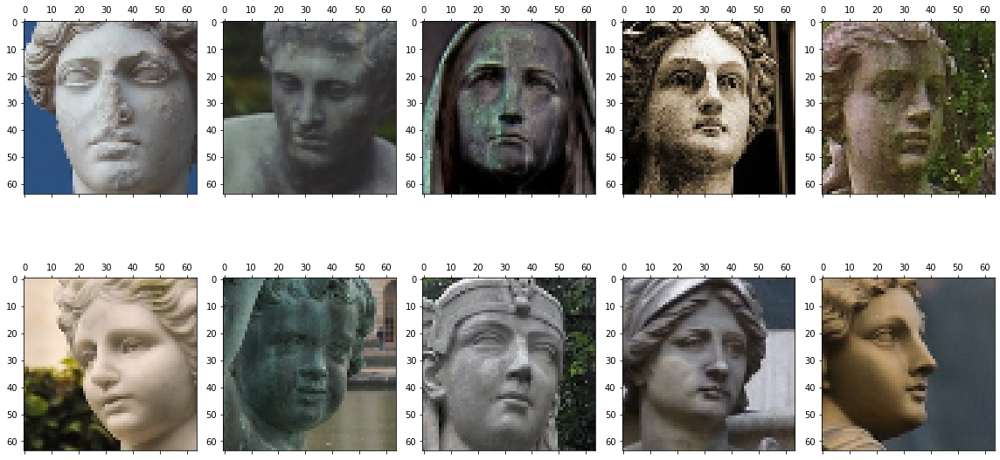

In [53]:
fig, axs = plt.subplots(2, 5, sharey=False, tight_layout=True, figsize=(16,9), facecolor='white')
n=0
for i in range(0,2):
    for j in range(0,5):
        axs[i,j].matshow(data_lowres[n])
        n=n+1
plt.show() 

Finally, let’s scale our image input data which currently has a range of [0,1], to a range of [-1,1]. We do this, so we can use the tanh activation function in the Generator output as it often produces better results.

However, using a sigmoid activation function in the Generator output is also common, which would not require you to rescale images further.

In [54]:
# Scaler
scaler=MinMaxScaler(feature_range=(-1, 1))

# Select images that we want to use for model trainng
data=data_lowres.copy()
print("Original shape of the data: ", data.shape)

# Reshape array
data=data.reshape(-1, 1)
print("Reshaped data: ", data.shape)

# Fit the scaler
scaler.fit(data)

# Scale the array
data=scaler.transform(data)

# Reshape back to the original shape
data=data.reshape(data_lowres.shape[0], 64, 64, 3)
print("Shape of the scaled array: ", data.shape)

Original shape of the data:  (1596, 64, 64, 3)
Reshaped data:  (19611648, 1)
Shape of the scaled array:  (1596, 64, 64, 3)


Creating a DCGAN model
With data preparation completed, let’s define and assemble our models. We will start with the Generator:

In [55]:
def generator(latent_dim):
    model = Sequential(name="Generator") # Model
    
    # Hidden Layer 1: Start with 8 x 8 image
    n_nodes = 8 * 8 * 128 # number of nodes in the first hidden layer
    model.add(Dense(n_nodes, input_dim=latent_dim, name='Generator-Hidden-Layer-1'))
    model.add(Reshape((8, 8, 128), name='Generator-Hidden-Layer-Reshape-1'))
    
    # Hidden Layer 2: Upsample to 16 x 16
    model.add(Conv2DTranspose(filters=128, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-2'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-2'))
                              
    # Hidden Layer 3: Upsample to 32 x 32
    model.add(Conv2DTranspose(filters=256, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-3'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-3'))
    
    # Hidden Layer 4: Upsample to 64 x 64
    model.add(Conv2DTranspose(filters=512, kernel_size=(4,4), strides=(2,2), padding='same', name='Generator-Hidden-Layer-4'))
    model.add(ReLU(name='Generator-Hidden-Layer-Activation-4'))
    
    # Output Layer (Note, we use 3 filters because we have 3 channels for a color image. Grayscale would have only 1 channel)
    model.add(Conv2D(filters=3, kernel_size=(5,5), activation='tanh', padding='same', name='Generator-Output-Layer'))
    return model

# Instantiate
latent_dim=100 # Our latent space has 100 dimensions. We can change it to any number
gen_model = generator(latent_dim)

# Show model summary and plot model diagram
gen_model.summary()
plot_model(gen_model, show_shapes=True, show_layer_names=True, dpi=400)

Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Generator-Hidden-Layer-1 (D  (None, 8192)             827392    
 ense)                                                           
                                                                 
 Generator-Hidden-Layer-Resh  (None, 8, 8, 128)        0         
 ape-1 (Reshape)                                                 
                                                                 
 Generator-Hidden-Layer-2 (C  (None, 16, 16, 128)      262272    
 onv2DTranspose)                                                 
                                                                 
 Generator-Hidden-Layer-Acti  (None, 16, 16, 128)      0         
 vation-2 (ReLU)                                                 
                                                                 
 Generator-Hidden-Layer-3 (C  (None, 32, 32, 256)      52

We start with a 100-node latent vector, which we connect to the 8192-node Dense layer before reshaping it to 8 x 8 x 128. Then we pass it through Transposed Convolutions to upsample the data to a 64 x 64 output.

Note that we also use regular Convolution in the output layer as we reduce filters from 512 to only 3, representing different colour channels.

Next, let’s define a Discriminator model:

In [56]:
def discriminator(in_shape=(64,64,3)):
    model = Sequential(name="Discriminator") # Model
    
    # Hidden Layer 1
    model.add(Conv2D(filters=64, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-1'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-1'))
    
    # Hidden Layer 2
    model.add(Conv2D(filters=128, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-2'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-2'))
    
    # Hidden Layer 3
    model.add(Conv2D(filters=128, kernel_size=(4,4), strides=(2, 2), padding='same', input_shape=in_shape, name='Discriminator-Hidden-Layer-3'))
    model.add(LeakyReLU(alpha=0.2, name='Discriminator-Hidden-Layer-Activation-3'))
    
    # Flatten and Output Layers
    model.add(Flatten(name='Discriminator-Flatten-Layer')) # Flatten the shape
    model.add(Dropout(0.3, name='Discriminator-Flatten-Layer-Dropout')) # Randomly drop some connections for better generalization
    model.add(Dense(1, activation='sigmoid', name='Discriminator-Output-Layer')) # Output Layer
    
    # Compile the model
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

# Instantiate
dis_model = discriminator()

# Show model summary and plot model diagram
dis_model.summary()
plot_model(dis_model, show_shapes=True, show_layer_names=True, dpi=400)

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Discriminator-Hidden-Layer-  (None, 32, 32, 64)       3136      
 1 (Conv2D)                                                      
                                                                 
 Discriminator-Hidden-Layer-  (None, 32, 32, 64)       0         
 Activation-1 (LeakyReLU)                                        
                                                                 
 Discriminator-Hidden-Layer-  (None, 16, 16, 128)      131200    
 2 (Conv2D)                                                      
                                                                 
 Discriminator-Hidden-Layer-  (None, 16, 16, 128)      0         
 Activation-2 (LeakyReLU)                                        
                                                                 
 Discriminator-Hidden-Layer-  (None, 8, 8, 128)      

If you compare it to the Generator model, you will notice that the Discriminator model does the opposite. I.e., it takes a 64 x 64 image and passes it through multiple Convolutional layers to reduce it to a binary classification output of real/fake.

Next, we combine the two models to create a DCGAN. One crucial detail in the code below is that we make the Discriminator model non-trainable. We do this because we want to train the Discriminator separately using a combination of real and fake (generated) data. You will see how we do that later.

In [57]:
def def_gan(generator, discriminator):
    
    # We don't want to train the weights of discriminator at this stage. Hence, make it not trainable
    discriminator.trainable = False
    
    # Combine
    model = Sequential(name="DCGAN") # GAN Model
    model.add(generator) # Add Generator
    model.add(discriminator) # Add Disriminator
    
    # Compile the model
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5))
    return model

# Instantiate
gan_model = def_gan(gen_model, dis_model)

# Show model summary and plot model diagram
gan_model.summary()
plot_model(gan_model, show_shapes=True, show_layer_names=True, dpi=400)

Model: "DCGAN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Generator (Sequential)      (None, 64, 64, 3)         3750275   
                                                                 
 Discriminator (Sequential)  (None, 1)                 404801    
                                                                 
Total params: 4,155,076
Trainable params: 3,750,275
Non-trainable params: 404,801
_________________________________________________________________
You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


## Preparing inputs for the Generator and the Discriminator

We will create three simple functions that will aid us in sampling / generating data for the two models.

The first one samples real images from the training data, the second draws random vectors from the latent space, and the third passes latent variables into a Generator model to generate fake examples.

In [58]:
def real_samples(n, dataset):
    
    # Samples of real data
    X = dataset[np.random.choice(dataset.shape[0], n, replace=True), :]

    # Class labels
    y = np.ones((n, 1))
    return X, y
    
    
def latent_vector(latent_dim, n):
    
    # Generate points in the latent space
    latent_input = np.random.randn(latent_dim * n)
    
    # Reshape into a batch of inputs for the network
    latent_input = latent_input.reshape(n, latent_dim)
    return latent_input
  
    
def fake_samples(generator, latent_dim, n):
    
    # Generate points in latent space
    latent_output = latent_vector(latent_dim, n)
    
    # Predict outputs (i.e., generate fake samples)
    X = generator.predict(latent_output)
    
    # Create class labels
    y = np.zeros((n, 1))
    return X, y    

## Model training and evaluation
The final two functions will help us train the models and evaluate results at specified intervals.


Let’s create the model performance evaluation function first:

In [59]:
def performance_summary(generator, discriminator, dataset, latent_dim, n=50):
    
    # Get samples of the real data
    x_real, y_real = real_samples(n, dataset)
    # Evaluate the descriminator on real data
    _, real_accuracy = discriminator.evaluate(x_real, y_real, verbose=0)
    
    # Get fake (generated) samples
    x_fake, y_fake = fake_samples(generator, latent_dim, n)
    # Evaluate the descriminator on fake (generated) data
    _, fake_accuracy = discriminator.evaluate(x_fake, y_fake, verbose=0)
    
    # summarize discriminator performance
    print("*** Evaluation ***")
    print("Discriminator Accuracy on REAL images: ", real_accuracy)
    print("Discriminator Accuracy on FAKE (generated) images: ", fake_accuracy)
    
    # Display 6 fake images
    x_fake_inv_trans=x_fake.reshape(-1, 1)
    x_fake_inv_trans=scaler.inverse_transform(x_fake_inv_trans)
    x_fake_inv_trans=x_fake_inv_trans.reshape(n, 64, 64, 3)
    
    fig, axs = plt.subplots(2, 3, sharey=False, tight_layout=True, figsize=(12,6), facecolor='white')
    k=0
    for i in range(0,2):
        for j in range(0,3):
            axs[i,j].matshow(x_fake_inv_trans[k])
            k=k+1
    plt.show() 

As you can see, the above function evaluates the Discriminator separately on real and fake (generated) points. Also, it shows a few model-generated images.

Note that to display fake (generated) images, we need to inverse transform the underlying data from the [-1,1] range to the [0,1] range.

Finally, the training function:

In [62]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=2000, n_batch=32, n_eval=100):
    
    # Our batch to train the discriminator will consist of half real images and half fake (generated) images
    half_batch = int(n_batch / 2)
    
    # We will manually enumare epochs 
    for i in range(n_epochs):
        print('Epoch %s/%s' % (str(i+1), str(n_epochs)))
    
    # Discriminator training
        # Prep real samples
        x_real, y_real = real_samples(half_batch, dataset)
        # Prep fake (generated) samples
        x_fake, y_fake = fake_samples(g_model, latent_dim, half_batch)
        
        # Train the discriminator using real and fake samples
        X, y = np.vstack((x_real, x_fake)), np.vstack((y_real, y_fake))
        discriminator_loss, _ = d_model.train_on_batch(X, y)
    
    # Generator training
        # Get values from the latent space to be used as inputs for the generator
        x_gan = latent_vector(latent_dim, n_batch)
        # While we are generating fake samples, 
        # we want GAN generator model to create examples that resemble the real ones,
        # hence we want to pass labels corresponding to real samples, i.e. y=1, not 0.
        y_gan = np.ones((n_batch, 1))
        
        # Train the generator via a composite GAN model
        generator_loss = gan_model.train_on_batch(x_gan, y_gan)
        
        # Evaluate the model at every n_eval epochs
        if (i) % n_eval == 0:
            print("Epoch number: ", i)
            print("*** Training ***")
            print("Discriminator Loss ", discriminator_loss)
            print("Generator Loss: ", generator_loss)
            performance_summary(g_model, d_model, dataset, latent_dim)

As mentioned earlier, we train the Discriminator separately by passing a batch with 50% real and 50% fake (generated) samples. Meanwhile, the Generator training happens via a combined DCGAN model.

### Results
Let’s call the training function to train the model and display some results.



Epoch 1/2000
1/1 [==============================] - 0s 475ms/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.9142313003540039
Generator Loss:  0.46629589796066284
2/2 [==============================] - 1s 520ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


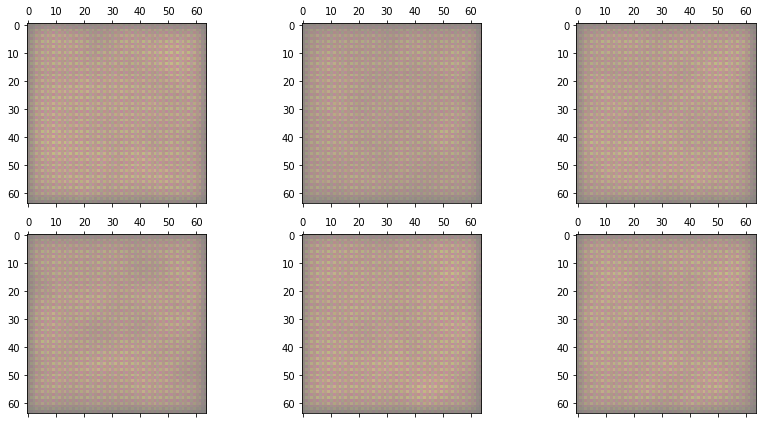

Epoch 2/2000
1/1 [==============================] - 0s 477ms/step
Epoch 3/2000
1/1 [==============================] - 0s 466ms/step
Epoch 4/2000
1/1 [==============================] - 0s 474ms/step
Epoch 5/2000
1/1 [==============================] - 0s 478ms/step
Epoch 6/2000
1/1 [==============================] - 0s 478ms/step
Epoch 7/2000
1/1 [==============================] - 0s 484ms/step
Epoch 8/2000
1/1 [==============================] - 0s 487ms/step
Epoch 9/2000
1/1 [==============================] - 0s 491ms/step
Epoch 10/2000
1/1 [==============================] - 0s 497ms/step
Epoch 11/2000
1/1 [==============================] - 1s 500ms/step
Epoch 12/2000
1/1 [==============================] - 1s 501ms/step
Epoch 13/2000
1/1 [==============================] - 0s 500ms/step
Epoch 14/2000
1/1 [==============================] - 1s 501ms/step
Epoch 15/2000
1/1 [==============================] - 1s 503ms/step
Epoch 16/2000
1/1 [==============================] - 1s 505ms/step
Epo

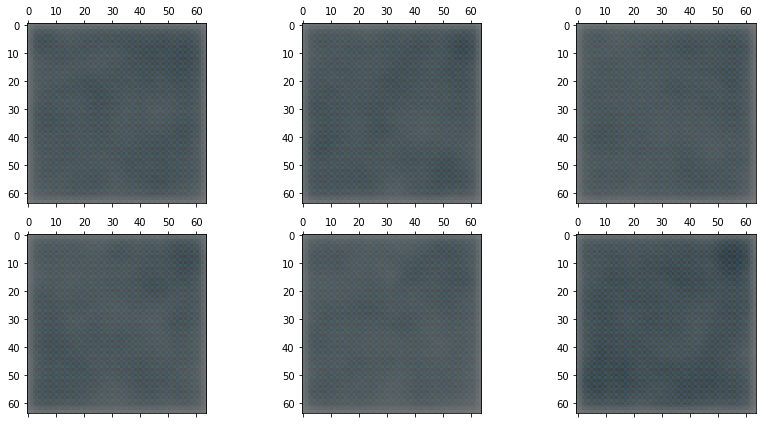

Epoch 22/2000
1/1 [==============================] - 1s 522ms/step
Epoch 23/2000
1/1 [==============================] - 1s 525ms/step
Epoch 24/2000
1/1 [==============================] - 1s 515ms/step
Epoch 25/2000
1/1 [==============================] - 1s 508ms/step
Epoch 26/2000
1/1 [==============================] - 1s 518ms/step
Epoch 27/2000
1/1 [==============================] - 1s 513ms/step
Epoch 28/2000
1/1 [==============================] - 1s 520ms/step
Epoch 29/2000
1/1 [==============================] - 1s 512ms/step
Epoch 30/2000
1/1 [==============================] - 1s 527ms/step
Epoch 31/2000
1/1 [==============================] - 1s 514ms/step
Epoch 32/2000
1/1 [==============================] - 1s 512ms/step
Epoch 33/2000
1/1 [==============================] - 1s 515ms/step
Epoch 34/2000
1/1 [==============================] - 1s 517ms/step
Epoch 35/2000
1/1 [==============================] - 1s 532ms/step
Epoch 36/2000
1/1 [==============================] - 1s 549ms/

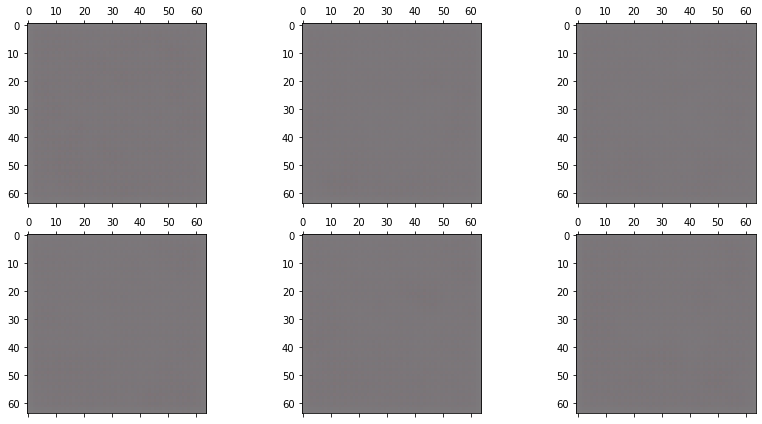

Epoch 42/2000
1/1 [==============================] - 1s 520ms/step
Epoch 43/2000
1/1 [==============================] - 0s 492ms/step
Epoch 44/2000
1/1 [==============================] - 0s 440ms/step
Epoch 45/2000
1/1 [==============================] - 1s 506ms/step
Epoch 46/2000
1/1 [==============================] - 0s 447ms/step
Epoch 47/2000
1/1 [==============================] - 0s 478ms/step
Epoch 48/2000
1/1 [==============================] - 0s 453ms/step
Epoch 49/2000
1/1 [==============================] - 0s 448ms/step
Epoch 50/2000
1/1 [==============================] - 0s 467ms/step
Epoch 51/2000
1/1 [==============================] - 0s 496ms/step
Epoch 52/2000
1/1 [==============================] - 0s 486ms/step
Epoch 53/2000
1/1 [==============================] - 0s 445ms/step
Epoch 54/2000
1/1 [==============================] - 0s 456ms/step
Epoch 55/2000
1/1 [==============================] - 0s 453ms/step
Epoch 56/2000
1/1 [==============================] - 0s 465ms/

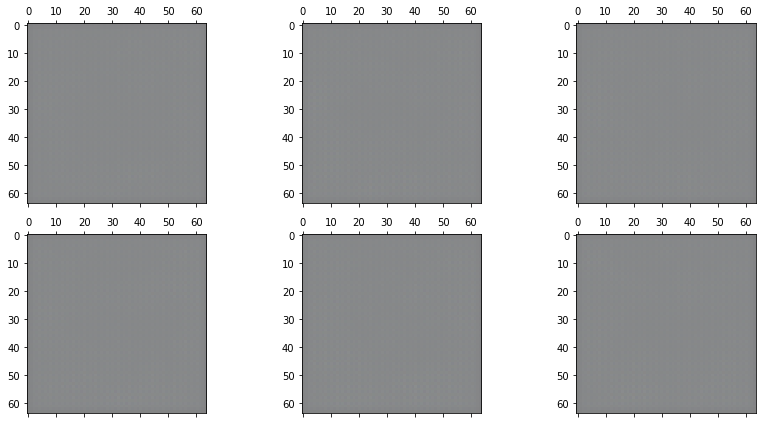

Epoch 62/2000
1/1 [==============================] - 0s 487ms/step
Epoch 63/2000
1/1 [==============================] - 0s 476ms/step
Epoch 64/2000
1/1 [==============================] - 0s 490ms/step
Epoch 65/2000
1/1 [==============================] - 0s 483ms/step
Epoch 66/2000
1/1 [==============================] - 1s 534ms/step
Epoch 67/2000
1/1 [==============================] - 0s 484ms/step
Epoch 68/2000
1/1 [==============================] - 0s 489ms/step
Epoch 69/2000
1/1 [==============================] - 0s 490ms/step
Epoch 70/2000
1/1 [==============================] - 0s 496ms/step
Epoch 71/2000
1/1 [==============================] - 0s 496ms/step
Epoch 72/2000
1/1 [==============================] - 0s 498ms/step
Epoch 73/2000
1/1 [==============================] - 0s 496ms/step
Epoch 74/2000
1/1 [==============================] - 1s 504ms/step
Epoch 75/2000
1/1 [==============================] - 1s 503ms/step
Epoch 76/2000
1/1 [==============================] - 0s 499ms/

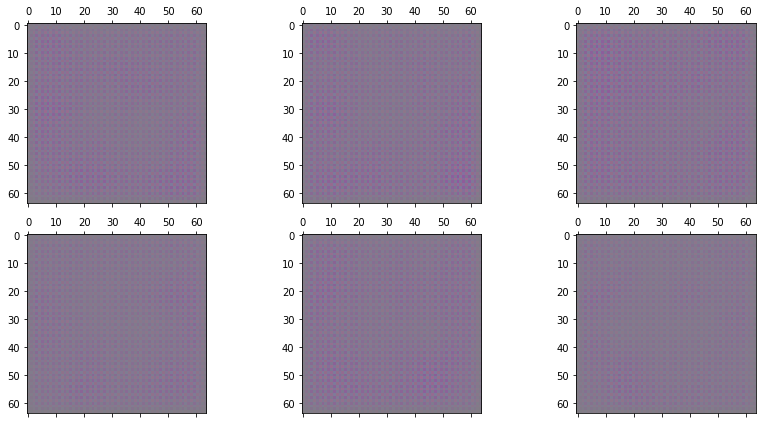

Epoch 82/2000
1/1 [==============================] - 1s 513ms/step
Epoch 83/2000
1/1 [==============================] - 1s 530ms/step
Epoch 84/2000
1/1 [==============================] - 1s 508ms/step
Epoch 85/2000
1/1 [==============================] - 1s 517ms/step
Epoch 86/2000
1/1 [==============================] - 1s 508ms/step
Epoch 87/2000
1/1 [==============================] - 1s 511ms/step
Epoch 88/2000
1/1 [==============================] - 1s 518ms/step
Epoch 89/2000
1/1 [==============================] - 1s 507ms/step
Epoch 90/2000
1/1 [==============================] - 0s 476ms/step
Epoch 91/2000
1/1 [==============================] - 0s 460ms/step
Epoch 92/2000
1/1 [==============================] - 0s 446ms/step
Epoch 93/2000
1/1 [==============================] - 0s 447ms/step
Epoch 94/2000
1/1 [==============================] - 0s 443ms/step
Epoch 95/2000
1/1 [==============================] - 0s 447ms/step
Epoch 96/2000
1/1 [==============================] - 0s 451ms/

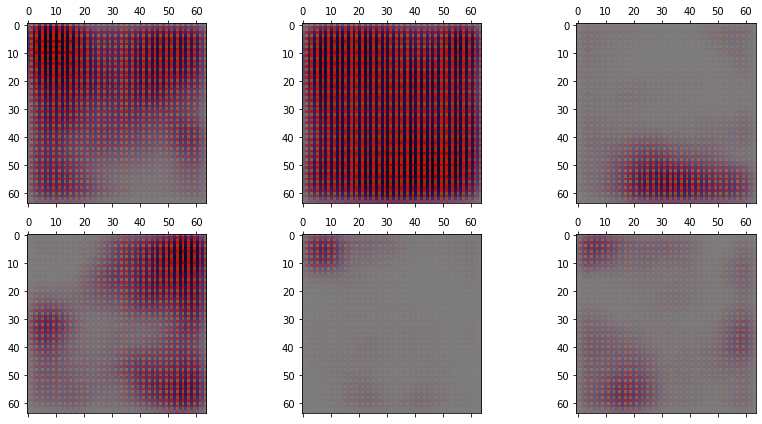

Epoch 102/2000
1/1 [==============================] - 0s 476ms/step
Epoch 103/2000
1/1 [==============================] - 0s 460ms/step
Epoch 104/2000
1/1 [==============================] - 0s 464ms/step
Epoch 105/2000
1/1 [==============================] - 0s 469ms/step
Epoch 106/2000
1/1 [==============================] - 0s 470ms/step
Epoch 107/2000
1/1 [==============================] - 0s 481ms/step
Epoch 108/2000
1/1 [==============================] - 0s 478ms/step
Epoch 109/2000
1/1 [==============================] - 0s 486ms/step
Epoch 110/2000
1/1 [==============================] - 0s 491ms/step
Epoch 111/2000
1/1 [==============================] - 0s 485ms/step
Epoch 112/2000
1/1 [==============================] - 0s 487ms/step
Epoch 113/2000
1/1 [==============================] - 0s 493ms/step
Epoch 114/2000
1/1 [==============================] - 0s 490ms/step
Epoch 115/2000
1/1 [==============================] - 0s 491ms/step
Epoch 116/2000
1/1 [============================

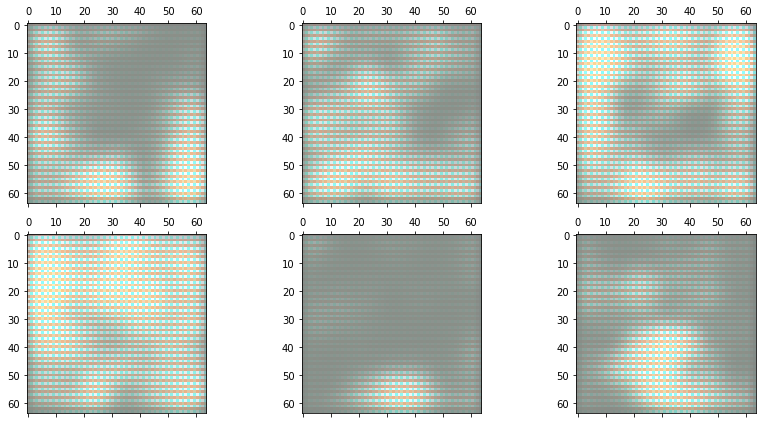

Epoch 122/2000
1/1 [==============================] - 1s 520ms/step
Epoch 123/2000
1/1 [==============================] - 1s 508ms/step
Epoch 124/2000
1/1 [==============================] - 1s 515ms/step
Epoch 125/2000
1/1 [==============================] - 1s 503ms/step
Epoch 126/2000
1/1 [==============================] - 1s 624ms/step
Epoch 127/2000
1/1 [==============================] - 1s 511ms/step
Epoch 128/2000
1/1 [==============================] - 0s 455ms/step
Epoch 129/2000
1/1 [==============================] - 0s 458ms/step
Epoch 130/2000
1/1 [==============================] - 0s 496ms/step
Epoch 131/2000
1/1 [==============================] - 0s 456ms/step
Epoch 132/2000
1/1 [==============================] - 0s 456ms/step
Epoch 133/2000
1/1 [==============================] - 1s 504ms/step
Epoch 134/2000
1/1 [==============================] - 0s 472ms/step
Epoch 135/2000
1/1 [==============================] - 0s 468ms/step
Epoch 136/2000
1/1 [============================

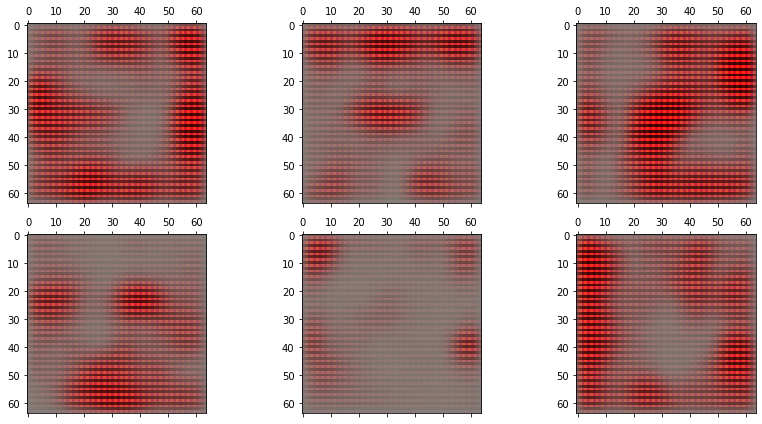

Epoch 142/2000
1/1 [==============================] - 0s 488ms/step
Epoch 143/2000
1/1 [==============================] - 1s 535ms/step
Epoch 144/2000
1/1 [==============================] - 1s 538ms/step
Epoch 145/2000
1/1 [==============================] - 1s 522ms/step
Epoch 146/2000
1/1 [==============================] - 1s 553ms/step
Epoch 147/2000
1/1 [==============================] - 1s 539ms/step
Epoch 148/2000
1/1 [==============================] - 1s 533ms/step
Epoch 149/2000
1/1 [==============================] - 1s 559ms/step
Epoch 150/2000
1/1 [==============================] - 1s 539ms/step
Epoch 151/2000
1/1 [==============================] - 1s 522ms/step
Epoch 152/2000
1/1 [==============================] - 0s 500ms/step
Epoch 153/2000
1/1 [==============================] - 1s 532ms/step
Epoch 154/2000
1/1 [==============================] - 1s 527ms/step
Epoch 155/2000
1/1 [==============================] - 1s 537ms/step
Epoch 156/2000
1/1 [============================

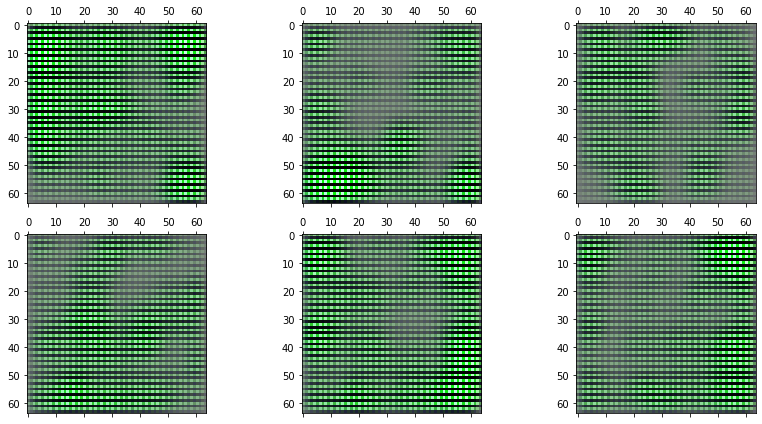

Epoch 162/2000
1/1 [==============================] - 1s 561ms/step
Epoch 163/2000
1/1 [==============================] - 1s 584ms/step
Epoch 164/2000
1/1 [==============================] - 1s 522ms/step
Epoch 165/2000
1/1 [==============================] - 1s 530ms/step
Epoch 166/2000
1/1 [==============================] - 1s 555ms/step
Epoch 167/2000
1/1 [==============================] - 1s 519ms/step
Epoch 168/2000
1/1 [==============================] - 1s 522ms/step
Epoch 169/2000
1/1 [==============================] - 1s 519ms/step
Epoch 170/2000
1/1 [==============================] - 1s 533ms/step
Epoch 171/2000
1/1 [==============================] - 1s 515ms/step
Epoch 172/2000
1/1 [==============================] - 1s 517ms/step
Epoch 173/2000
1/1 [==============================] - 1s 529ms/step
Epoch 174/2000
1/1 [==============================] - 1s 518ms/step
Epoch 175/2000
1/1 [==============================] - 1s 522ms/step
Epoch 176/2000
1/1 [============================

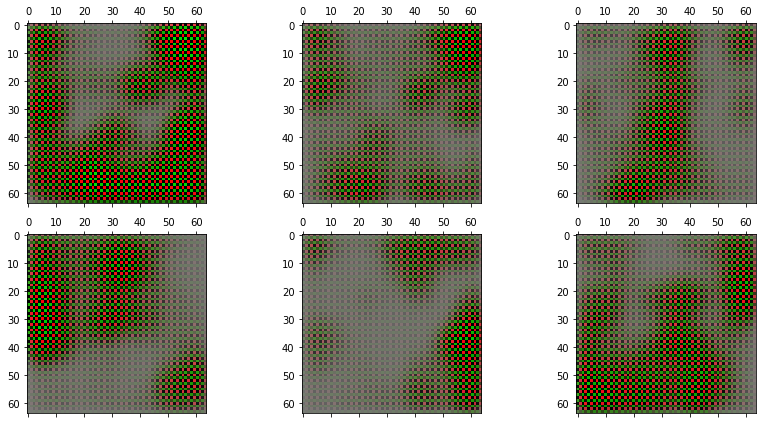

Epoch 182/2000
1/1 [==============================] - 1s 533ms/step
Epoch 183/2000
1/1 [==============================] - 1s 531ms/step
Epoch 184/2000
1/1 [==============================] - 1s 533ms/step
Epoch 185/2000
1/1 [==============================] - 1s 527ms/step
Epoch 186/2000
1/1 [==============================] - 1s 528ms/step
Epoch 187/2000
1/1 [==============================] - 1s 530ms/step
Epoch 188/2000
1/1 [==============================] - 1s 534ms/step
Epoch 189/2000
1/1 [==============================] - 1s 523ms/step
Epoch 190/2000
1/1 [==============================] - 1s 542ms/step
Epoch 191/2000
1/1 [==============================] - 1s 539ms/step
Epoch 192/2000
1/1 [==============================] - 1s 521ms/step
Epoch 193/2000
1/1 [==============================] - 1s 527ms/step
Epoch 194/2000
1/1 [==============================] - 1s 539ms/step
Epoch 195/2000
1/1 [==============================] - 1s 524ms/step
Epoch 196/2000
1/1 [============================

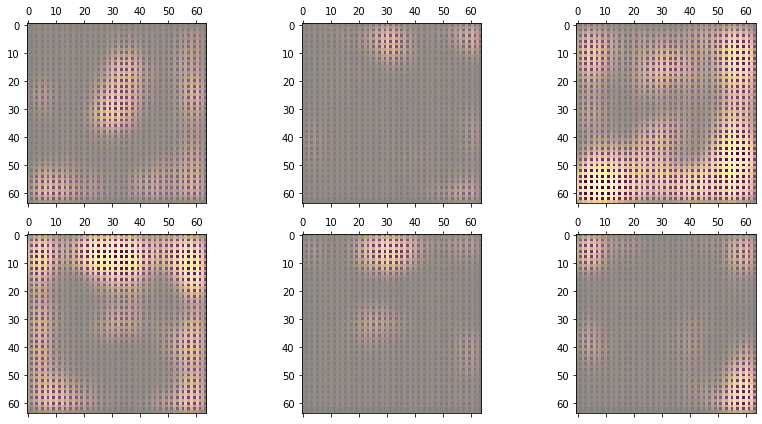

Epoch 202/2000
1/1 [==============================] - 0s 462ms/step
Epoch 203/2000
1/1 [==============================] - 0s 446ms/step
Epoch 204/2000
1/1 [==============================] - 0s 449ms/step
Epoch 205/2000
1/1 [==============================] - 0s 448ms/step
Epoch 206/2000
1/1 [==============================] - 0s 448ms/step
Epoch 207/2000
1/1 [==============================] - 0s 444ms/step
Epoch 208/2000
1/1 [==============================] - 0s 444ms/step
Epoch 209/2000
1/1 [==============================] - 0s 451ms/step
Epoch 210/2000
1/1 [==============================] - 0s 446ms/step
Epoch 211/2000
1/1 [==============================] - 0s 456ms/step
Epoch 212/2000
1/1 [==============================] - 0s 458ms/step
Epoch 213/2000
1/1 [==============================] - 0s 476ms/step
Epoch 214/2000
1/1 [==============================] - 0s 470ms/step
Epoch 215/2000
1/1 [==============================] - 1s 501ms/step
Epoch 216/2000
1/1 [============================

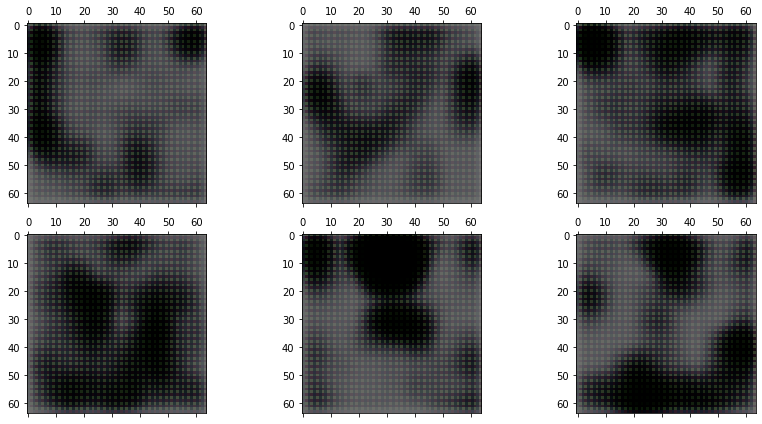

Epoch 222/2000
1/1 [==============================] - 1s 500ms/step
Epoch 223/2000
1/1 [==============================] - 1s 501ms/step
Epoch 224/2000
1/1 [==============================] - 0s 489ms/step
Epoch 225/2000
1/1 [==============================] - 0s 492ms/step
Epoch 226/2000
1/1 [==============================] - 0s 499ms/step
Epoch 227/2000
1/1 [==============================] - 0s 492ms/step
Epoch 228/2000
1/1 [==============================] - 0s 491ms/step
Epoch 229/2000
1/1 [==============================] - 1s 511ms/step
Epoch 230/2000
1/1 [==============================] - 1s 501ms/step
Epoch 231/2000
1/1 [==============================] - 0s 495ms/step
Epoch 232/2000
1/1 [==============================] - 0s 498ms/step
Epoch 233/2000
1/1 [==============================] - 1s 508ms/step
Epoch 234/2000
1/1 [==============================] - 1s 509ms/step
Epoch 235/2000
1/1 [==============================] - 1s 502ms/step
Epoch 236/2000
1/1 [============================

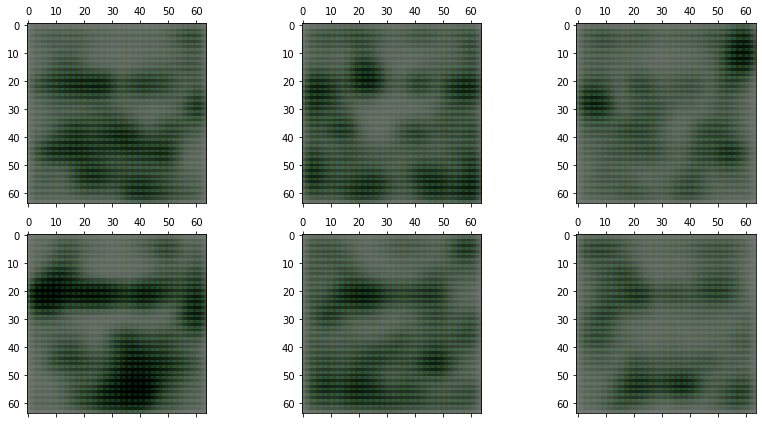

Epoch 242/2000
1/1 [==============================] - 1s 532ms/step
Epoch 243/2000
1/1 [==============================] - 1s 513ms/step
Epoch 244/2000
1/1 [==============================] - 1s 520ms/step
Epoch 245/2000
1/1 [==============================] - 1s 517ms/step
Epoch 246/2000
1/1 [==============================] - 1s 524ms/step
Epoch 247/2000
1/1 [==============================] - 1s 520ms/step
Epoch 248/2000
1/1 [==============================] - 1s 511ms/step
Epoch 249/2000
1/1 [==============================] - 1s 525ms/step
Epoch 250/2000
1/1 [==============================] - 1s 521ms/step
Epoch 251/2000
1/1 [==============================] - 1s 506ms/step
Epoch 252/2000
1/1 [==============================] - 1s 513ms/step
Epoch 253/2000
1/1 [==============================] - 1s 519ms/step
Epoch 254/2000
1/1 [==============================] - 1s 525ms/step
Epoch 255/2000
1/1 [==============================] - 1s 513ms/step
Epoch 256/2000
1/1 [============================

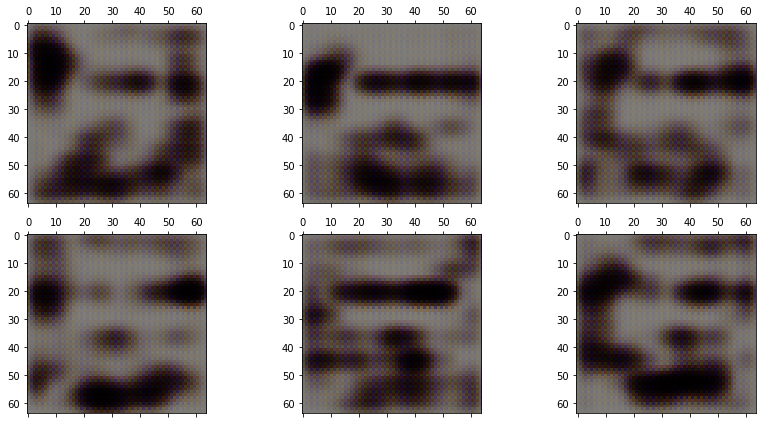

Epoch 262/2000
1/1 [==============================] - 1s 522ms/step
Epoch 263/2000
1/1 [==============================] - 1s 527ms/step
Epoch 264/2000
1/1 [==============================] - 1s 529ms/step
Epoch 265/2000
1/1 [==============================] - 1s 520ms/step
Epoch 266/2000
1/1 [==============================] - 1s 543ms/step
Epoch 267/2000
1/1 [==============================] - 1s 521ms/step
Epoch 268/2000
1/1 [==============================] - 1s 530ms/step
Epoch 269/2000
1/1 [==============================] - 1s 519ms/step
Epoch 270/2000
1/1 [==============================] - 1s 597ms/step
Epoch 271/2000
1/1 [==============================] - 1s 523ms/step
Epoch 272/2000
1/1 [==============================] - 1s 501ms/step
Epoch 273/2000
1/1 [==============================] - 0s 482ms/step
Epoch 274/2000
1/1 [==============================] - 1s 502ms/step
Epoch 275/2000
1/1 [==============================] - 1s 528ms/step
Epoch 276/2000
1/1 [============================

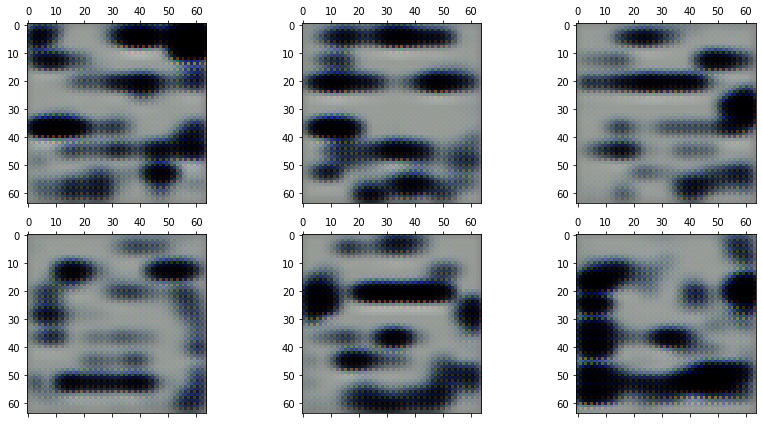

Epoch 282/2000
1/1 [==============================] - 1s 521ms/step
Epoch 283/2000
1/1 [==============================] - 0s 469ms/step
Epoch 284/2000
1/1 [==============================] - 0s 470ms/step
Epoch 285/2000
1/1 [==============================] - 0s 483ms/step
Epoch 286/2000
1/1 [==============================] - 0s 498ms/step
Epoch 287/2000
1/1 [==============================] - 0s 495ms/step
Epoch 288/2000
1/1 [==============================] - 0s 490ms/step
Epoch 289/2000
1/1 [==============================] - 1s 512ms/step
Epoch 290/2000
1/1 [==============================] - 0s 474ms/step
Epoch 291/2000
1/1 [==============================] - 0s 475ms/step
Epoch 292/2000
1/1 [==============================] - 1s 617ms/step
Epoch 293/2000
1/1 [==============================] - 1s 502ms/step
Epoch 294/2000
1/1 [==============================] - 0s 494ms/step
Epoch 295/2000
1/1 [==============================] - 1s 524ms/step
Epoch 296/2000
1/1 [============================

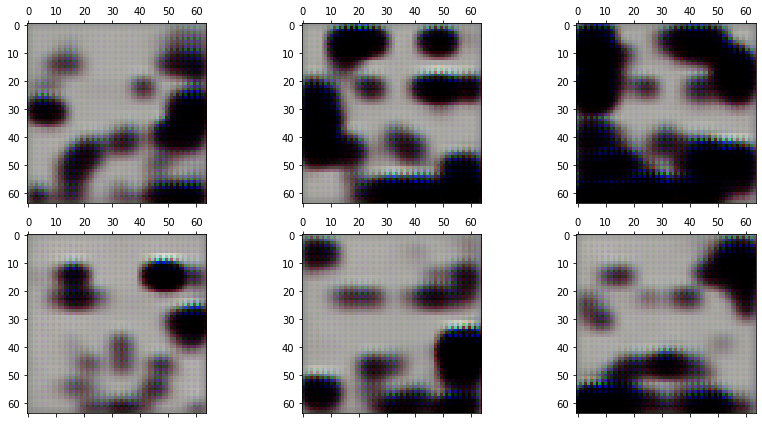

Epoch 302/2000
1/1 [==============================] - 1s 516ms/step
Epoch 303/2000
1/1 [==============================] - 1s 567ms/step
Epoch 304/2000
1/1 [==============================] - 1s 549ms/step
Epoch 305/2000
1/1 [==============================] - 1s 574ms/step
Epoch 306/2000
1/1 [==============================] - 1s 617ms/step
Epoch 307/2000
1/1 [==============================] - 1s 586ms/step
Epoch 308/2000
1/1 [==============================] - 1s 547ms/step
Epoch 309/2000
1/1 [==============================] - 1s 525ms/step
Epoch 310/2000
1/1 [==============================] - 1s 521ms/step
Epoch 311/2000
1/1 [==============================] - 1s 567ms/step
Epoch 312/2000
1/1 [==============================] - 1s 513ms/step
Epoch 313/2000
1/1 [==============================] - 1s 504ms/step
Epoch 314/2000
1/1 [==============================] - 1s 517ms/step
Epoch 315/2000
1/1 [==============================] - 1s 509ms/step
Epoch 316/2000
1/1 [============================

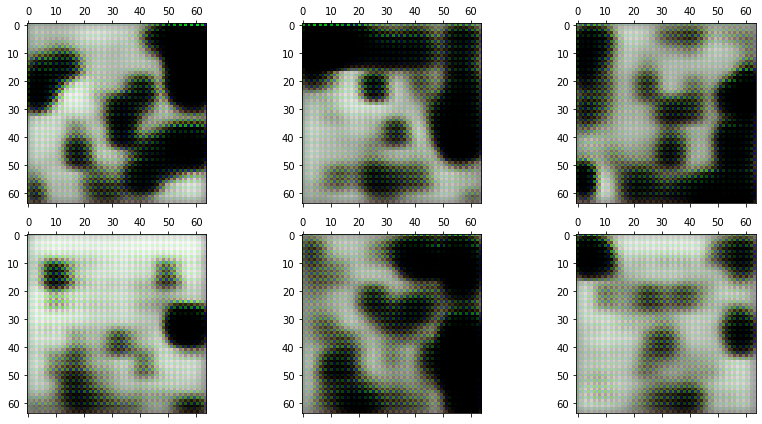

Epoch 322/2000
1/1 [==============================] - 1s 542ms/step
Epoch 323/2000
1/1 [==============================] - 1s 567ms/step
Epoch 324/2000
1/1 [==============================] - 1s 552ms/step
Epoch 325/2000
1/1 [==============================] - 1s 550ms/step
Epoch 326/2000
1/1 [==============================] - 1s 608ms/step
Epoch 327/2000
1/1 [==============================] - 1s 558ms/step
Epoch 328/2000
1/1 [==============================] - 1s 583ms/step
Epoch 329/2000
1/1 [==============================] - 1s 527ms/step
Epoch 330/2000
1/1 [==============================] - 1s 597ms/step
Epoch 331/2000
1/1 [==============================] - 1s 574ms/step
Epoch 332/2000
1/1 [==============================] - 1s 563ms/step
Epoch 333/2000
1/1 [==============================] - 1s 597ms/step
Epoch 334/2000
1/1 [==============================] - 1s 554ms/step
Epoch 335/2000
1/1 [==============================] - 1s 554ms/step
Epoch 336/2000
1/1 [============================

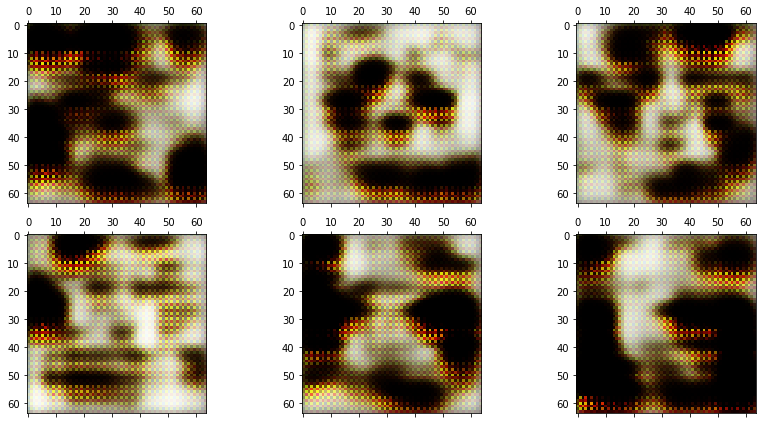

Epoch 342/2000
1/1 [==============================] - 1s 547ms/step
Epoch 343/2000
1/1 [==============================] - 1s 512ms/step
Epoch 344/2000
1/1 [==============================] - 1s 558ms/step
Epoch 345/2000
1/1 [==============================] - 1s 549ms/step
Epoch 346/2000
1/1 [==============================] - 1s 520ms/step
Epoch 347/2000
1/1 [==============================] - 1s 535ms/step
Epoch 348/2000
1/1 [==============================] - 1s 517ms/step
Epoch 349/2000
1/1 [==============================] - 1s 515ms/step
Epoch 350/2000
1/1 [==============================] - 1s 512ms/step
Epoch 351/2000
1/1 [==============================] - 1s 513ms/step
Epoch 352/2000
1/1 [==============================] - 1s 511ms/step
Epoch 353/2000
1/1 [==============================] - 1s 510ms/step
Epoch 354/2000
1/1 [==============================] - 1s 518ms/step
Epoch 355/2000
1/1 [==============================] - 1s 517ms/step
Epoch 356/2000
1/1 [============================

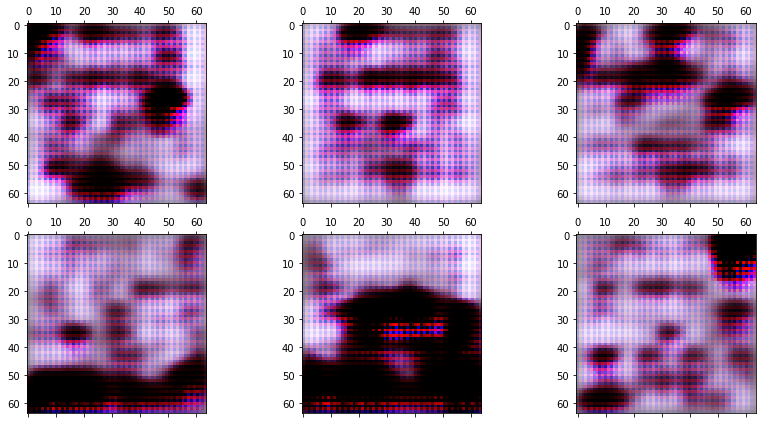

Epoch 362/2000
1/1 [==============================] - 1s 514ms/step
Epoch 363/2000
1/1 [==============================] - 1s 514ms/step
Epoch 364/2000
1/1 [==============================] - 1s 516ms/step
Epoch 365/2000
1/1 [==============================] - 1s 509ms/step
Epoch 366/2000
1/1 [==============================] - 1s 521ms/step
Epoch 367/2000
1/1 [==============================] - 1s 514ms/step
Epoch 368/2000
1/1 [==============================] - 1s 513ms/step
Epoch 369/2000
1/1 [==============================] - 1s 513ms/step
Epoch 370/2000
1/1 [==============================] - 1s 527ms/step
Epoch 371/2000
1/1 [==============================] - 1s 515ms/step
Epoch 372/2000
1/1 [==============================] - 1s 520ms/step
Epoch 373/2000
1/1 [==============================] - 1s 508ms/step
Epoch 374/2000
1/1 [==============================] - 1s 511ms/step
Epoch 375/2000
1/1 [==============================] - 1s 518ms/step
Epoch 376/2000
1/1 [============================

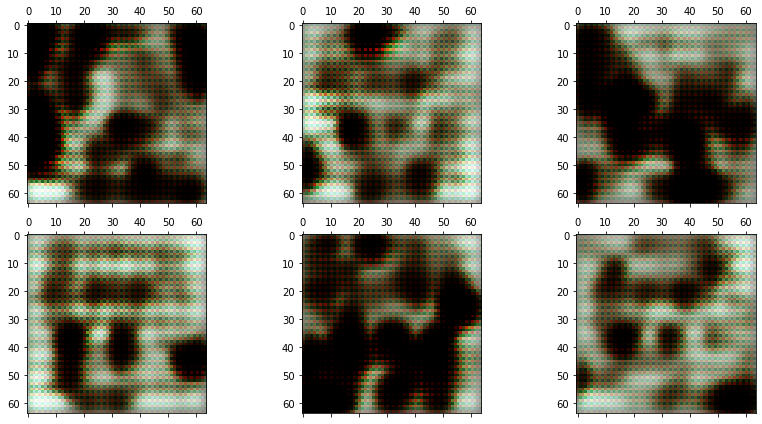

Epoch 382/2000
1/1 [==============================] - 1s 576ms/step
Epoch 383/2000
1/1 [==============================] - 1s 540ms/step
Epoch 384/2000
1/1 [==============================] - 1s 638ms/step
Epoch 385/2000
1/1 [==============================] - 1s 632ms/step
Epoch 386/2000
1/1 [==============================] - 1s 520ms/step
Epoch 387/2000
1/1 [==============================] - 1s 513ms/step
Epoch 388/2000
1/1 [==============================] - 1s 575ms/step
Epoch 389/2000
1/1 [==============================] - 1s 517ms/step
Epoch 390/2000
1/1 [==============================] - 1s 519ms/step
Epoch 391/2000
1/1 [==============================] - 1s 513ms/step
Epoch 392/2000
1/1 [==============================] - 1s 530ms/step
Epoch 393/2000
1/1 [==============================] - 1s 518ms/step
Epoch 394/2000
1/1 [==============================] - 1s 525ms/step
Epoch 395/2000
1/1 [==============================] - 1s 519ms/step
Epoch 396/2000
1/1 [============================

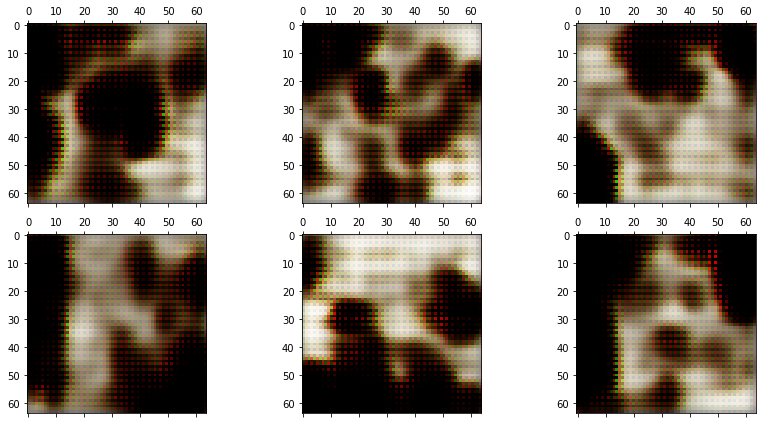

Epoch 402/2000
1/1 [==============================] - 1s 563ms/step
Epoch 403/2000
1/1 [==============================] - 1s 512ms/step
Epoch 404/2000
1/1 [==============================] - 1s 513ms/step
Epoch 405/2000
1/1 [==============================] - 1s 516ms/step
Epoch 406/2000
1/1 [==============================] - 1s 516ms/step
Epoch 407/2000
1/1 [==============================] - 1s 527ms/step
Epoch 408/2000
1/1 [==============================] - 1s 526ms/step
Epoch 409/2000
1/1 [==============================] - 1s 553ms/step
Epoch 410/2000
1/1 [==============================] - 1s 523ms/step
Epoch 411/2000
1/1 [==============================] - 1s 532ms/step
Epoch 412/2000
1/1 [==============================] - 1s 537ms/step
Epoch 413/2000
1/1 [==============================] - 1s 532ms/step
Epoch 414/2000
1/1 [==============================] - 1s 528ms/step
Epoch 415/2000
1/1 [==============================] - 1s 515ms/step
Epoch 416/2000
1/1 [============================

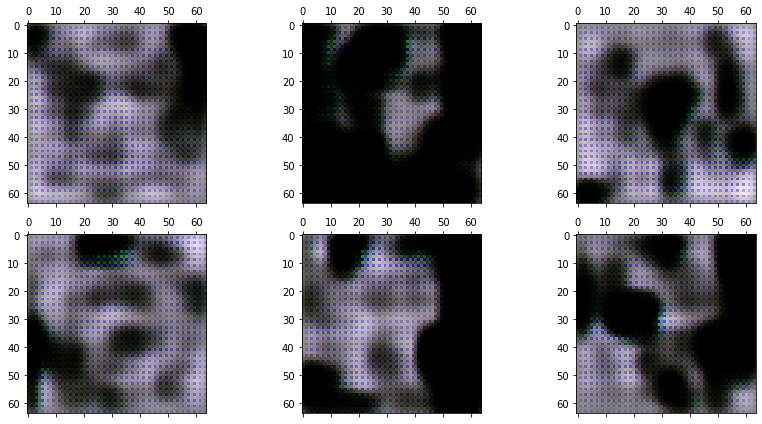

Epoch 422/2000
1/1 [==============================] - 1s 531ms/step
Epoch 423/2000
1/1 [==============================] - 1s 514ms/step
Epoch 424/2000
1/1 [==============================] - 1s 529ms/step
Epoch 425/2000
1/1 [==============================] - 1s 529ms/step
Epoch 426/2000
1/1 [==============================] - 1s 518ms/step
Epoch 427/2000
1/1 [==============================] - 1s 526ms/step
Epoch 428/2000
1/1 [==============================] - 1s 524ms/step
Epoch 429/2000
1/1 [==============================] - 1s 521ms/step
Epoch 430/2000
1/1 [==============================] - 1s 525ms/step
Epoch 431/2000
1/1 [==============================] - 1s 517ms/step
Epoch 432/2000
1/1 [==============================] - 1s 529ms/step
Epoch 433/2000
1/1 [==============================] - 1s 536ms/step
Epoch 434/2000
1/1 [==============================] - 1s 519ms/step
Epoch 435/2000
1/1 [==============================] - 1s 525ms/step
Epoch 436/2000
1/1 [============================

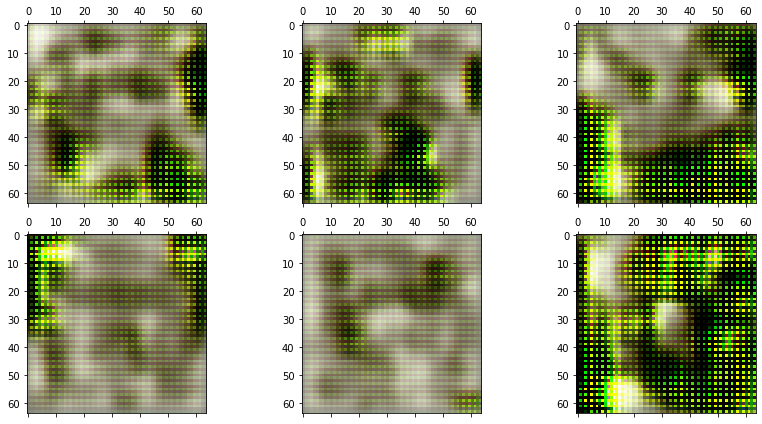

Epoch 442/2000
1/1 [==============================] - 1s 533ms/step
Epoch 443/2000
1/1 [==============================] - 1s 528ms/step
Epoch 444/2000
1/1 [==============================] - 1s 520ms/step
Epoch 445/2000
1/1 [==============================] - 1s 538ms/step
Epoch 446/2000
1/1 [==============================] - 1s 532ms/step
Epoch 447/2000
1/1 [==============================] - 1s 557ms/step
Epoch 448/2000
1/1 [==============================] - 1s 520ms/step
Epoch 449/2000
1/1 [==============================] - 1s 524ms/step
Epoch 450/2000
1/1 [==============================] - 1s 538ms/step
Epoch 451/2000
1/1 [==============================] - 1s 531ms/step
Epoch 452/2000
1/1 [==============================] - 1s 550ms/step
Epoch 453/2000
1/1 [==============================] - 1s 518ms/step
Epoch 454/2000
1/1 [==============================] - 1s 538ms/step
Epoch 455/2000
1/1 [==============================] - 1s 524ms/step
Epoch 456/2000
1/1 [============================

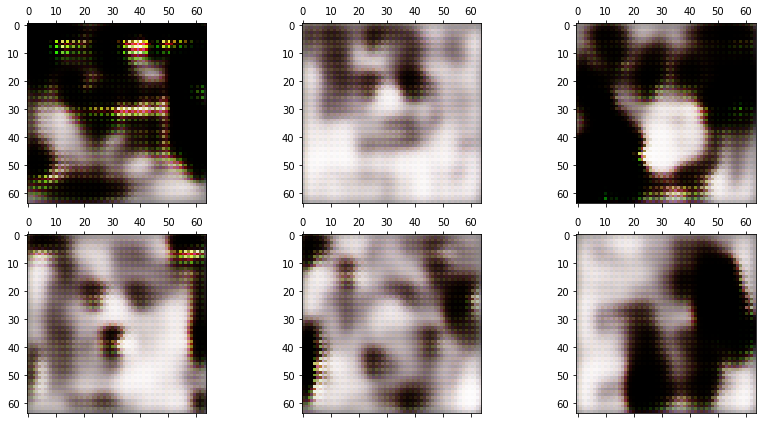

Epoch 462/2000
1/1 [==============================] - 1s 570ms/step
Epoch 463/2000
1/1 [==============================] - 1s 641ms/step
Epoch 464/2000
1/1 [==============================] - 1s 629ms/step
Epoch 465/2000
1/1 [==============================] - 1s 623ms/step
Epoch 466/2000
1/1 [==============================] - 1s 620ms/step
Epoch 467/2000
1/1 [==============================] - 1s 593ms/step
Epoch 468/2000
1/1 [==============================] - 1s 589ms/step
Epoch 469/2000
1/1 [==============================] - 1s 580ms/step
Epoch 470/2000
1/1 [==============================] - 1s 588ms/step
Epoch 471/2000
1/1 [==============================] - 1s 571ms/step
Epoch 472/2000
1/1 [==============================] - 1s 618ms/step
Epoch 473/2000
1/1 [==============================] - 1s 765ms/step
Epoch 474/2000
1/1 [==============================] - 1s 639ms/step
Epoch 475/2000
1/1 [==============================] - 1s 630ms/step
Epoch 476/2000
1/1 [============================

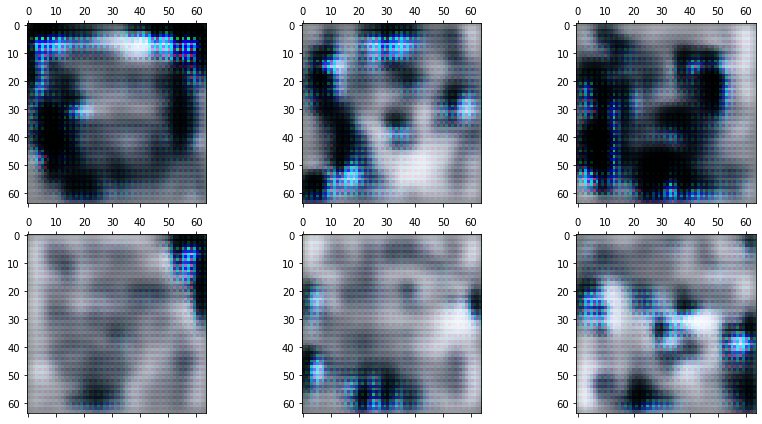

Epoch 482/2000
1/1 [==============================] - 1s 621ms/step
Epoch 483/2000
1/1 [==============================] - 1s 583ms/step
Epoch 484/2000
1/1 [==============================] - 1s 580ms/step
Epoch 485/2000
1/1 [==============================] - 1s 577ms/step
Epoch 486/2000
1/1 [==============================] - 1s 566ms/step
Epoch 487/2000
1/1 [==============================] - 1s 570ms/step
Epoch 488/2000
1/1 [==============================] - 1s 568ms/step
Epoch 489/2000
1/1 [==============================] - 1s 574ms/step
Epoch 490/2000
1/1 [==============================] - 1s 569ms/step
Epoch 491/2000
1/1 [==============================] - 1s 570ms/step
Epoch 492/2000
1/1 [==============================] - 1s 593ms/step
Epoch 493/2000
1/1 [==============================] - 1s 628ms/step
Epoch 494/2000
1/1 [==============================] - 1s 597ms/step
Epoch 495/2000
1/1 [==============================] - 1s 596ms/step
Epoch 496/2000
1/1 [============================

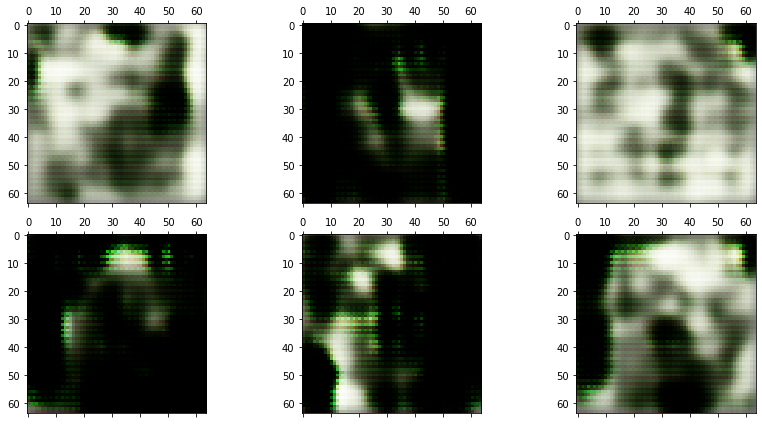

Epoch 502/2000
1/1 [==============================] - 1s 549ms/step
Epoch 503/2000
1/1 [==============================] - 1s 553ms/step
Epoch 504/2000
1/1 [==============================] - 1s 549ms/step
Epoch 505/2000
1/1 [==============================] - 1s 545ms/step
Epoch 506/2000
1/1 [==============================] - 1s 558ms/step
Epoch 507/2000
1/1 [==============================] - 1s 558ms/step
Epoch 508/2000
1/1 [==============================] - 1s 565ms/step
Epoch 509/2000
1/1 [==============================] - 1s 561ms/step
Epoch 510/2000
1/1 [==============================] - 1s 565ms/step
Epoch 511/2000
1/1 [==============================] - 1s 568ms/step
Epoch 512/2000
1/1 [==============================] - 1s 555ms/step
Epoch 513/2000
1/1 [==============================] - 1s 559ms/step
Epoch 514/2000
1/1 [==============================] - 1s 558ms/step
Epoch 515/2000
1/1 [==============================] - 1s 556ms/step
Epoch 516/2000
1/1 [============================

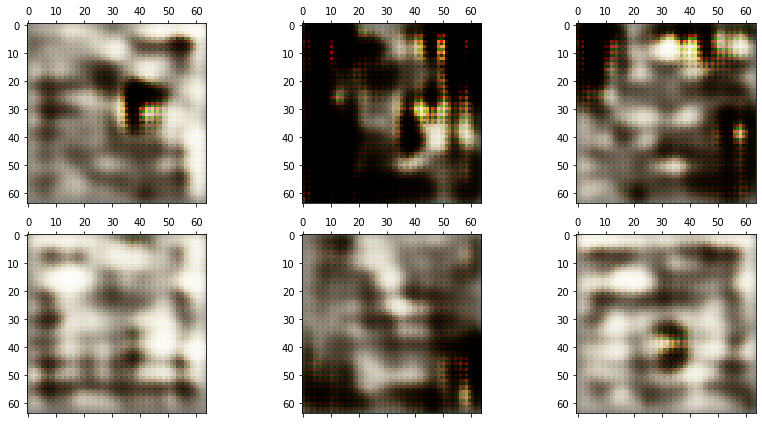

Epoch 522/2000
1/1 [==============================] - 1s 556ms/step
Epoch 523/2000
1/1 [==============================] - 1s 551ms/step
Epoch 524/2000
1/1 [==============================] - 1s 552ms/step
Epoch 525/2000
1/1 [==============================] - 1s 555ms/step
Epoch 526/2000
1/1 [==============================] - 1s 544ms/step
Epoch 527/2000
1/1 [==============================] - 1s 569ms/step
Epoch 528/2000
1/1 [==============================] - 1s 549ms/step
Epoch 529/2000
1/1 [==============================] - 1s 559ms/step
Epoch 530/2000
1/1 [==============================] - 1s 575ms/step
Epoch 531/2000
1/1 [==============================] - 1s 578ms/step
Epoch 532/2000
1/1 [==============================] - 1s 561ms/step
Epoch 533/2000
1/1 [==============================] - 1s 555ms/step
Epoch 534/2000
1/1 [==============================] - 1s 572ms/step
Epoch 535/2000
1/1 [==============================] - 1s 624ms/step
Epoch 536/2000
1/1 [============================

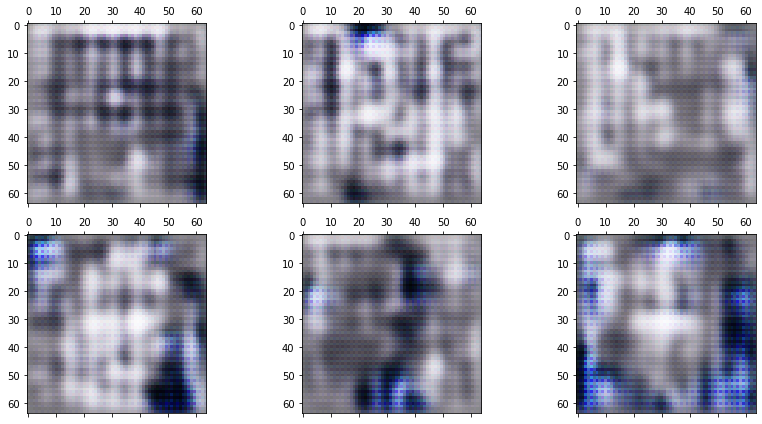

Epoch 542/2000
1/1 [==============================] - 1s 625ms/step
Epoch 543/2000
1/1 [==============================] - 1s 593ms/step
Epoch 544/2000
1/1 [==============================] - 1s 602ms/step
Epoch 545/2000
1/1 [==============================] - 1s 594ms/step
Epoch 546/2000
1/1 [==============================] - 1s 574ms/step
Epoch 547/2000
1/1 [==============================] - 1s 580ms/step
Epoch 548/2000
1/1 [==============================] - 1s 608ms/step
Epoch 549/2000
1/1 [==============================] - 1s 583ms/step
Epoch 550/2000
1/1 [==============================] - 1s 658ms/step
Epoch 551/2000
1/1 [==============================] - 1s 643ms/step
Epoch 552/2000
1/1 [==============================] - 1s 682ms/step
Epoch 553/2000
1/1 [==============================] - 1s 636ms/step
Epoch 554/2000
1/1 [==============================] - 1s 647ms/step
Epoch 555/2000
1/1 [==============================] - 1s 587ms/step
Epoch 556/2000
1/1 [============================

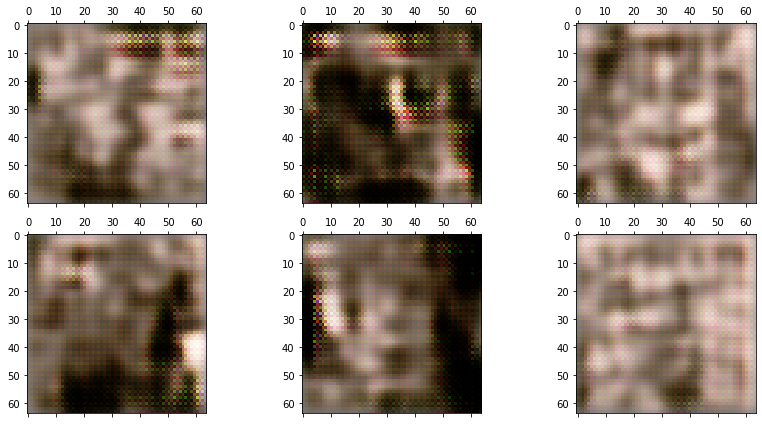

Epoch 562/2000
1/1 [==============================] - 1s 794ms/step
Epoch 563/2000
1/1 [==============================] - 1s 729ms/step
Epoch 564/2000
1/1 [==============================] - 1s 608ms/step
Epoch 565/2000
1/1 [==============================] - 1s 635ms/step
Epoch 566/2000
1/1 [==============================] - 1s 581ms/step
Epoch 567/2000
1/1 [==============================] - 1s 613ms/step
Epoch 568/2000
1/1 [==============================] - 1s 657ms/step
Epoch 569/2000
1/1 [==============================] - 1s 594ms/step
Epoch 570/2000
1/1 [==============================] - 1s 567ms/step
Epoch 571/2000
1/1 [==============================] - 1s 584ms/step
Epoch 572/2000
1/1 [==============================] - 1s 570ms/step
Epoch 573/2000
1/1 [==============================] - 1s 585ms/step
Epoch 574/2000
1/1 [==============================] - 1s 593ms/step
Epoch 575/2000
1/1 [==============================] - 1s 590ms/step
Epoch 576/2000
1/1 [============================

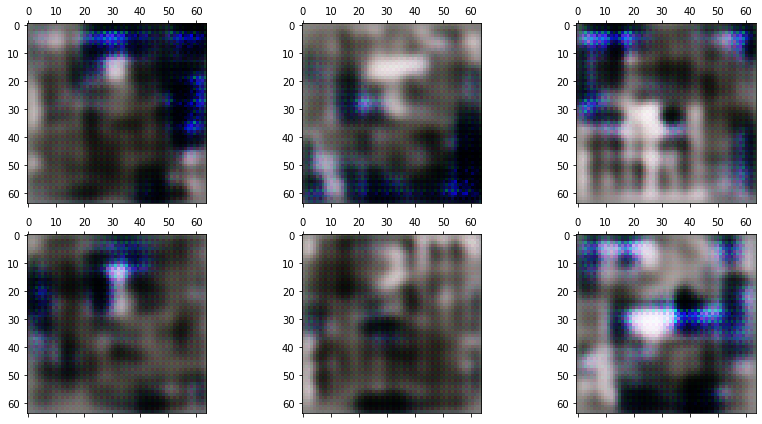

Epoch 582/2000
1/1 [==============================] - 1s 599ms/step
Epoch 583/2000
1/1 [==============================] - 1s 571ms/step
Epoch 584/2000
1/1 [==============================] - 1s 551ms/step
Epoch 585/2000
1/1 [==============================] - 1s 560ms/step
Epoch 586/2000
1/1 [==============================] - 1s 587ms/step
Epoch 587/2000
1/1 [==============================] - 1s 575ms/step
Epoch 588/2000
1/1 [==============================] - 1s 585ms/step
Epoch 589/2000
1/1 [==============================] - 1s 563ms/step
Epoch 590/2000
1/1 [==============================] - 1s 577ms/step
Epoch 591/2000
1/1 [==============================] - 1s 579ms/step
Epoch 592/2000
1/1 [==============================] - 1s 567ms/step
Epoch 593/2000
1/1 [==============================] - 1s 572ms/step
Epoch 594/2000
1/1 [==============================] - 1s 576ms/step
Epoch 595/2000
1/1 [==============================] - 1s 553ms/step
Epoch 596/2000
1/1 [============================

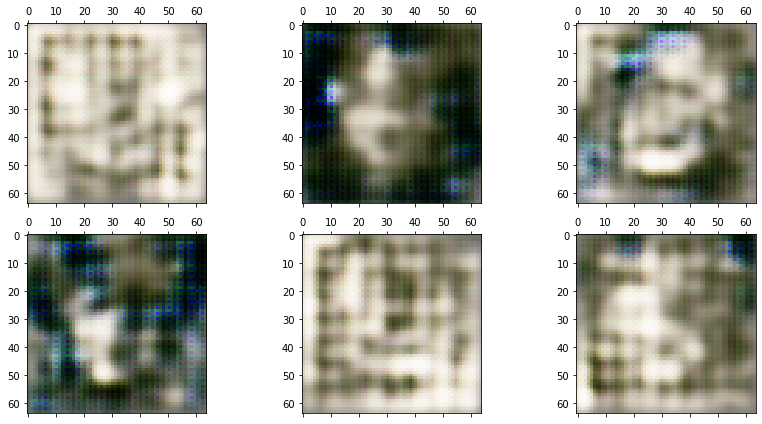

Epoch 602/2000
1/1 [==============================] - 1s 597ms/step
Epoch 603/2000
1/1 [==============================] - 1s 572ms/step
Epoch 604/2000
1/1 [==============================] - 1s 569ms/step
Epoch 605/2000
1/1 [==============================] - 1s 562ms/step
Epoch 606/2000
1/1 [==============================] - 1s 635ms/step
Epoch 607/2000
1/1 [==============================] - 1s 582ms/step
Epoch 608/2000
1/1 [==============================] - 1s 598ms/step
Epoch 609/2000
1/1 [==============================] - 0s 474ms/step
Epoch 610/2000
1/1 [==============================] - 0s 474ms/step
Epoch 611/2000
1/1 [==============================] - 0s 481ms/step
Epoch 612/2000
1/1 [==============================] - 1s 544ms/step
Epoch 613/2000
1/1 [==============================] - 0s 498ms/step
Epoch 614/2000
1/1 [==============================] - 1s 516ms/step
Epoch 615/2000
1/1 [==============================] - 1s 508ms/step
Epoch 616/2000
1/1 [============================

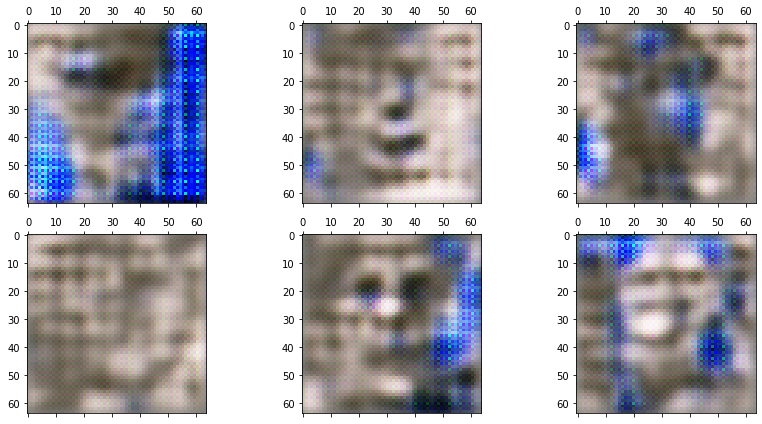

Epoch 622/2000
1/1 [==============================] - 1s 544ms/step
Epoch 623/2000
1/1 [==============================] - 1s 603ms/step
Epoch 624/2000
1/1 [==============================] - 1s 550ms/step
Epoch 625/2000
1/1 [==============================] - 1s 520ms/step
Epoch 626/2000
1/1 [==============================] - 1s 572ms/step
Epoch 627/2000
1/1 [==============================] - 1s 538ms/step
Epoch 628/2000
1/1 [==============================] - 1s 591ms/step
Epoch 629/2000
1/1 [==============================] - 1s 565ms/step
Epoch 630/2000
1/1 [==============================] - 1s 638ms/step
Epoch 631/2000
1/1 [==============================] - 1s 652ms/step
Epoch 632/2000
1/1 [==============================] - 1s 581ms/step
Epoch 633/2000
1/1 [==============================] - 1s 571ms/step
Epoch 634/2000
1/1 [==============================] - 1s 540ms/step
Epoch 635/2000
1/1 [==============================] - 1s 548ms/step
Epoch 636/2000
1/1 [============================

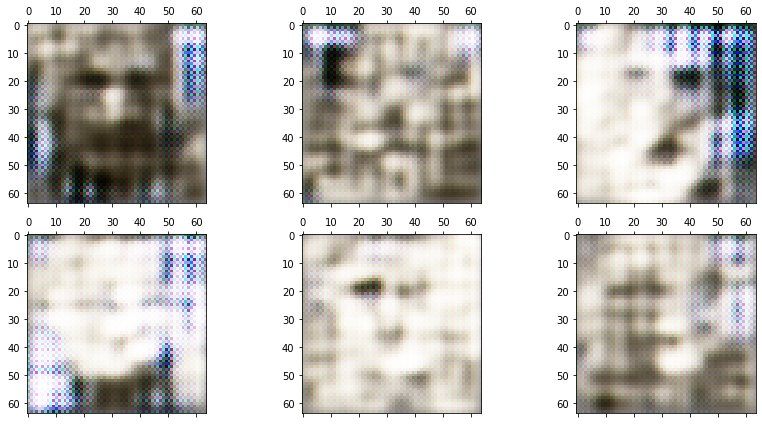

Epoch 642/2000
1/1 [==============================] - 1s 586ms/step
Epoch 643/2000
1/1 [==============================] - 1s 532ms/step
Epoch 644/2000
1/1 [==============================] - 1s 533ms/step
Epoch 645/2000
1/1 [==============================] - 1s 535ms/step
Epoch 646/2000
1/1 [==============================] - 1s 533ms/step
Epoch 647/2000
1/1 [==============================] - 1s 533ms/step
Epoch 648/2000
1/1 [==============================] - 1s 573ms/step
Epoch 649/2000
1/1 [==============================] - 1s 543ms/step
Epoch 650/2000
1/1 [==============================] - 1s 550ms/step
Epoch 651/2000
1/1 [==============================] - 1s 543ms/step
Epoch 652/2000
1/1 [==============================] - 1s 556ms/step
Epoch 653/2000
1/1 [==============================] - 1s 542ms/step
Epoch 654/2000
1/1 [==============================] - 1s 535ms/step
Epoch 655/2000
1/1 [==============================] - 1s 537ms/step
Epoch 656/2000
1/1 [============================

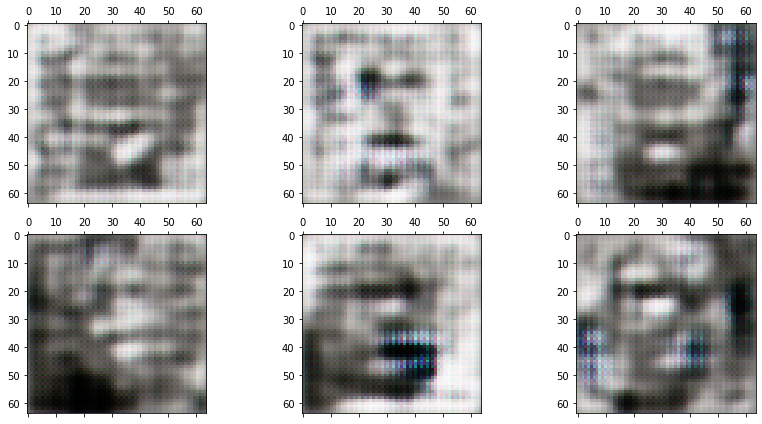

Epoch 662/2000
1/1 [==============================] - 1s 551ms/step
Epoch 663/2000
1/1 [==============================] - 1s 531ms/step
Epoch 664/2000
1/1 [==============================] - 1s 546ms/step
Epoch 665/2000
1/1 [==============================] - 1s 540ms/step
Epoch 666/2000
1/1 [==============================] - 1s 592ms/step
Epoch 667/2000
1/1 [==============================] - 1s 539ms/step
Epoch 668/2000
1/1 [==============================] - 1s 542ms/step
Epoch 669/2000
1/1 [==============================] - 1s 620ms/step
Epoch 670/2000
1/1 [==============================] - 1s 556ms/step
Epoch 671/2000
1/1 [==============================] - 1s 550ms/step
Epoch 672/2000
1/1 [==============================] - 1s 586ms/step
Epoch 673/2000
1/1 [==============================] - 1s 545ms/step
Epoch 674/2000
1/1 [==============================] - 1s 537ms/step
Epoch 675/2000
1/1 [==============================] - 1s 529ms/step
Epoch 676/2000
1/1 [============================

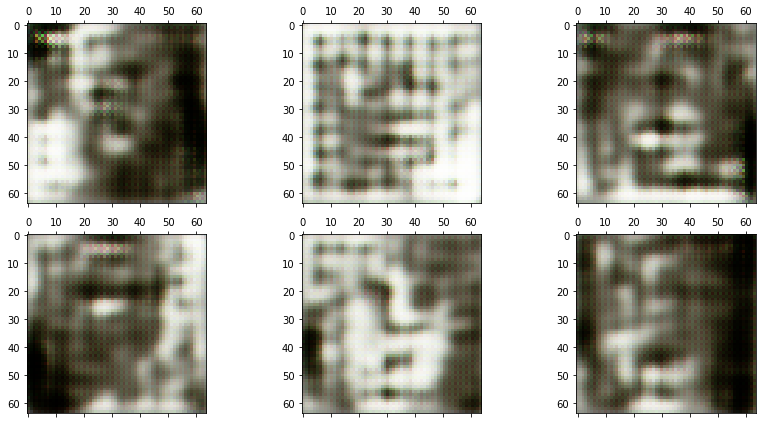

Epoch 682/2000
1/1 [==============================] - 1s 564ms/step
Epoch 683/2000
1/1 [==============================] - 1s 603ms/step
Epoch 684/2000
1/1 [==============================] - 1s 549ms/step
Epoch 685/2000
1/1 [==============================] - 1s 538ms/step
Epoch 686/2000
1/1 [==============================] - 1s 541ms/step
Epoch 687/2000
1/1 [==============================] - 1s 566ms/step
Epoch 688/2000
1/1 [==============================] - 1s 537ms/step
Epoch 689/2000
1/1 [==============================] - 1s 593ms/step
Epoch 690/2000
1/1 [==============================] - 1s 623ms/step
Epoch 691/2000
1/1 [==============================] - 1s 683ms/step
Epoch 692/2000
1/1 [==============================] - 1s 684ms/step
Epoch 693/2000
1/1 [==============================] - 1s 569ms/step
Epoch 694/2000
1/1 [==============================] - 1s 607ms/step
Epoch 695/2000
1/1 [==============================] - 1s 562ms/step
Epoch 696/2000
1/1 [============================

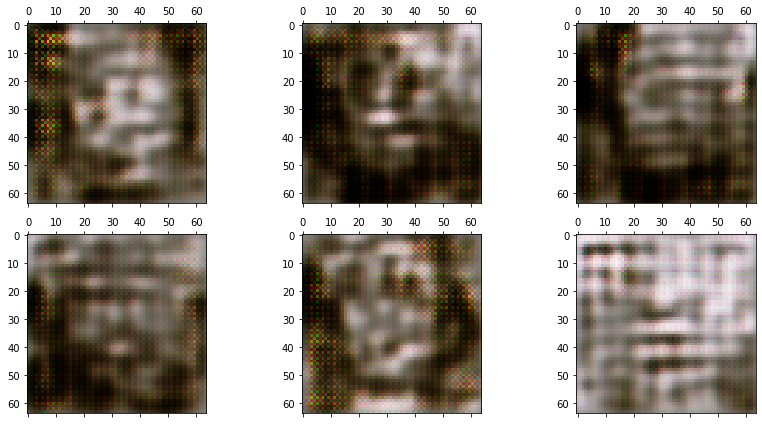

Epoch 702/2000
1/1 [==============================] - 1s 638ms/step
Epoch 703/2000
1/1 [==============================] - 1s 551ms/step
Epoch 704/2000
1/1 [==============================] - 1s 589ms/step
Epoch 705/2000
1/1 [==============================] - 1s 648ms/step
Epoch 706/2000
1/1 [==============================] - 1s 630ms/step
Epoch 707/2000
1/1 [==============================] - 1s 900ms/step
Epoch 708/2000
1/1 [==============================] - 1s 570ms/step
Epoch 709/2000
1/1 [==============================] - 1s 568ms/step
Epoch 710/2000
1/1 [==============================] - 1s 583ms/step
Epoch 711/2000
1/1 [==============================] - 1s 559ms/step
Epoch 712/2000
1/1 [==============================] - 1s 618ms/step
Epoch 713/2000
1/1 [==============================] - 1s 600ms/step
Epoch 714/2000
1/1 [==============================] - 1s 632ms/step
Epoch 715/2000
1/1 [==============================] - 1s 588ms/step
Epoch 716/2000
1/1 [============================

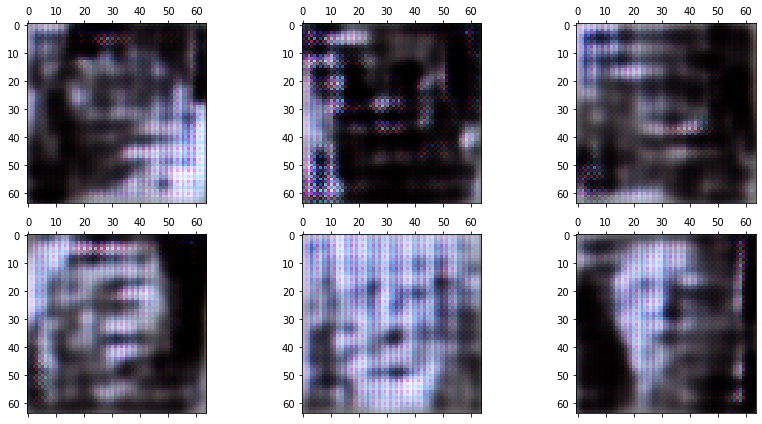

Epoch 722/2000
1/1 [==============================] - 1s 554ms/step
Epoch 723/2000
1/1 [==============================] - 1s 594ms/step
Epoch 724/2000
1/1 [==============================] - 1s 618ms/step
Epoch 725/2000
1/1 [==============================] - 1s 627ms/step
Epoch 726/2000
1/1 [==============================] - 1s 627ms/step
Epoch 727/2000
1/1 [==============================] - 1s 641ms/step
Epoch 728/2000
1/1 [==============================] - 1s 543ms/step
Epoch 729/2000
1/1 [==============================] - 1s 645ms/step
Epoch 730/2000
1/1 [==============================] - 1s 546ms/step
Epoch 731/2000
1/1 [==============================] - 1s 544ms/step
Epoch 732/2000
1/1 [==============================] - 1s 540ms/step
Epoch 733/2000
1/1 [==============================] - 1s 565ms/step
Epoch 734/2000
1/1 [==============================] - 1s 617ms/step
Epoch 735/2000
1/1 [==============================] - 1s 566ms/step
Epoch 736/2000
1/1 [============================

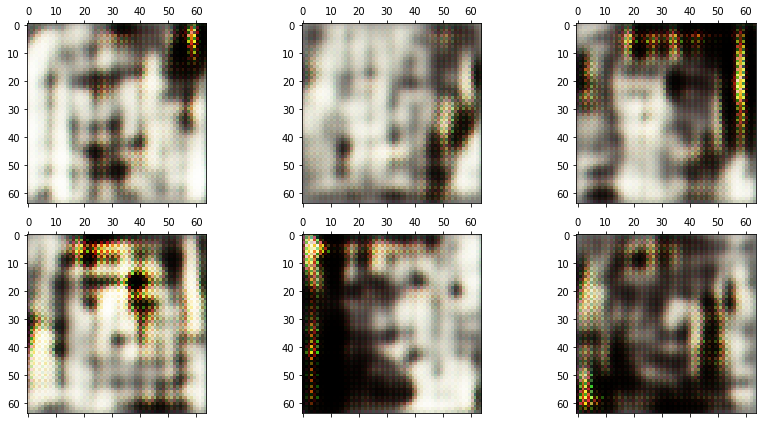

Epoch 742/2000
1/1 [==============================] - 1s 590ms/step
Epoch 743/2000
1/1 [==============================] - 1s 648ms/step
Epoch 744/2000
1/1 [==============================] - 1s 590ms/step
Epoch 745/2000
1/1 [==============================] - 1s 668ms/step
Epoch 746/2000
1/1 [==============================] - 1s 603ms/step
Epoch 747/2000
1/1 [==============================] - 1s 567ms/step
Epoch 748/2000
1/1 [==============================] - 1s 556ms/step
Epoch 749/2000
1/1 [==============================] - 1s 563ms/step
Epoch 750/2000
1/1 [==============================] - 1s 649ms/step
Epoch 751/2000
1/1 [==============================] - 1s 600ms/step
Epoch 752/2000
1/1 [==============================] - 1s 603ms/step
Epoch 753/2000
1/1 [==============================] - 1s 649ms/step
Epoch 754/2000
1/1 [==============================] - 1s 618ms/step
Epoch 755/2000
1/1 [==============================] - 1s 611ms/step
Epoch 756/2000
1/1 [============================

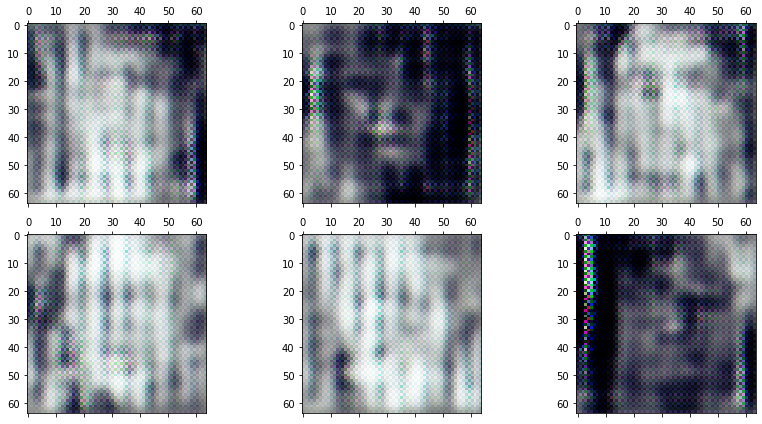

Epoch 762/2000
1/1 [==============================] - 1s 609ms/step
Epoch 763/2000
1/1 [==============================] - 1s 748ms/step
Epoch 764/2000
1/1 [==============================] - 1s 767ms/step
Epoch 765/2000
1/1 [==============================] - 1s 584ms/step
Epoch 766/2000
1/1 [==============================] - 1s 609ms/step
Epoch 767/2000
1/1 [==============================] - 1s 582ms/step
Epoch 768/2000
1/1 [==============================] - 1s 598ms/step
Epoch 769/2000
1/1 [==============================] - 1s 585ms/step
Epoch 770/2000
1/1 [==============================] - 1s 581ms/step
Epoch 771/2000
1/1 [==============================] - 1s 584ms/step
Epoch 772/2000
1/1 [==============================] - 1s 580ms/step
Epoch 773/2000
1/1 [==============================] - 1s 581ms/step
Epoch 774/2000
1/1 [==============================] - 1s 578ms/step
Epoch 775/2000
1/1 [==============================] - 1s 577ms/step
Epoch 776/2000
1/1 [============================

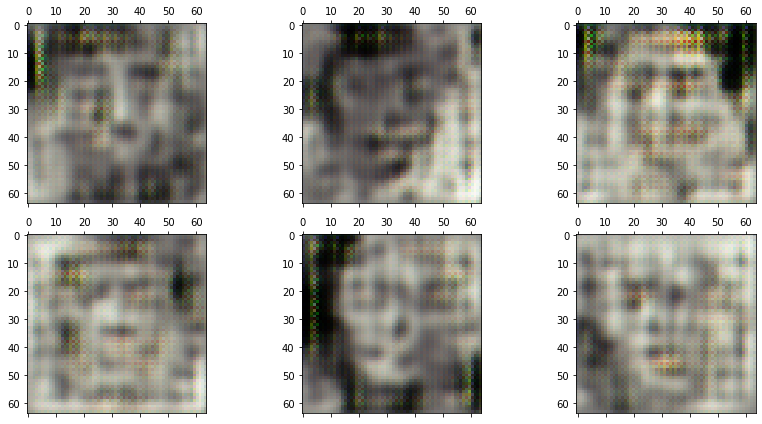

Epoch 782/2000
1/1 [==============================] - 1s 617ms/step
Epoch 783/2000
1/1 [==============================] - 1s 603ms/step
Epoch 784/2000
1/1 [==============================] - 1s 593ms/step
Epoch 785/2000
1/1 [==============================] - 1s 573ms/step
Epoch 786/2000
1/1 [==============================] - 1s 586ms/step
Epoch 787/2000
1/1 [==============================] - 1s 600ms/step
Epoch 788/2000
1/1 [==============================] - 1s 682ms/step
Epoch 789/2000
1/1 [==============================] - 1s 669ms/step
Epoch 790/2000
1/1 [==============================] - 1s 661ms/step
Epoch 791/2000
1/1 [==============================] - 1s 621ms/step
Epoch 792/2000
1/1 [==============================] - 1s 624ms/step
Epoch 793/2000
1/1 [==============================] - 1s 604ms/step
Epoch 794/2000
1/1 [==============================] - 1s 666ms/step
Epoch 795/2000
1/1 [==============================] - 1s 597ms/step
Epoch 796/2000
1/1 [============================

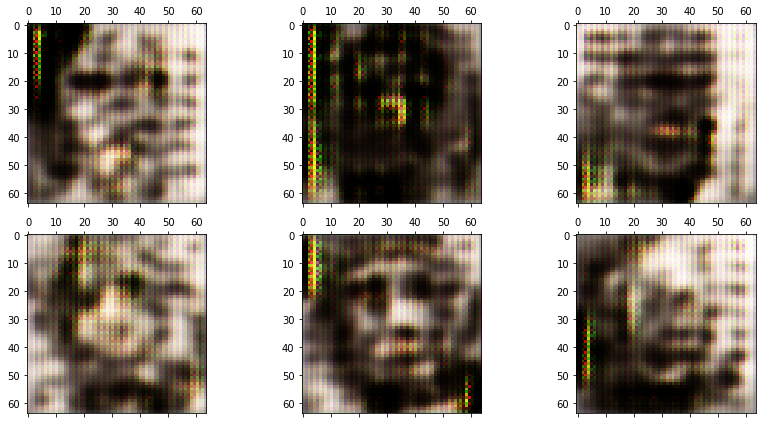

Epoch 802/2000
1/1 [==============================] - 1s 640ms/step
Epoch 803/2000
1/1 [==============================] - 1s 610ms/step
Epoch 804/2000
1/1 [==============================] - 1s 576ms/step
Epoch 805/2000
1/1 [==============================] - 1s 649ms/step
Epoch 806/2000
1/1 [==============================] - 1s 607ms/step
Epoch 807/2000
1/1 [==============================] - 1s 613ms/step
Epoch 808/2000
1/1 [==============================] - 1s 593ms/step
Epoch 809/2000
1/1 [==============================] - 1s 602ms/step
Epoch 810/2000
1/1 [==============================] - 1s 599ms/step
Epoch 811/2000
1/1 [==============================] - 1s 664ms/step
Epoch 812/2000
1/1 [==============================] - 1s 658ms/step
Epoch 813/2000
1/1 [==============================] - 1s 660ms/step
Epoch 814/2000
1/1 [==============================] - 1s 601ms/step
Epoch 815/2000
1/1 [==============================] - 1s 598ms/step
Epoch 816/2000
1/1 [============================

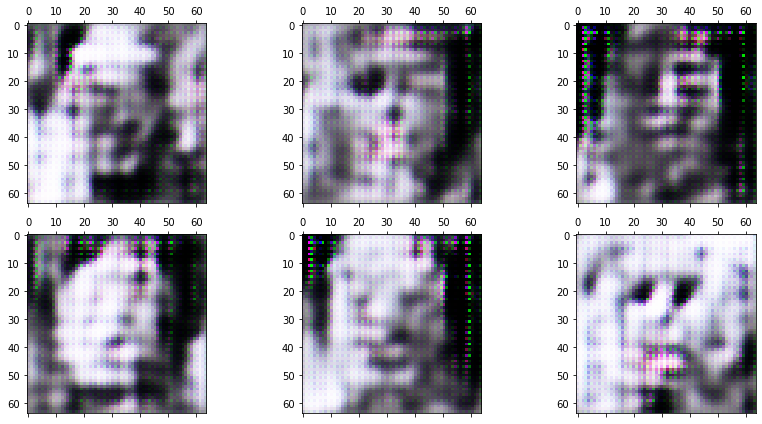

Epoch 822/2000
1/1 [==============================] - 1s 654ms/step
Epoch 823/2000
1/1 [==============================] - 1s 599ms/step
Epoch 824/2000
1/1 [==============================] - 1s 587ms/step
Epoch 825/2000
1/1 [==============================] - 1s 594ms/step
Epoch 826/2000
1/1 [==============================] - 1s 579ms/step
Epoch 827/2000
1/1 [==============================] - 1s 599ms/step
Epoch 828/2000
1/1 [==============================] - 1s 588ms/step
Epoch 829/2000
1/1 [==============================] - 1s 582ms/step
Epoch 830/2000
1/1 [==============================] - 1s 640ms/step
Epoch 831/2000
1/1 [==============================] - 1s 612ms/step
Epoch 832/2000
1/1 [==============================] - 1s 583ms/step
Epoch 833/2000
1/1 [==============================] - 1s 649ms/step
Epoch 834/2000
1/1 [==============================] - 1s 599ms/step
Epoch 835/2000
1/1 [==============================] - 1s 638ms/step
Epoch 836/2000
1/1 [============================

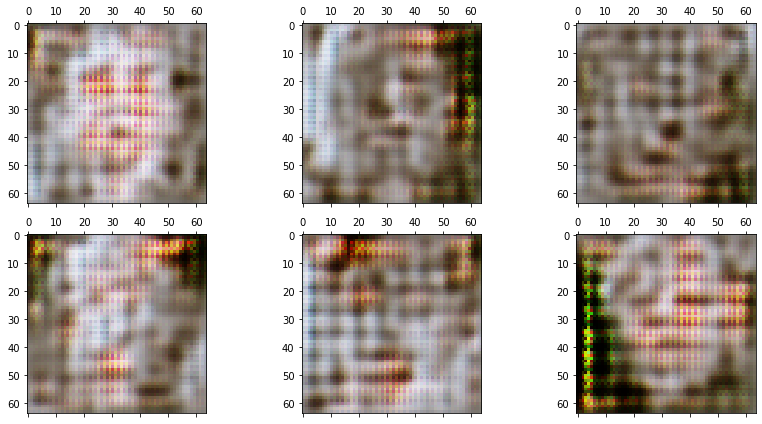

Epoch 842/2000
1/1 [==============================] - 1s 725ms/step
Epoch 843/2000
1/1 [==============================] - 1s 638ms/step
Epoch 844/2000
1/1 [==============================] - 1s 718ms/step
Epoch 845/2000
1/1 [==============================] - 1s 877ms/step
Epoch 846/2000
1/1 [==============================] - 1s 584ms/step
Epoch 847/2000
1/1 [==============================] - 1s 597ms/step
Epoch 848/2000
1/1 [==============================] - 1s 575ms/step
Epoch 849/2000
1/1 [==============================] - 1s 569ms/step
Epoch 850/2000
1/1 [==============================] - 1s 601ms/step
Epoch 851/2000
1/1 [==============================] - 1s 566ms/step
Epoch 852/2000
1/1 [==============================] - 1s 562ms/step
Epoch 853/2000
1/1 [==============================] - 1s 556ms/step
Epoch 854/2000
1/1 [==============================] - 1s 568ms/step
Epoch 855/2000
1/1 [==============================] - 1s 632ms/step
Epoch 856/2000
1/1 [============================

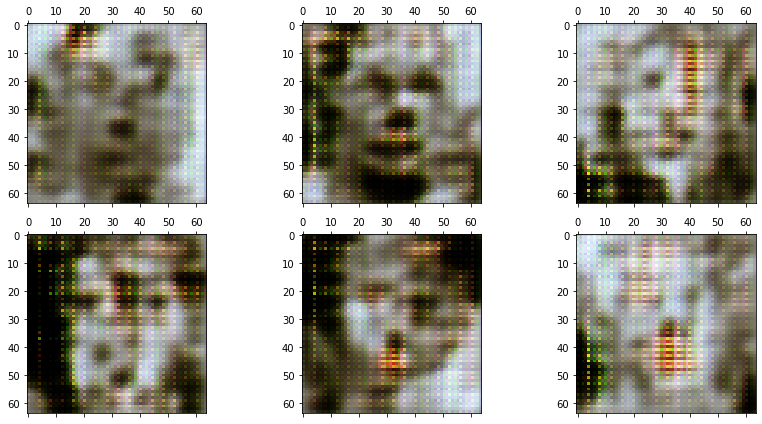

Epoch 862/2000
1/1 [==============================] - 1s 694ms/step
Epoch 863/2000
1/1 [==============================] - 1s 600ms/step
Epoch 864/2000
1/1 [==============================] - 1s 629ms/step
Epoch 865/2000
1/1 [==============================] - 1s 644ms/step
Epoch 866/2000
1/1 [==============================] - 1s 582ms/step
Epoch 867/2000
1/1 [==============================] - 1s 872ms/step
Epoch 868/2000
1/1 [==============================] - 1s 620ms/step
Epoch 869/2000
1/1 [==============================] - 1s 586ms/step
Epoch 870/2000
1/1 [==============================] - 1s 574ms/step
Epoch 871/2000
1/1 [==============================] - 1s 565ms/step
Epoch 872/2000
1/1 [==============================] - 1s 582ms/step
Epoch 873/2000
1/1 [==============================] - 1s 582ms/step
Epoch 874/2000
1/1 [==============================] - 1s 569ms/step
Epoch 875/2000
1/1 [==============================] - 1s 578ms/step
Epoch 876/2000
1/1 [============================

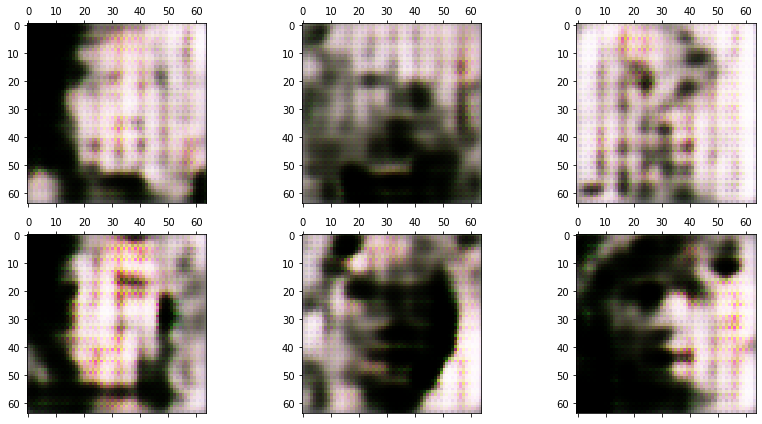

Epoch 882/2000
1/1 [==============================] - 1s 632ms/step
Epoch 883/2000
1/1 [==============================] - 1s 562ms/step
Epoch 884/2000
1/1 [==============================] - 1s 590ms/step
Epoch 885/2000
1/1 [==============================] - 1s 644ms/step
Epoch 886/2000
1/1 [==============================] - 1s 637ms/step
Epoch 887/2000
1/1 [==============================] - 1s 604ms/step
Epoch 888/2000
1/1 [==============================] - 1s 604ms/step
Epoch 889/2000
1/1 [==============================] - 1s 618ms/step
Epoch 890/2000
1/1 [==============================] - 1s 596ms/step
Epoch 891/2000
1/1 [==============================] - 1s 608ms/step
Epoch 892/2000
1/1 [==============================] - 1s 678ms/step
Epoch 893/2000
1/1 [==============================] - 1s 643ms/step
Epoch 894/2000
1/1 [==============================] - 1s 605ms/step
Epoch 895/2000
1/1 [==============================] - 1s 634ms/step
Epoch 896/2000
1/1 [============================

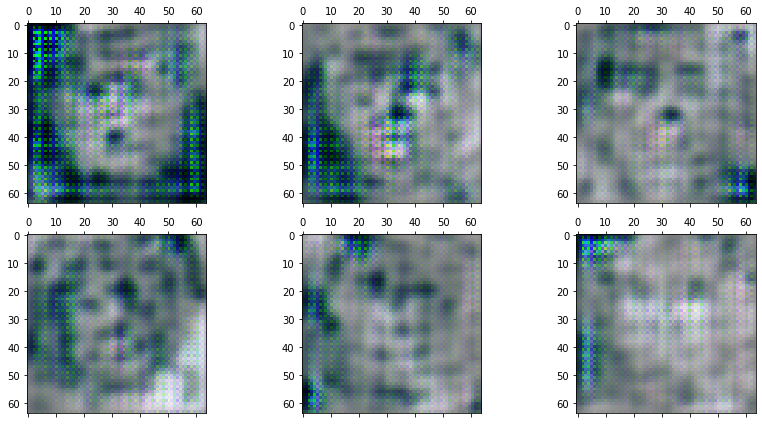

Epoch 902/2000
1/1 [==============================] - 1s 665ms/step
Epoch 903/2000
1/1 [==============================] - 1s 590ms/step
Epoch 904/2000
1/1 [==============================] - 1s 662ms/step
Epoch 905/2000
1/1 [==============================] - 1s 580ms/step
Epoch 906/2000
1/1 [==============================] - 1s 609ms/step
Epoch 907/2000
1/1 [==============================] - 1s 614ms/step
Epoch 908/2000
1/1 [==============================] - 1s 603ms/step
Epoch 909/2000
1/1 [==============================] - 1s 773ms/step
Epoch 910/2000
1/1 [==============================] - 1s 606ms/step
Epoch 911/2000
1/1 [==============================] - 1s 637ms/step
Epoch 912/2000
1/1 [==============================] - 1s 585ms/step
Epoch 913/2000
1/1 [==============================] - 1s 586ms/step
Epoch 914/2000
1/1 [==============================] - 1s 574ms/step
Epoch 915/2000
1/1 [==============================] - 1s 592ms/step
Epoch 916/2000
1/1 [============================

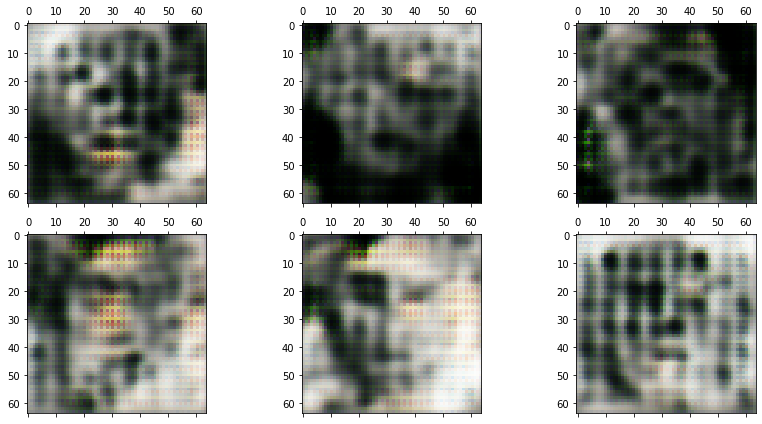

Epoch 922/2000
1/1 [==============================] - 1s 581ms/step
Epoch 923/2000
1/1 [==============================] - 1s 553ms/step
Epoch 924/2000
1/1 [==============================] - 1s 566ms/step
Epoch 925/2000
1/1 [==============================] - 1s 554ms/step
Epoch 926/2000
1/1 [==============================] - 1s 555ms/step
Epoch 927/2000
1/1 [==============================] - 1s 553ms/step
Epoch 928/2000
1/1 [==============================] - 1s 548ms/step
Epoch 929/2000
1/1 [==============================] - 1s 550ms/step
Epoch 930/2000
1/1 [==============================] - 1s 550ms/step
Epoch 931/2000
1/1 [==============================] - 1s 547ms/step
Epoch 932/2000
1/1 [==============================] - 1s 576ms/step
Epoch 933/2000
1/1 [==============================] - 1s 641ms/step
Epoch 934/2000
1/1 [==============================] - 1s 625ms/step
Epoch 935/2000
1/1 [==============================] - 1s 562ms/step
Epoch 936/2000
1/1 [============================

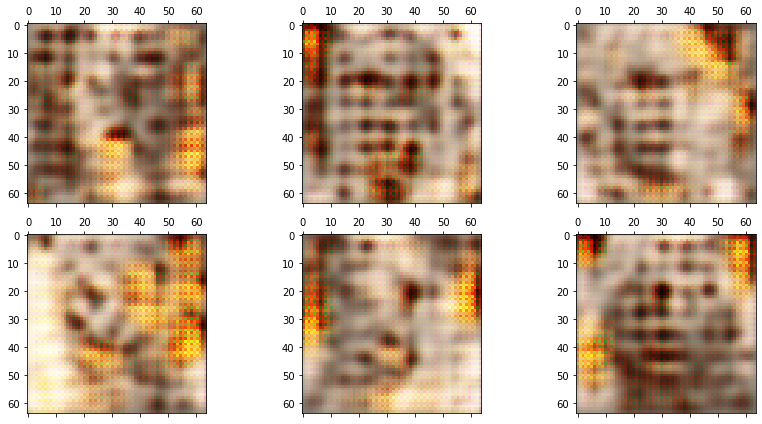

Epoch 942/2000
1/1 [==============================] - 1s 675ms/step
Epoch 943/2000
1/1 [==============================] - 1s 567ms/step
Epoch 944/2000
1/1 [==============================] - 1s 573ms/step
Epoch 945/2000
1/1 [==============================] - 1s 603ms/step
Epoch 946/2000
1/1 [==============================] - 1s 584ms/step
Epoch 947/2000
1/1 [==============================] - 1s 583ms/step
Epoch 948/2000
1/1 [==============================] - 1s 602ms/step
Epoch 949/2000
1/1 [==============================] - 1s 577ms/step
Epoch 950/2000
1/1 [==============================] - 1s 578ms/step
Epoch 951/2000
1/1 [==============================] - 1s 576ms/step
Epoch 952/2000
1/1 [==============================] - 1s 572ms/step
Epoch 953/2000
1/1 [==============================] - 1s 564ms/step
Epoch 954/2000
1/1 [==============================] - 1s 563ms/step
Epoch 955/2000
1/1 [==============================] - 1s 556ms/step
Epoch 956/2000
1/1 [============================

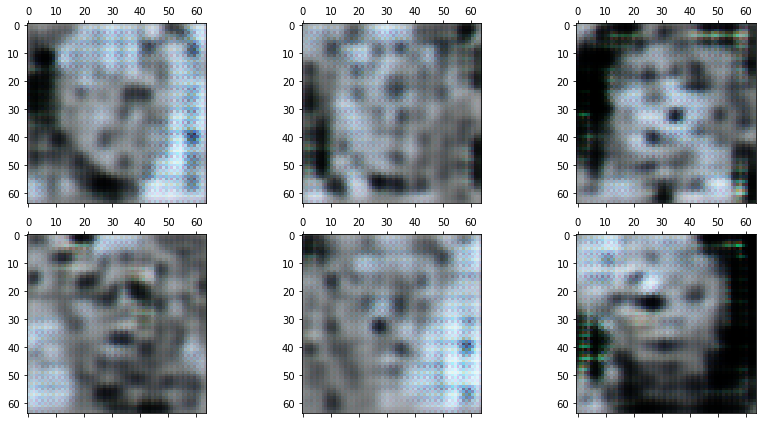

Epoch 962/2000
1/1 [==============================] - 1s 650ms/step
Epoch 963/2000
1/1 [==============================] - 1s 614ms/step
Epoch 964/2000
1/1 [==============================] - 1s 591ms/step
Epoch 965/2000
1/1 [==============================] - 1s 574ms/step
Epoch 966/2000
1/1 [==============================] - 1s 557ms/step
Epoch 967/2000
1/1 [==============================] - 1s 607ms/step
Epoch 968/2000
1/1 [==============================] - 1s 614ms/step
Epoch 969/2000
1/1 [==============================] - 1s 570ms/step
Epoch 970/2000
1/1 [==============================] - 1s 566ms/step
Epoch 971/2000
1/1 [==============================] - 1s 630ms/step
Epoch 972/2000
1/1 [==============================] - 1s 580ms/step
Epoch 973/2000
1/1 [==============================] - 1s 635ms/step
Epoch 974/2000
1/1 [==============================] - 1s 578ms/step
Epoch 975/2000
1/1 [==============================] - 1s 580ms/step
Epoch 976/2000
1/1 [============================

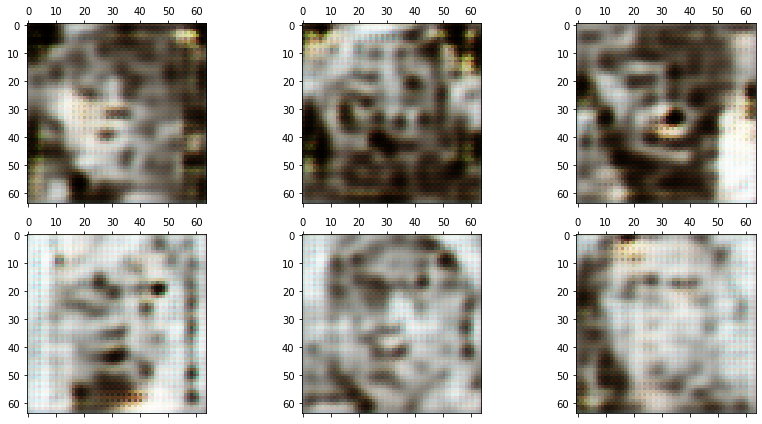

Epoch 982/2000
1/1 [==============================] - 1s 646ms/step
Epoch 983/2000
1/1 [==============================] - 1s 569ms/step
Epoch 984/2000
1/1 [==============================] - 1s 552ms/step
Epoch 985/2000
1/1 [==============================] - 1s 563ms/step
Epoch 986/2000
1/1 [==============================] - 1s 554ms/step
Epoch 987/2000
1/1 [==============================] - 1s 566ms/step
Epoch 988/2000
1/1 [==============================] - 1s 573ms/step
Epoch 989/2000
1/1 [==============================] - 1s 566ms/step
Epoch 990/2000
1/1 [==============================] - 1s 566ms/step
Epoch 991/2000
1/1 [==============================] - 1s 566ms/step
Epoch 992/2000
1/1 [==============================] - 1s 568ms/step
Epoch 993/2000
1/1 [==============================] - 1s 563ms/step
Epoch 994/2000
1/1 [==============================] - 1s 564ms/step
Epoch 995/2000
1/1 [==============================] - 1s 569ms/step
Epoch 996/2000
1/1 [============================

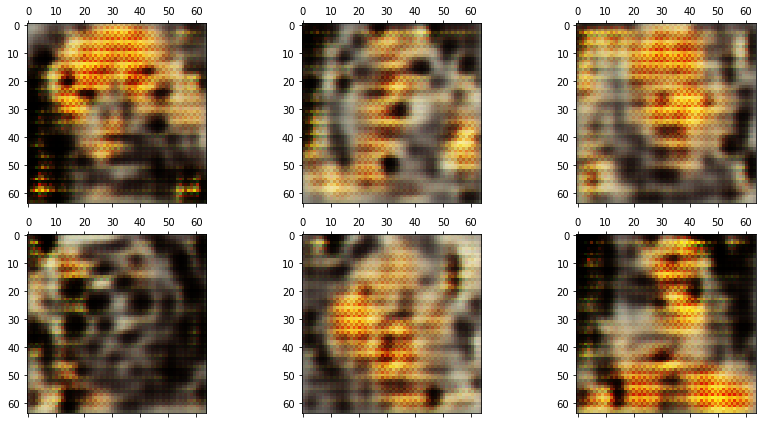

Epoch 1002/2000
1/1 [==============================] - 1s 651ms/step
Epoch 1003/2000
1/1 [==============================] - 1s 557ms/step
Epoch 1004/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1005/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1006/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1007/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1008/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1009/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1010/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1011/2000
1/1 [==============================] - 1s 846ms/step
Epoch 1012/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1013/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1014/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1015/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1016/2000
1/1 [=============

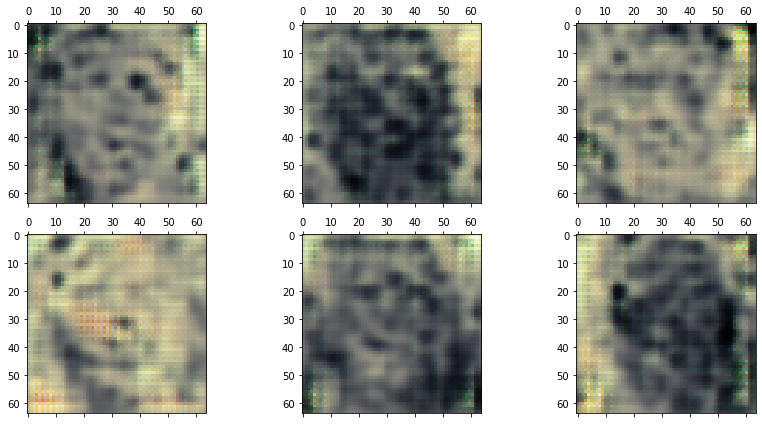

Epoch 1022/2000
1/1 [==============================] - 1s 632ms/step
Epoch 1023/2000
1/1 [==============================] - 1s 595ms/step
Epoch 1024/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1025/2000
1/1 [==============================] - 1s 600ms/step
Epoch 1026/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1027/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1028/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1029/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1030/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1031/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1032/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1033/2000
1/1 [==============================] - 1s 591ms/step
Epoch 1034/2000
1/1 [==============================] - 1s 612ms/step
Epoch 1035/2000
1/1 [==============================] - 1s 618ms/step
Epoch 1036/2000
1/1 [=============

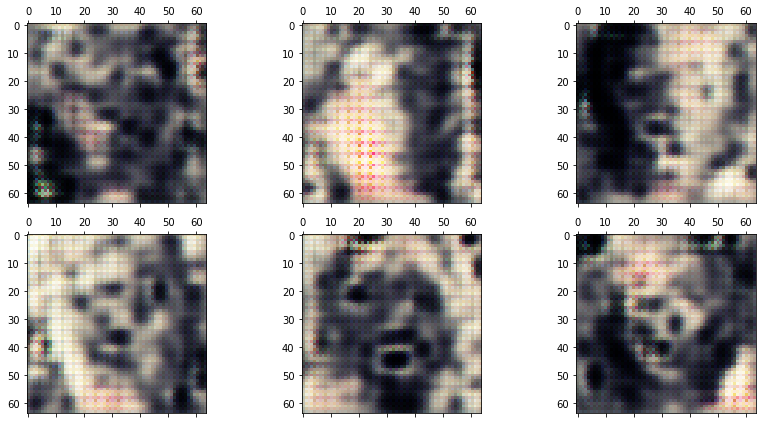

Epoch 1042/2000
1/1 [==============================] - 1s 674ms/step
Epoch 1043/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1044/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1045/2000
1/1 [==============================] - 1s 590ms/step
Epoch 1046/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1047/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1048/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1049/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1050/2000
1/1 [==============================] - 1s 608ms/step
Epoch 1051/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1052/2000
1/1 [==============================] - 1s 641ms/step
Epoch 1053/2000
1/1 [==============================] - 1s 596ms/step
Epoch 1054/2000
1/1 [==============================] - 1s 623ms/step
Epoch 1055/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1056/2000
1/1 [=============

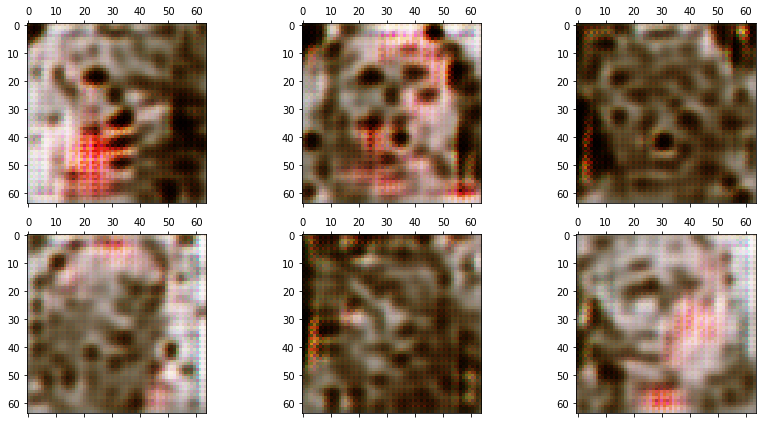

Epoch 1062/2000
1/1 [==============================] - 1s 716ms/step
Epoch 1063/2000
1/1 [==============================] - 1s 656ms/step
Epoch 1064/2000
1/1 [==============================] - 1s 609ms/step
Epoch 1065/2000
1/1 [==============================] - 1s 613ms/step
Epoch 1066/2000
1/1 [==============================] - 1s 634ms/step
Epoch 1067/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1068/2000
1/1 [==============================] - 1s 607ms/step
Epoch 1069/2000
1/1 [==============================] - 1s 628ms/step
Epoch 1070/2000
1/1 [==============================] - 1s 601ms/step
Epoch 1071/2000
1/1 [==============================] - 1s 594ms/step
Epoch 1072/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1073/2000
1/1 [==============================] - 1s 591ms/step
Epoch 1074/2000
1/1 [==============================] - 1s 636ms/step
Epoch 1075/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1076/2000
1/1 [=============

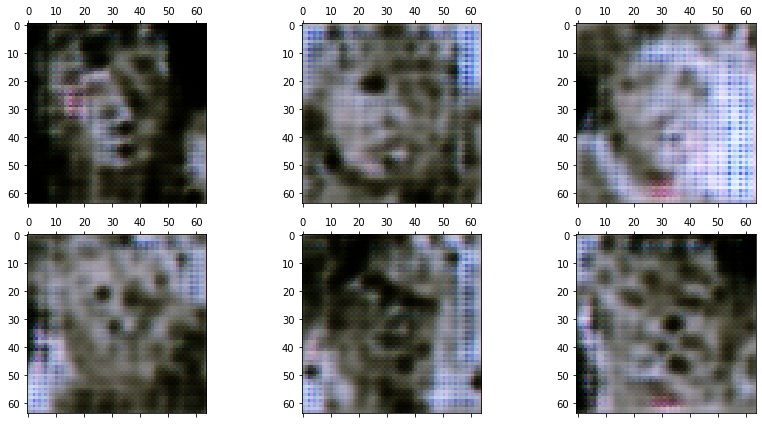

Epoch 1082/2000
1/1 [==============================] - 1s 642ms/step
Epoch 1083/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1084/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1085/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1086/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1087/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1088/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1089/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1090/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1091/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1092/2000
1/1 [==============================] - 1s 544ms/step
Epoch 1093/2000
1/1 [==============================] - 1s 598ms/step
Epoch 1094/2000
1/1 [==============================] - 1s 593ms/step
Epoch 1095/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1096/2000
1/1 [=============

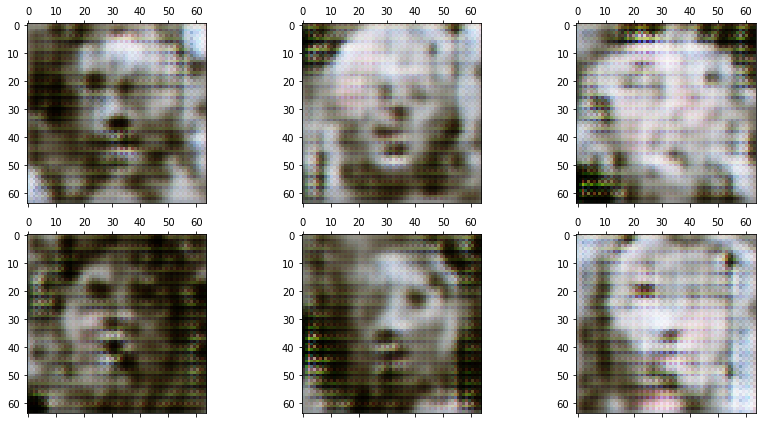

Epoch 1102/2000
1/1 [==============================] - 1s 669ms/step
Epoch 1103/2000
1/1 [==============================] - 1s 621ms/step
Epoch 1104/2000
1/1 [==============================] - 1s 615ms/step
Epoch 1105/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1106/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1107/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1108/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1109/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1110/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1111/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1112/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1113/2000
1/1 [==============================] - 1s 597ms/step
Epoch 1114/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1115/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1116/2000
1/1 [=============

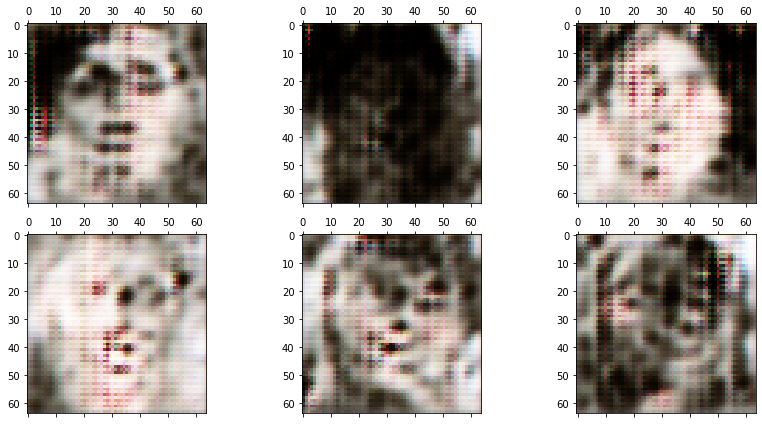

Epoch 1122/2000
1/1 [==============================] - 1s 595ms/step
Epoch 1123/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1124/2000
1/1 [==============================] - 1s 599ms/step
Epoch 1125/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1126/2000
1/1 [==============================] - 1s 593ms/step
Epoch 1127/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1128/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1129/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1130/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1131/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1132/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1133/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1134/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1135/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1136/2000
1/1 [=============

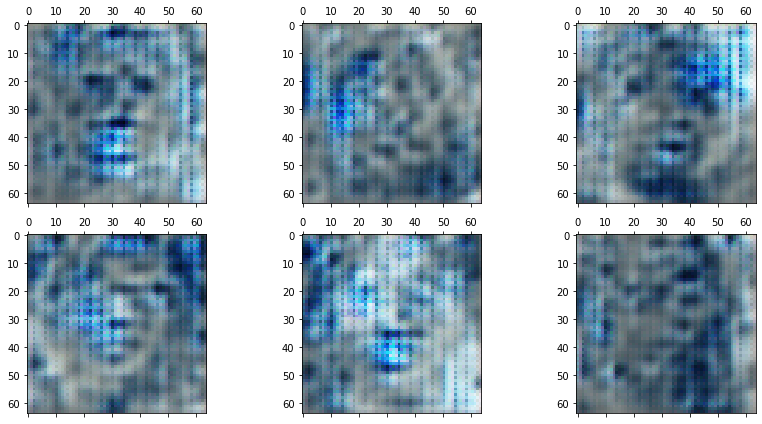

Epoch 1142/2000
1/1 [==============================] - 1s 625ms/step
Epoch 1143/2000
1/1 [==============================] - 1s 593ms/step
Epoch 1144/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1145/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1146/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1147/2000
1/1 [==============================] - 1s 642ms/step
Epoch 1148/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1149/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1150/2000
1/1 [==============================] - 1s 615ms/step
Epoch 1151/2000
1/1 [==============================] - 1s 614ms/step
Epoch 1152/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1153/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1154/2000
1/1 [==============================] - 1s 600ms/step
Epoch 1155/2000
1/1 [==============================] - 1s 590ms/step
Epoch 1156/2000
1/1 [=============

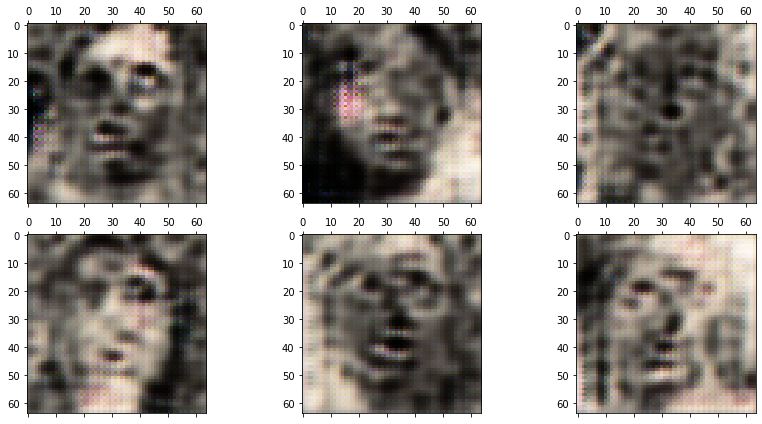

Epoch 1162/2000
1/1 [==============================] - 1s 651ms/step
Epoch 1163/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1164/2000
1/1 [==============================] - 1s 622ms/step
Epoch 1165/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1166/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1167/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1168/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1169/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1170/2000
1/1 [==============================] - 1s 637ms/step
Epoch 1171/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1172/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1173/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1174/2000
1/1 [==============================] - 1s 591ms/step
Epoch 1175/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1176/2000
1/1 [=============

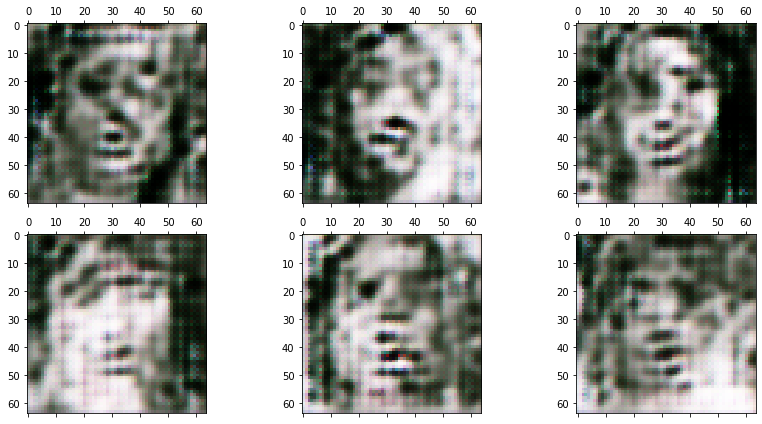

Epoch 1182/2000
1/1 [==============================] - 1s 641ms/step
Epoch 1183/2000
1/1 [==============================] - 1s 653ms/step
Epoch 1184/2000
1/1 [==============================] - 1s 627ms/step
Epoch 1185/2000
1/1 [==============================] - 1s 638ms/step
Epoch 1186/2000
1/1 [==============================] - 1s 608ms/step
Epoch 1187/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1188/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1189/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1190/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1191/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1192/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1193/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1194/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1195/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1196/2000
1/1 [=============

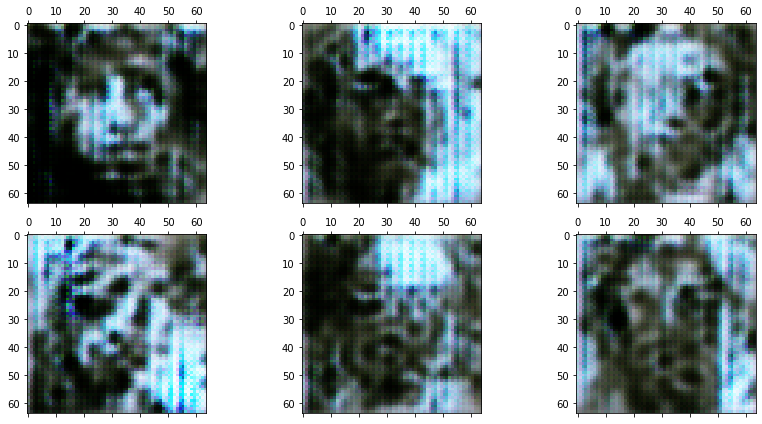

Epoch 1202/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1203/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1204/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1205/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1206/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1207/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1208/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1209/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1210/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1211/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1212/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1213/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1214/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1215/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1216/2000
1/1 [=============

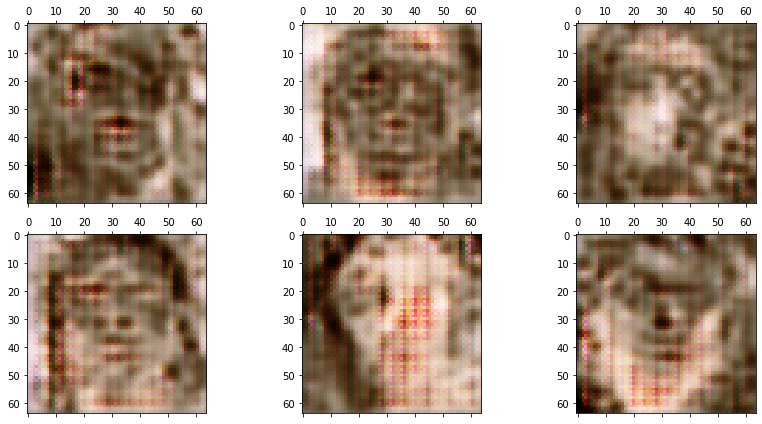

Epoch 1222/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1223/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1224/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1225/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1226/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1227/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1228/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1229/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1230/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1231/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1232/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1233/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1234/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1235/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1236/2000
1/1 [=============

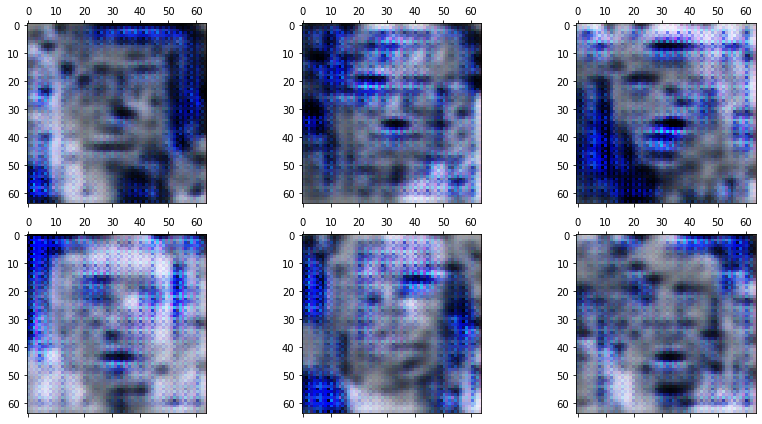

Epoch 1242/2000
1/1 [==============================] - 1s 633ms/step
Epoch 1243/2000
1/1 [==============================] - 1s 589ms/step
Epoch 1244/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1245/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1246/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1247/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1248/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1249/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1250/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1251/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1252/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1253/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1254/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1255/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1256/2000
1/1 [=============

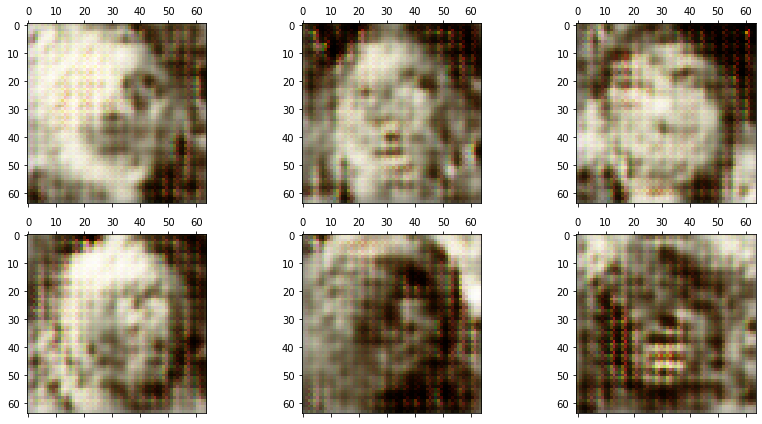

Epoch 1262/2000
1/1 [==============================] - 1s 713ms/step
Epoch 1263/2000
1/1 [==============================] - 1s 599ms/step
Epoch 1264/2000
1/1 [==============================] - 1s 617ms/step
Epoch 1265/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1266/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1267/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1268/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1269/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1270/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1271/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1272/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1273/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1274/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1275/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1276/2000
1/1 [=============

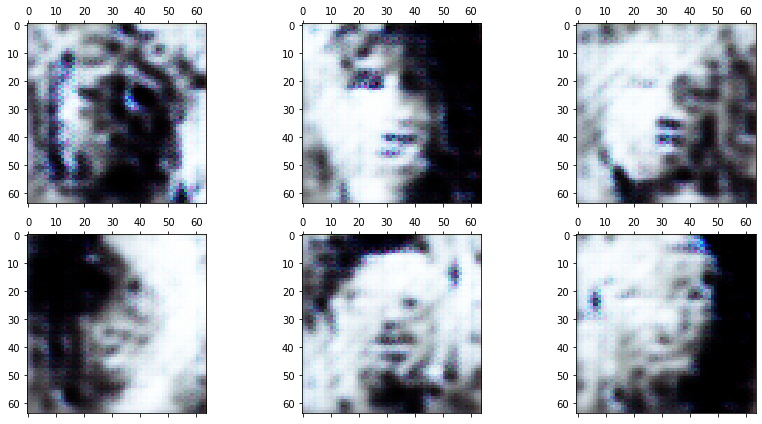

Epoch 1282/2000
1/1 [==============================] - 1s 641ms/step
Epoch 1283/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1284/2000
1/1 [==============================] - 1s 589ms/step
Epoch 1285/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1286/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1287/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1288/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1289/2000
1/1 [==============================] - 1s 603ms/step
Epoch 1290/2000
1/1 [==============================] - 1s 596ms/step
Epoch 1291/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1292/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1293/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1294/2000
1/1 [==============================] - 1s 596ms/step
Epoch 1295/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1296/2000
1/1 [=============

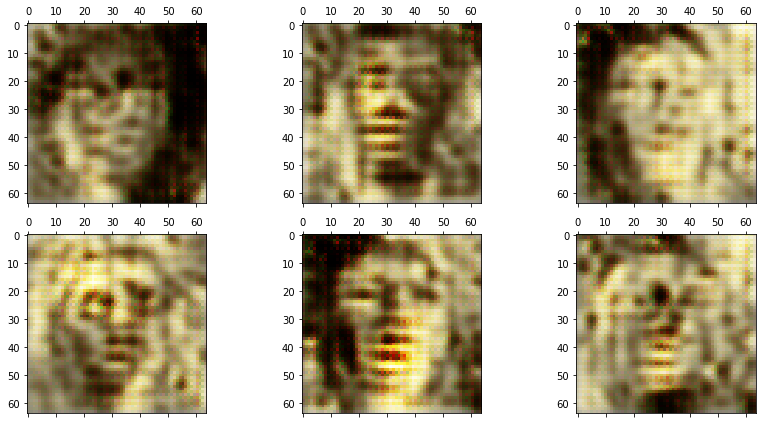

Epoch 1302/2000
1/1 [==============================] - 1s 604ms/step
Epoch 1303/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1304/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1305/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1306/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1307/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1308/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1309/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1310/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1311/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1312/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1313/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1314/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1315/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1316/2000
1/1 [=============

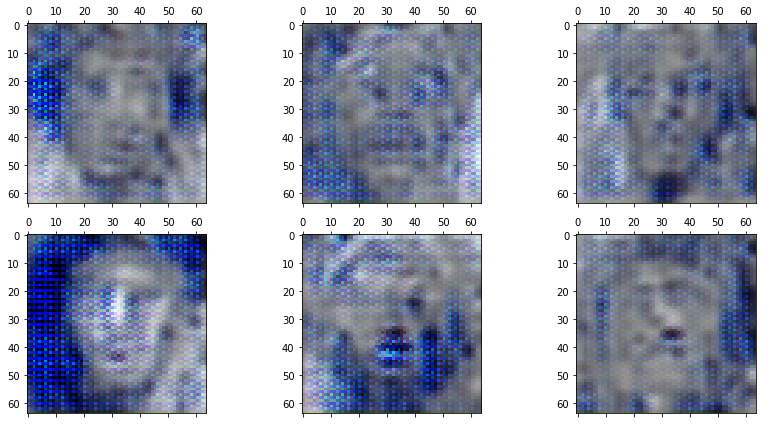

Epoch 1322/2000
1/1 [==============================] - 1s 614ms/step
Epoch 1323/2000
1/1 [==============================] - 1s 590ms/step
Epoch 1324/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1325/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1326/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1327/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1328/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1329/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1330/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1331/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1332/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1333/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1334/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1335/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1336/2000
1/1 [=============

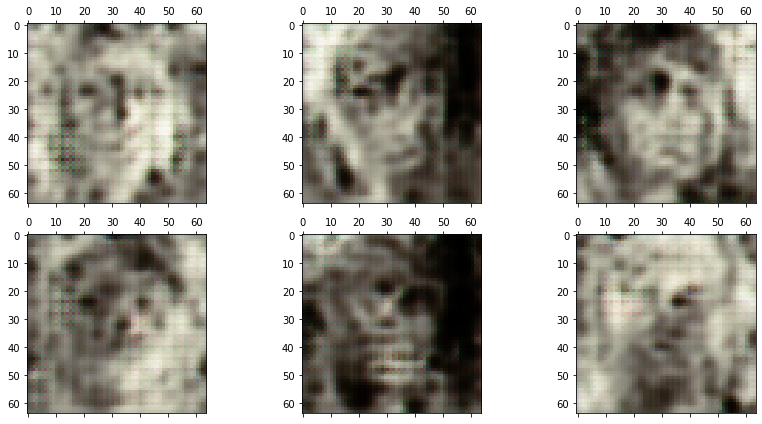

Epoch 1342/2000
1/1 [==============================] - 1s 635ms/step
Epoch 1343/2000
1/1 [==============================] - 1s 689ms/step
Epoch 1344/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1345/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1346/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1347/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1348/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1349/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1350/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1351/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1352/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1353/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1354/2000
1/1 [==============================] - 1s 639ms/step
Epoch 1355/2000
1/1 [==============================] - 1s 641ms/step
Epoch 1356/2000
1/1 [=============

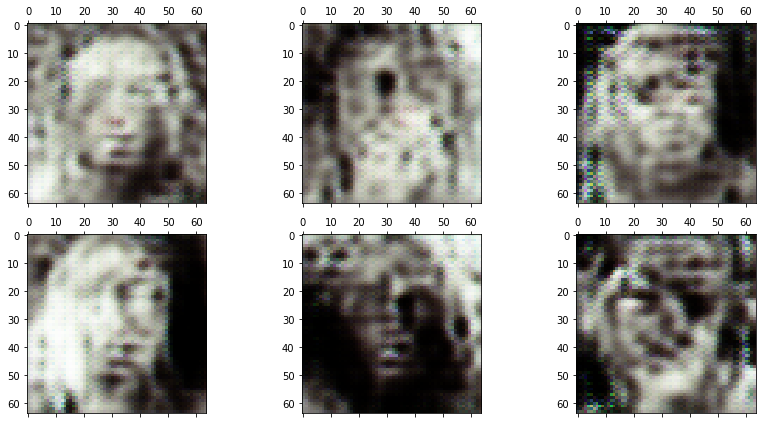

Epoch 1362/2000
1/1 [==============================] - 1s 662ms/step
Epoch 1363/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1364/2000
1/1 [==============================] - 1s 611ms/step
Epoch 1365/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1366/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1367/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1368/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1369/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1370/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1371/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1372/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1373/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1374/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1375/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1376/2000
1/1 [=============

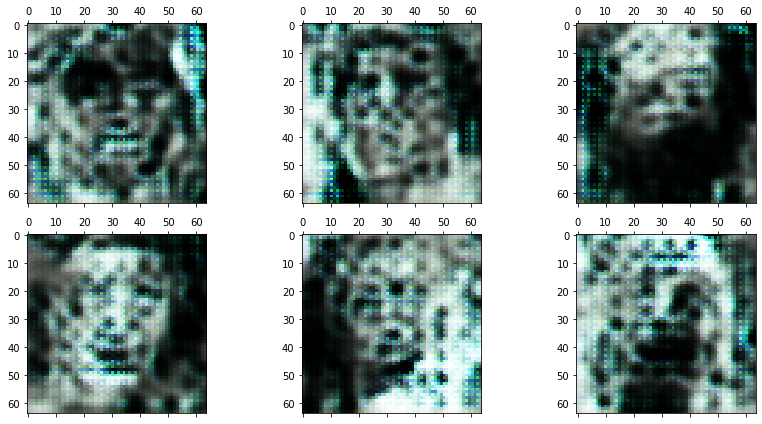

Epoch 1382/2000
1/1 [==============================] - 1s 642ms/step
Epoch 1383/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1384/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1385/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1386/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1387/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1388/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1389/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1390/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1391/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1392/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1393/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1394/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1395/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1396/2000
1/1 [=============

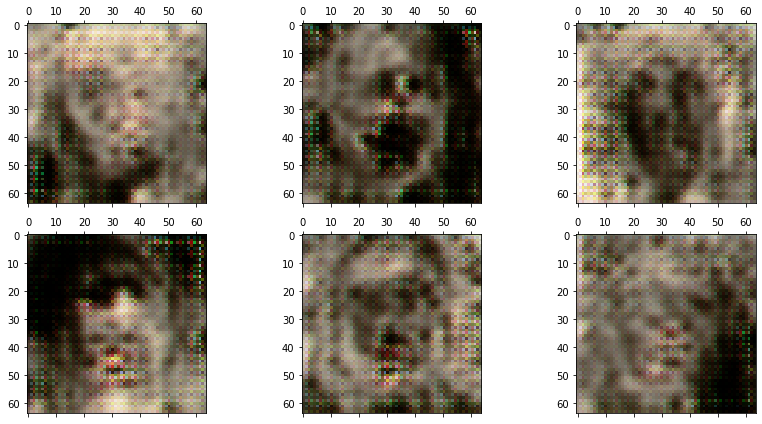

Epoch 1402/2000
1/1 [==============================] - 1s 634ms/step
Epoch 1403/2000
1/1 [==============================] - 1s 591ms/step
Epoch 1404/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1405/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1406/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1407/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1408/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1409/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1410/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1411/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1412/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1413/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1414/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1415/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1416/2000
1/1 [=============

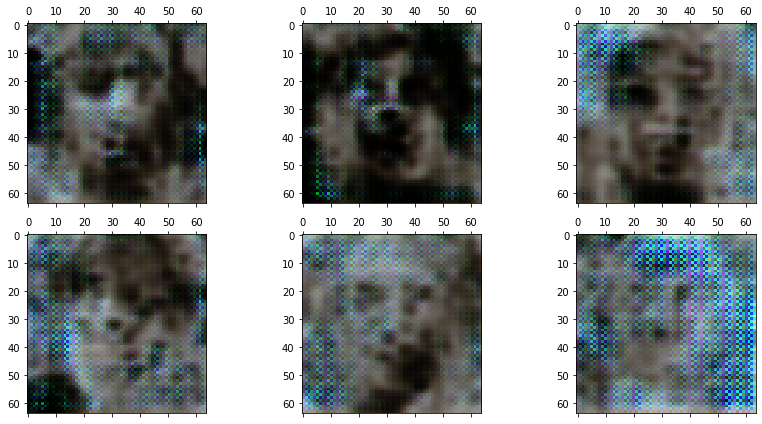

Epoch 1422/2000
1/1 [==============================] - 1s 635ms/step
Epoch 1423/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1424/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1425/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1426/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1427/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1428/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1429/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1430/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1431/2000
1/1 [==============================] - 1s 608ms/step
Epoch 1432/2000
1/1 [==============================] - 1s 606ms/step
Epoch 1433/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1434/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1435/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1436/2000
1/1 [=============

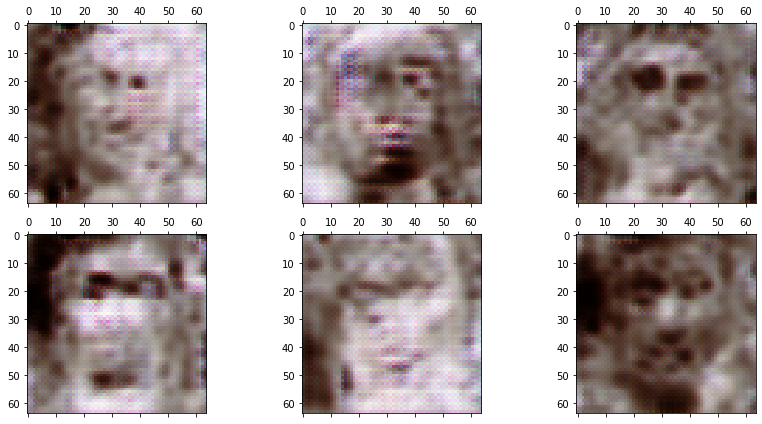

Epoch 1442/2000
1/1 [==============================] - 1s 605ms/step
Epoch 1443/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1444/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1445/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1446/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1447/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1448/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1449/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1450/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1451/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1452/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1453/2000
1/1 [==============================] - 1s 575ms/step
Epoch 1454/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1455/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1456/2000
1/1 [=============

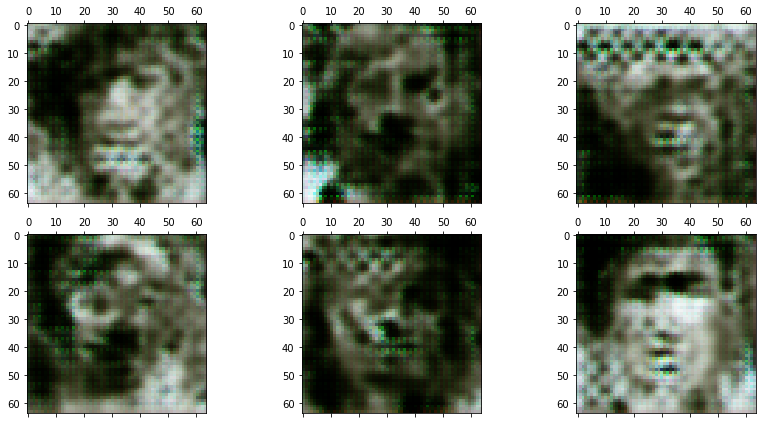

Epoch 1462/2000
1/1 [==============================] - 1s 607ms/step
Epoch 1463/2000
1/1 [==============================] - 1s 644ms/step
Epoch 1464/2000
1/1 [==============================] - 1s 598ms/step
Epoch 1465/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1466/2000
1/1 [==============================] - 1s 588ms/step
Epoch 1467/2000
1/1 [==============================] - 1s 587ms/step
Epoch 1468/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1469/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1470/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1471/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1472/2000
1/1 [==============================] - 1s 594ms/step
Epoch 1473/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1474/2000
1/1 [==============================] - 1s 585ms/step
Epoch 1475/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1476/2000
1/1 [=============

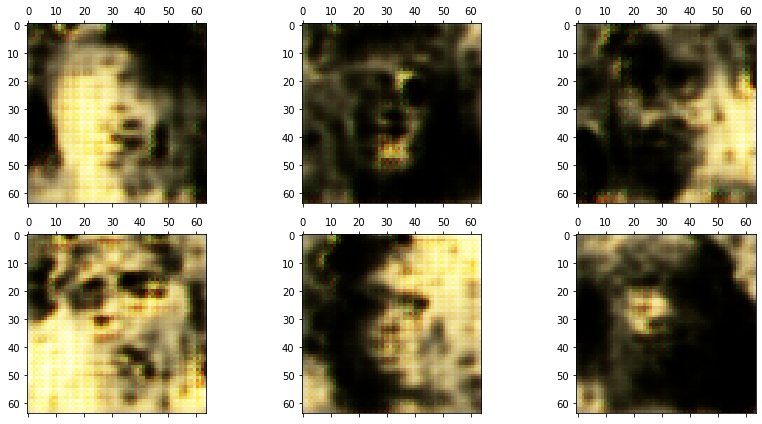

Epoch 1482/2000
1/1 [==============================] - 1s 668ms/step
Epoch 1483/2000
1/1 [==============================] - 1s 623ms/step
Epoch 1484/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1485/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1486/2000
1/1 [==============================] - 1s 582ms/step
Epoch 1487/2000
1/1 [==============================] - 1s 589ms/step
Epoch 1488/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1489/2000
1/1 [==============================] - 1s 579ms/step
Epoch 1490/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1491/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1492/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1493/2000
1/1 [==============================] - 1s 661ms/step
Epoch 1494/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1495/2000
1/1 [==============================] - 1s 592ms/step
Epoch 1496/2000
1/1 [=============

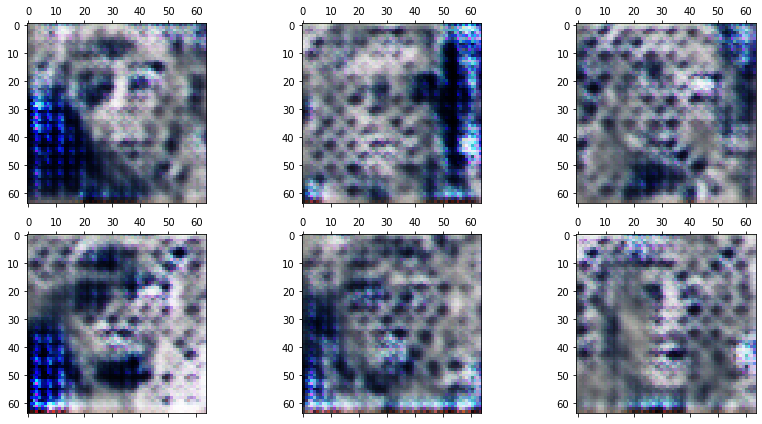

Epoch 1502/2000
1/1 [==============================] - 1s 612ms/step
Epoch 1503/2000
1/1 [==============================] - 1s 586ms/step
Epoch 1504/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1505/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1506/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1507/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1508/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1509/2000
1/1 [==============================] - 1s 571ms/step
Epoch 1510/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1511/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1512/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1513/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1514/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1515/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1516/2000
1/1 [=============

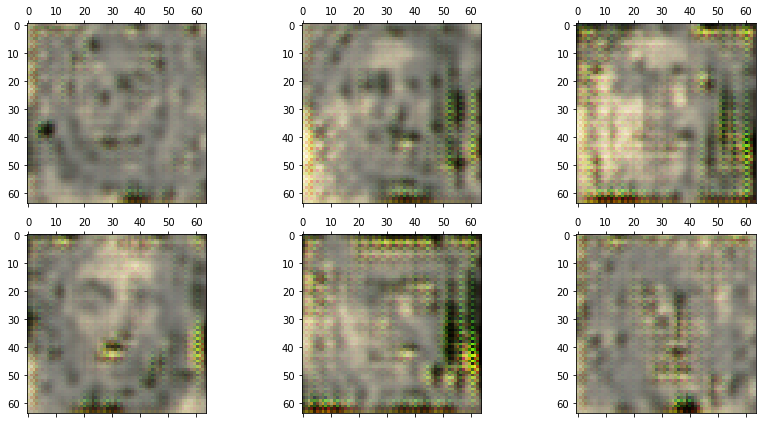

Epoch 1522/2000
1/1 [==============================] - 1s 632ms/step
Epoch 1523/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1524/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1525/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1526/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1527/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1528/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1529/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1530/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1531/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1532/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1533/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1534/2000
1/1 [==============================] - 1s 568ms/step
Epoch 1535/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1536/2000
1/1 [=============

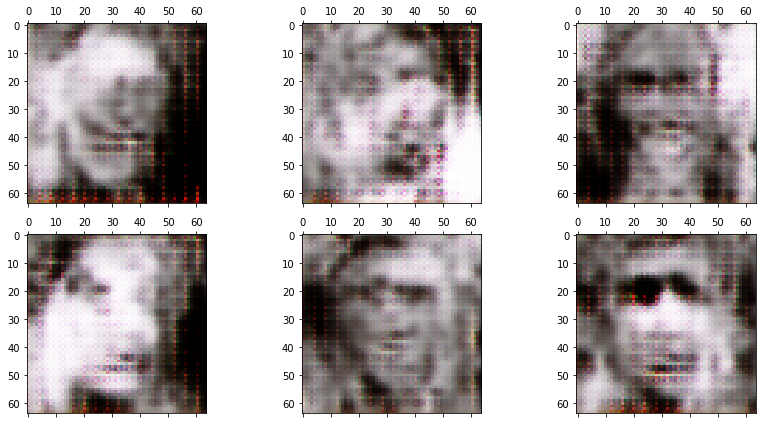

Epoch 1542/2000
1/1 [==============================] - 1s 645ms/step
Epoch 1543/2000
1/1 [==============================] - 1s 594ms/step
Epoch 1544/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1545/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1546/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1547/2000
1/1 [==============================] - 1s 581ms/step
Epoch 1548/2000
1/1 [==============================] - 1s 578ms/step
Epoch 1549/2000
1/1 [==============================] - 1s 609ms/step
Epoch 1550/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1551/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1552/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1553/2000
1/1 [==============================] - 1s 572ms/step
Epoch 1554/2000
1/1 [==============================] - 1s 577ms/step
Epoch 1555/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1556/2000
1/1 [=============

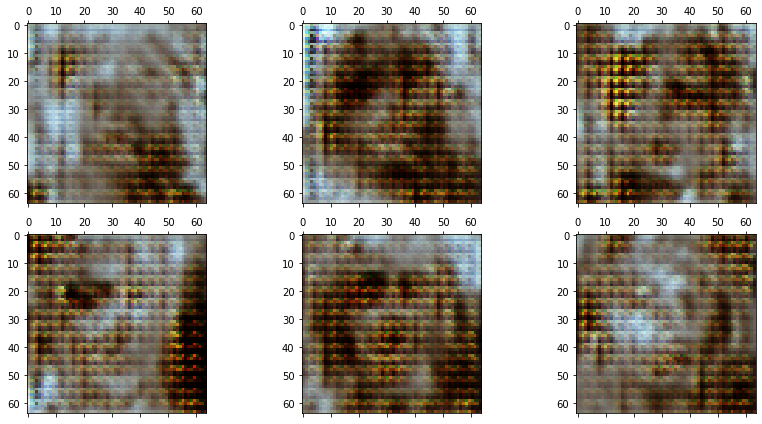

Epoch 1562/2000
1/1 [==============================] - 1s 699ms/step
Epoch 1563/2000
1/1 [==============================] - 1s 583ms/step
Epoch 1564/2000
1/1 [==============================] - 1s 574ms/step
Epoch 1565/2000
1/1 [==============================] - 1s 551ms/step
Epoch 1566/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1567/2000
1/1 [==============================] - 1s 549ms/step
Epoch 1568/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1569/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1570/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1571/2000
1/1 [==============================] - 1s 541ms/step
Epoch 1572/2000
1/1 [==============================] - 1s 519ms/step
Epoch 1573/2000
1/1 [==============================] - 1s 576ms/step
Epoch 1574/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1575/2000
1/1 [==============================] - 1s 543ms/step
Epoch 1576/2000
1/1 [=============

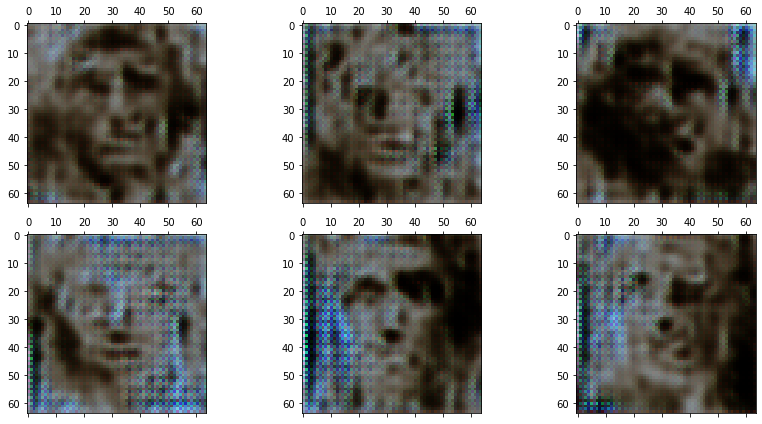

Epoch 1582/2000
1/1 [==============================] - 1s 607ms/step
Epoch 1583/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1584/2000
1/1 [==============================] - 1s 554ms/step
Epoch 1585/2000
1/1 [==============================] - 1s 536ms/step
Epoch 1586/2000
1/1 [==============================] - 1s 552ms/step
Epoch 1587/2000
1/1 [==============================] - 1s 548ms/step
Epoch 1588/2000
1/1 [==============================] - 1s 569ms/step
Epoch 1589/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1590/2000
1/1 [==============================] - 1s 539ms/step
Epoch 1591/2000
1/1 [==============================] - 1s 545ms/step
Epoch 1592/2000
1/1 [==============================] - 1s 542ms/step
Epoch 1593/2000
1/1 [==============================] - 1s 549ms/step
Epoch 1594/2000
1/1 [==============================] - 1s 545ms/step
Epoch 1595/2000
1/1 [==============================] - 1s 547ms/step
Epoch 1596/2000
1/1 [=============

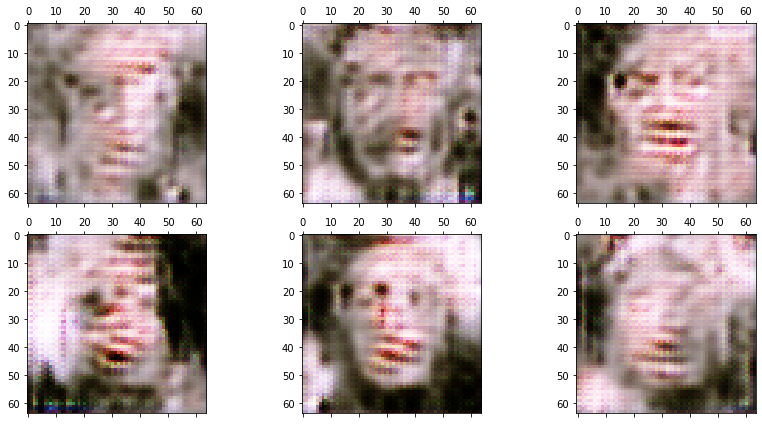

Epoch 1602/2000
1/1 [==============================] - 1s 632ms/step
Epoch 1603/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1604/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1605/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1606/2000
1/1 [==============================] - 1s 550ms/step
Epoch 1607/2000
1/1 [==============================] - 1s 548ms/step
Epoch 1608/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1609/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1610/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1611/2000
1/1 [==============================] - 1s 551ms/step
Epoch 1612/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1613/2000
1/1 [==============================] - 1s 539ms/step
Epoch 1614/2000
1/1 [==============================] - 1s 550ms/step
Epoch 1615/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1616/2000
1/1 [=============

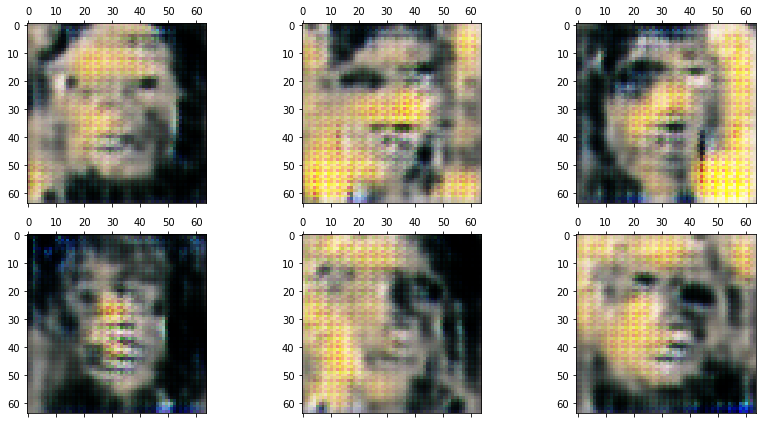

Epoch 1622/2000
1/1 [==============================] - 1s 617ms/step
Epoch 1623/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1624/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1625/2000
1/1 [==============================] - 1s 543ms/step
Epoch 1626/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1627/2000
1/1 [==============================] - 1s 554ms/step
Epoch 1628/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1629/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1630/2000
1/1 [==============================] - 1s 547ms/step
Epoch 1631/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1632/2000
1/1 [==============================] - 1s 540ms/step
Epoch 1633/2000
1/1 [==============================] - 1s 545ms/step
Epoch 1634/2000
1/1 [==============================] - 1s 550ms/step
Epoch 1635/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1636/2000
1/1 [=============

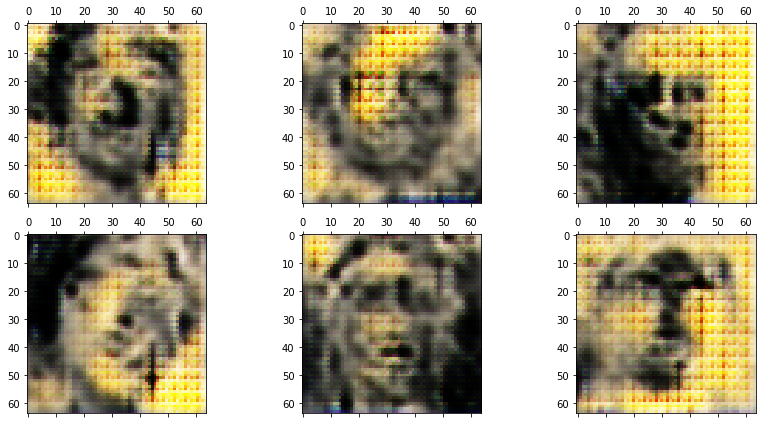

Epoch 1642/2000
1/1 [==============================] - 1s 604ms/step
Epoch 1643/2000
1/1 [==============================] - 1s 554ms/step
Epoch 1644/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1645/2000
1/1 [==============================] - 1s 545ms/step
Epoch 1646/2000
1/1 [==============================] - 1s 584ms/step
Epoch 1647/2000
1/1 [==============================] - 1s 573ms/step
Epoch 1648/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1649/2000
1/1 [==============================] - 1s 552ms/step
Epoch 1650/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1651/2000
1/1 [==============================] - 1s 552ms/step
Epoch 1652/2000
1/1 [==============================] - 1s 544ms/step
Epoch 1653/2000
1/1 [==============================] - 1s 551ms/step
Epoch 1654/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1655/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1656/2000
1/1 [=============

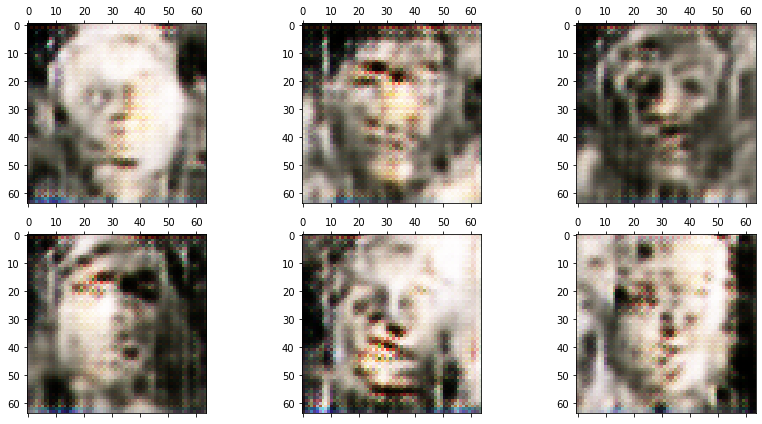

Epoch 1662/2000
1/1 [==============================] - 1s 624ms/step
Epoch 1663/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1664/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1665/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1666/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1667/2000
1/1 [==============================] - 1s 570ms/step
Epoch 1668/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1669/2000
1/1 [==============================] - 1s 557ms/step
Epoch 1670/2000
1/1 [==============================] - 1s 554ms/step
Epoch 1671/2000
1/1 [==============================] - 1s 551ms/step
Epoch 1672/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1673/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1674/2000
1/1 [==============================] - 1s 559ms/step
Epoch 1675/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1676/2000
1/1 [=============

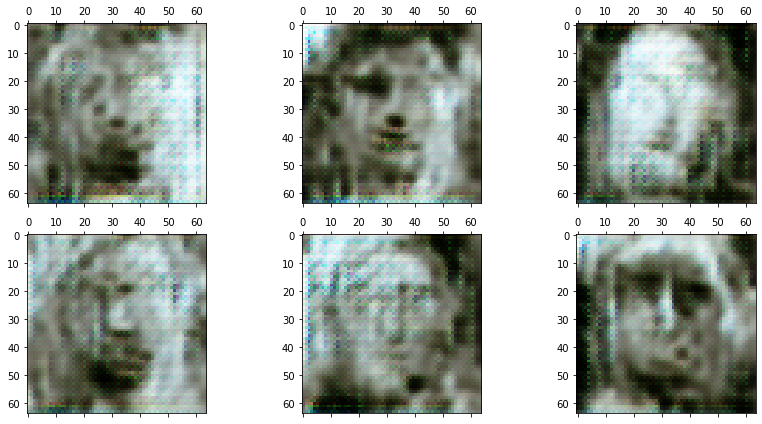

Epoch 1682/2000
1/1 [==============================] - 1s 549ms/step
Epoch 1683/2000
1/1 [==============================] - 1s 565ms/step
Epoch 1684/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1685/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1686/2000
1/1 [==============================] - 1s 564ms/step
Epoch 1687/2000
1/1 [==============================] - 1s 562ms/step
Epoch 1688/2000
1/1 [==============================] - 1s 551ms/step
Epoch 1689/2000
1/1 [==============================] - 1s 555ms/step
Epoch 1690/2000
1/1 [==============================] - 1s 566ms/step
Epoch 1691/2000
1/1 [==============================] - 1s 560ms/step
Epoch 1692/2000
1/1 [==============================] - 1s 561ms/step
Epoch 1693/2000
1/1 [==============================] - 1s 552ms/step
Epoch 1694/2000
1/1 [==============================] - 1s 563ms/step
Epoch 1695/2000
1/1 [==============================] - 1s 552ms/step
Epoch 1696/2000
1/1 [=============

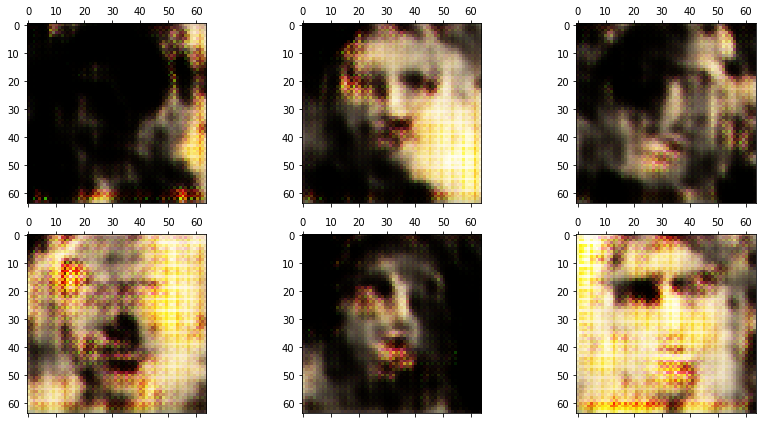

Epoch 1702/2000
1/1 [==============================] - 1s 657ms/step
Epoch 1703/2000
1/1 [==============================] - 1s 556ms/step
Epoch 1704/2000
1/1 [==============================] - 1s 580ms/step
Epoch 1705/2000
1/1 [==============================] - 1s 558ms/step
Epoch 1706/2000
1/1 [==============================] - 1s 557ms/step
Epoch 1707/2000
1/1 [==============================] - 1s 695ms/step
Epoch 1708/2000
1/1 [==============================] - 1s 567ms/step
Epoch 1709/2000
1/1 [==============================] - 1s 553ms/step
Epoch 1710/2000
1/1 [==============================] - 0s 481ms/step
Epoch 1711/2000
1/1 [==============================] - 0s 450ms/step
Epoch 1712/2000
1/1 [==============================] - 1s 505ms/step
Epoch 1713/2000
1/1 [==============================] - 0s 450ms/step
Epoch 1714/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1715/2000
1/1 [==============================] - 0s 431ms/step
Epoch 1716/2000
1/1 [=============

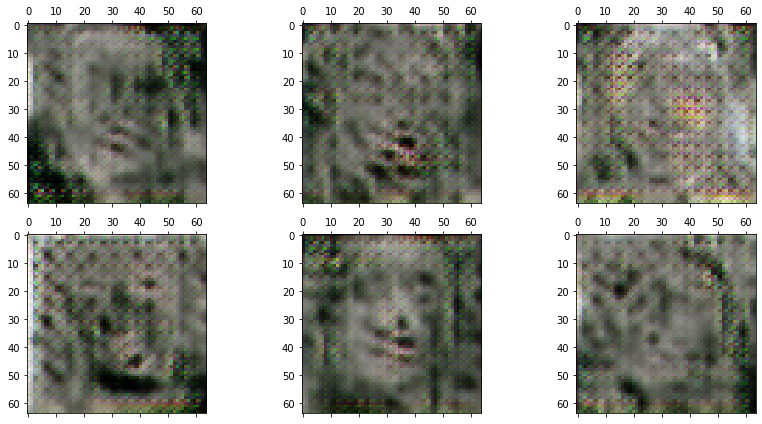

Epoch 1722/2000
1/1 [==============================] - 1s 512ms/step
Epoch 1723/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1724/2000
1/1 [==============================] - 0s 432ms/step
Epoch 1725/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1726/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1727/2000
1/1 [==============================] - 0s 447ms/step
Epoch 1728/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1729/2000
1/1 [==============================] - 0s 446ms/step
Epoch 1730/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1731/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1732/2000
1/1 [==============================] - 0s 447ms/step
Epoch 1733/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1734/2000
1/1 [==============================] - 1s 514ms/step
Epoch 1735/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1736/2000
1/1 [=============

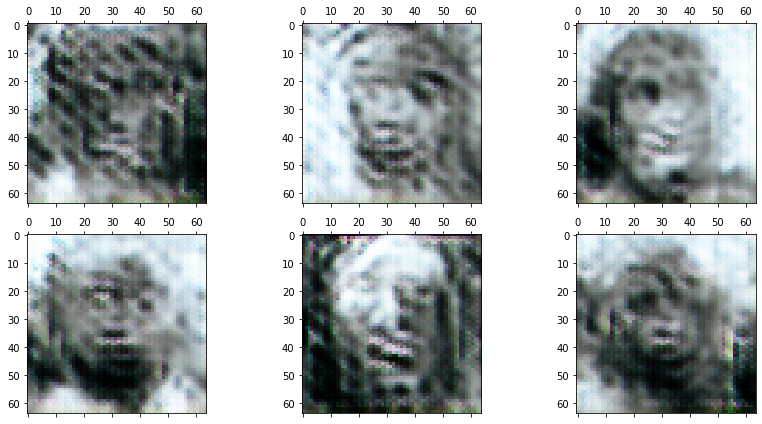

Epoch 1742/2000
1/1 [==============================] - 0s 478ms/step
Epoch 1743/2000
1/1 [==============================] - 0s 453ms/step
Epoch 1744/2000
1/1 [==============================] - 0s 445ms/step
Epoch 1745/2000
1/1 [==============================] - 0s 463ms/step
Epoch 1746/2000
1/1 [==============================] - 0s 468ms/step
Epoch 1747/2000
1/1 [==============================] - 0s 447ms/step
Epoch 1748/2000
1/1 [==============================] - 937s 937s/step
Epoch 1749/2000
1/1 [==============================] - 0s 469ms/step
Epoch 1750/2000
1/1 [==============================] - 0s 460ms/step
Epoch 1751/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1752/2000
1/1 [==============================] - 0s 454ms/step
Epoch 1753/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1754/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1755/2000
1/1 [==============================] - 0s 456ms/step
Epoch 1756/2000
1/1 [============

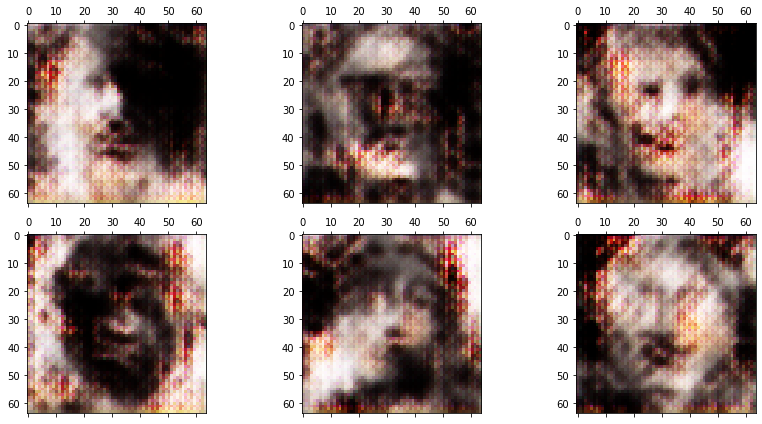

Epoch 1762/2000
1/1 [==============================] - 1s 521ms/step
Epoch 1763/2000
1/1 [==============================] - 0s 446ms/step
Epoch 1764/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1765/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1766/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1767/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1768/2000
1/1 [==============================] - 0s 451ms/step
Epoch 1769/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1770/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1771/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1772/2000
1/1 [==============================] - 0s 461ms/step
Epoch 1773/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1774/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1775/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1776/2000
1/1 [=============

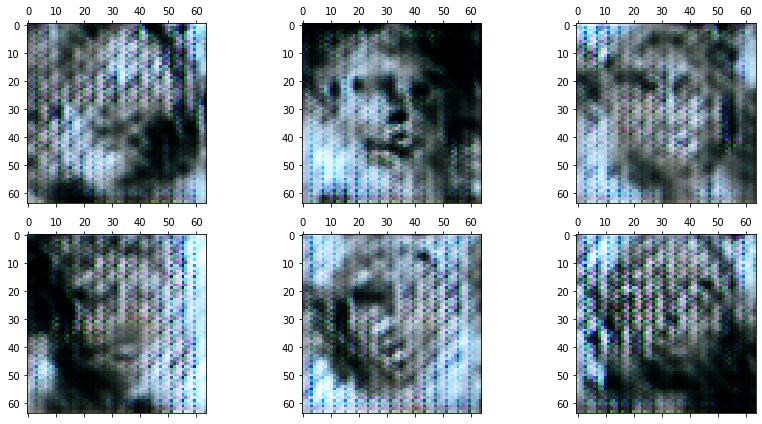

Epoch 1782/2000
1/1 [==============================] - 1s 509ms/step
Epoch 1783/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1784/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1785/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1786/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1787/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1788/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1789/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1790/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1791/2000
1/1 [==============================] - 0s 447ms/step
Epoch 1792/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1793/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1794/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1795/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1796/2000
1/1 [=============

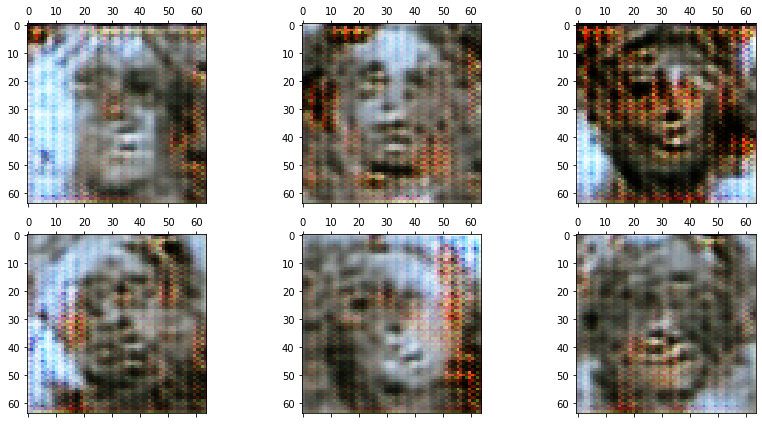

Epoch 1802/2000
1/1 [==============================] - 0s 492ms/step
Epoch 1803/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1804/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1805/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1806/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1807/2000
1/1 [==============================] - 0s 490ms/step
Epoch 1808/2000
1/1 [==============================] - 0s 455ms/step
Epoch 1809/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1810/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1811/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1812/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1813/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1814/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1815/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1816/2000
1/1 [=============

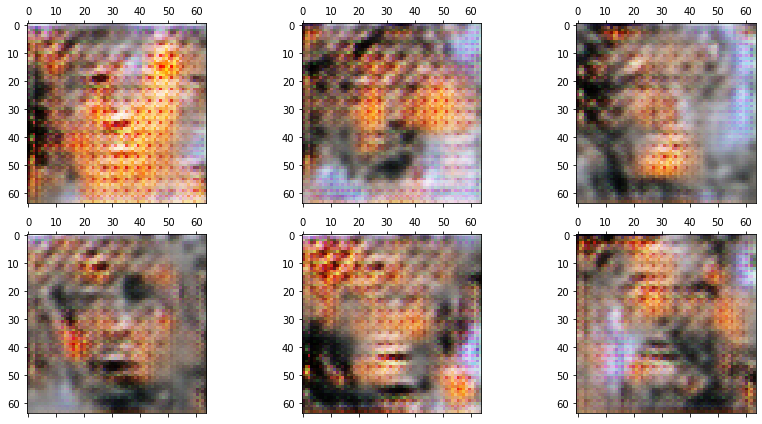

Epoch 1822/2000
1/1 [==============================] - 1s 504ms/step
Epoch 1823/2000
1/1 [==============================] - 0s 445ms/step
Epoch 1824/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1825/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1826/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1827/2000
1/1 [==============================] - 0s 452ms/step
Epoch 1828/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1829/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1830/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1831/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1832/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1833/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1834/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1835/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1836/2000
1/1 [=============

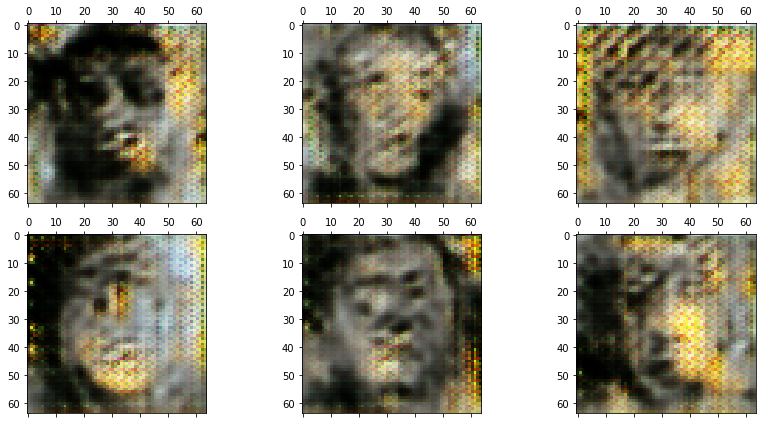

Epoch 1842/2000
1/1 [==============================] - 1s 517ms/step
Epoch 1843/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1844/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1845/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1846/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1847/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1848/2000
1/1 [==============================] - 0s 445ms/step
Epoch 1849/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1850/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1851/2000
1/1 [==============================] - 0s 450ms/step
Epoch 1852/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1853/2000
1/1 [==============================] - 0s 493ms/step
Epoch 1854/2000
1/1 [==============================] - 0s 463ms/step
Epoch 1855/2000
1/1 [==============================] - 0s 455ms/step
Epoch 1856/2000
1/1 [=============

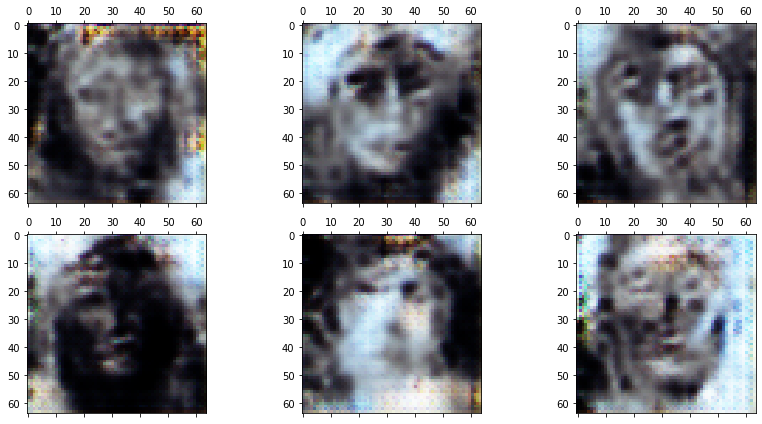

Epoch 1862/2000
1/1 [==============================] - 1s 515ms/step
Epoch 1863/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1864/2000
1/1 [==============================] - 0s 445ms/step
Epoch 1865/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1866/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1867/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1868/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1869/2000
1/1 [==============================] - 0s 445ms/step
Epoch 1870/2000
1/1 [==============================] - 932s 932s/step
Epoch 1871/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1872/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1873/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1874/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1875/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1876/2000
1/1 [============

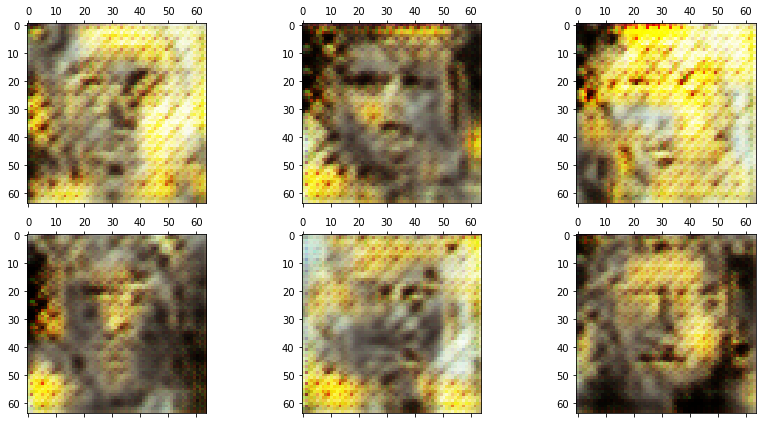

Epoch 1882/2000
1/1 [==============================] - 1s 507ms/step
Epoch 1883/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1884/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1885/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1886/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1887/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1888/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1889/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1890/2000
1/1 [==============================] - 0s 433ms/step
Epoch 1891/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1892/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1893/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1894/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1895/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1896/2000
1/1 [=============

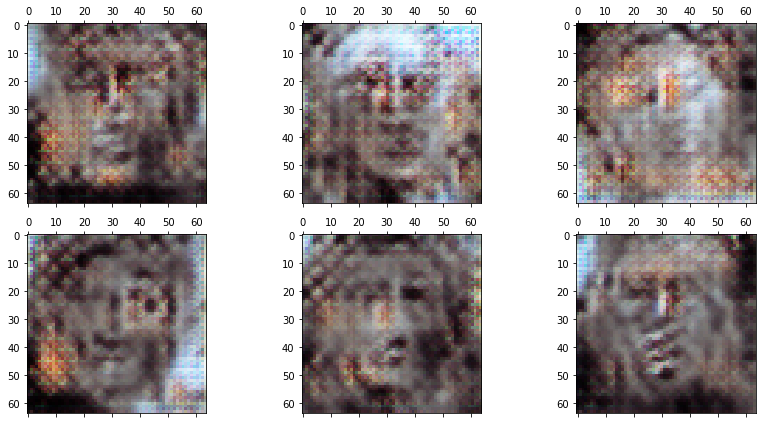

Epoch 1902/2000
1/1 [==============================] - 1s 515ms/step
Epoch 1903/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1904/2000
1/1 [==============================] - 0s 433ms/step
Epoch 1905/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1906/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1907/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1908/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1909/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1910/2000
1/1 [==============================] - 0s 434ms/step
Epoch 1911/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1912/2000
1/1 [==============================] - 0s 449ms/step
Epoch 1913/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1914/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1915/2000
1/1 [==============================] - 0s 451ms/step
Epoch 1916/2000
1/1 [=============

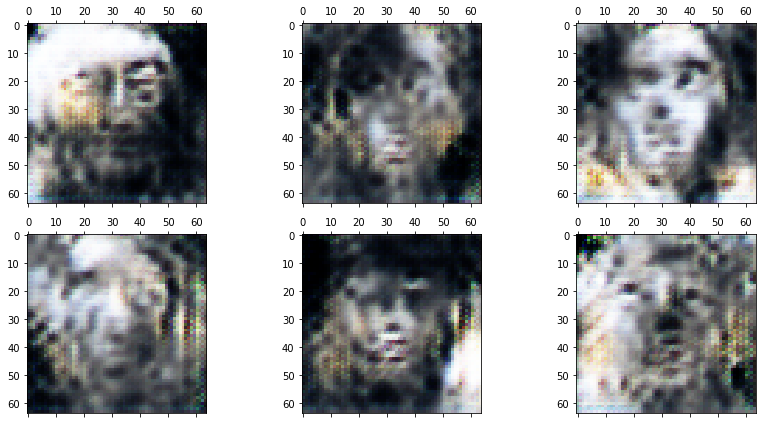

Epoch 1922/2000
1/1 [==============================] - 0s 499ms/step
Epoch 1923/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1924/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1925/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1926/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1927/2000
1/1 [==============================] - 0s 438ms/step
Epoch 1928/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1929/2000
1/1 [==============================] - 0s 446ms/step
Epoch 1930/2000
1/1 [==============================] - 0s 451ms/step
Epoch 1931/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1932/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1933/2000
1/1 [==============================] - 0s 450ms/step
Epoch 1934/2000
1/1 [==============================] - 0s 448ms/step
Epoch 1935/2000
1/1 [==============================] - 1s 505ms/step
Epoch 1936/2000
1/1 [=============

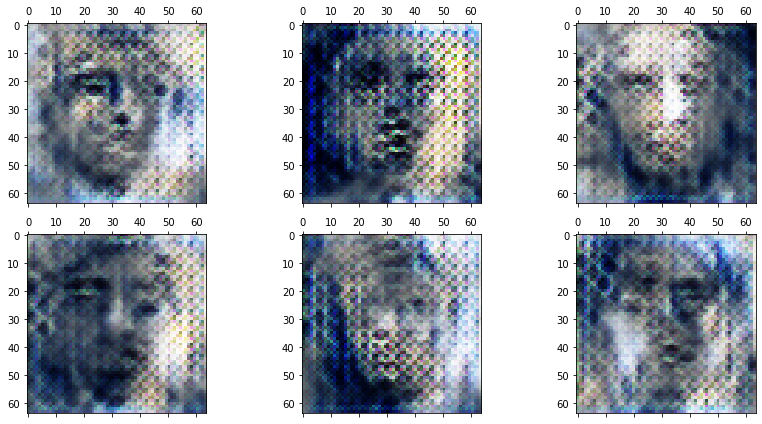

Epoch 1942/2000
1/1 [==============================] - 0s 492ms/step
Epoch 1943/2000
1/1 [==============================] - 0s 442ms/step
Epoch 1944/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1945/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1946/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1947/2000
1/1 [==============================] - 0s 444ms/step
Epoch 1948/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1949/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1950/2000
1/1 [==============================] - 0s 451ms/step
Epoch 1951/2000
1/1 [==============================] - 0s 449ms/step
Epoch 1952/2000
1/1 [==============================] - 0s 459ms/step
Epoch 1953/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1954/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1955/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1956/2000
1/1 [=============

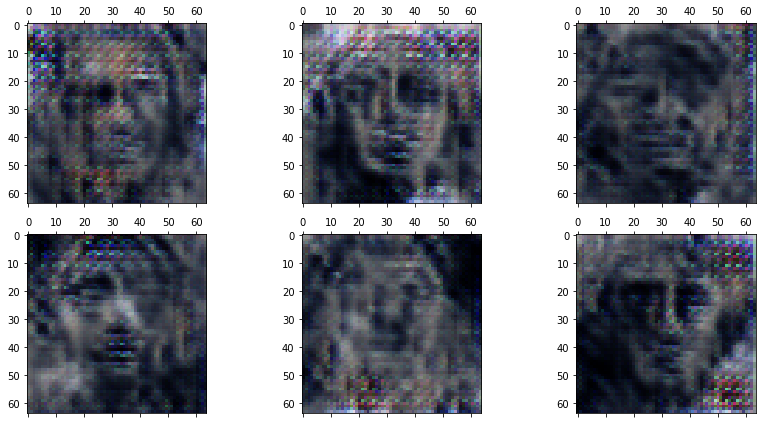

Epoch 1962/2000
1/1 [==============================] - 1s 518ms/step
Epoch 1963/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1964/2000
1/1 [==============================] - 0s 449ms/step
Epoch 1965/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1966/2000
1/1 [==============================] - 0s 458ms/step
Epoch 1967/2000
1/1 [==============================] - 0s 446ms/step
Epoch 1968/2000
1/1 [==============================] - 1015s 1015s/step
Epoch 1969/2000
1/1 [==============================] - 0s 447ms/step
Epoch 1970/2000
1/1 [==============================] - 0s 443ms/step
Epoch 1971/2000
1/1 [==============================] - 0s 451ms/step
Epoch 1972/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1973/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1974/2000
1/1 [==============================] - 0s 436ms/step
Epoch 1975/2000
1/1 [==============================] - 0s 435ms/step
Epoch 1976/2000
1/1 [==========

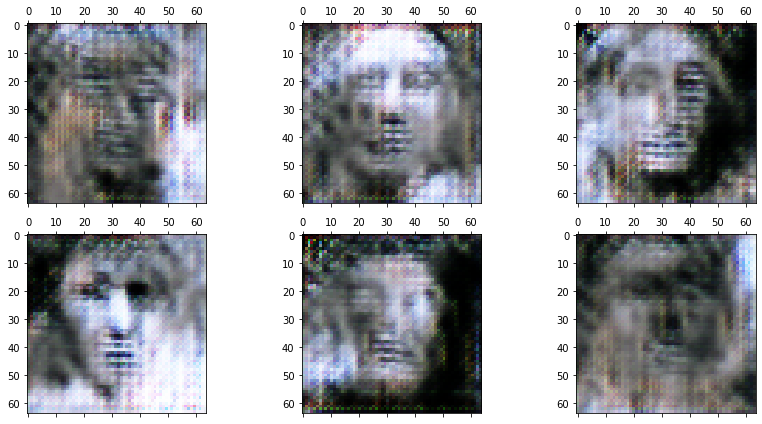

Epoch 1982/2000
1/1 [==============================] - 0s 463ms/step
Epoch 1983/2000
1/1 [==============================] - 0s 439ms/step
Epoch 1984/2000
1/1 [==============================] - 0s 441ms/step
Epoch 1985/2000
1/1 [==============================] - 0s 464ms/step
Epoch 1986/2000
1/1 [==============================] - 0s 449ms/step
Epoch 1987/2000
1/1 [==============================] - 0s 461ms/step
Epoch 1988/2000
1/1 [==============================] - 0s 464ms/step
Epoch 1989/2000
1/1 [==============================] - 0s 456ms/step
Epoch 1990/2000
1/1 [==============================] - 0s 433ms/step
Epoch 1991/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1992/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1993/2000
1/1 [==============================] - 0s 440ms/step
Epoch 1994/2000
1/1 [==============================] - 0s 437ms/step
Epoch 1995/2000
1/1 [==============================] - 0s 465ms/step
Epoch 1996/2000
1/1 [=============

In [63]:
# Train DCGAN model
train(gen_model, dis_model, gan_model, data, latent_dim, n_eval=20)

In [64]:
gen_model.save('gen_model.h5')
dis_model.save('dis_model.h5')
gan_model.save('gan_model.h5')

Epoch 1/1000
1/1 [==============================] - 1s 501ms/step
Epoch number:  0
*** Training ***
Discriminator Loss  0.7332830429077148
Generator Loss:  0.6400668025016785
2/2 [==============================] - 1s 511ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.6000000238418579
Discriminator Accuracy on FAKE (generated) images:  0.07999999821186066


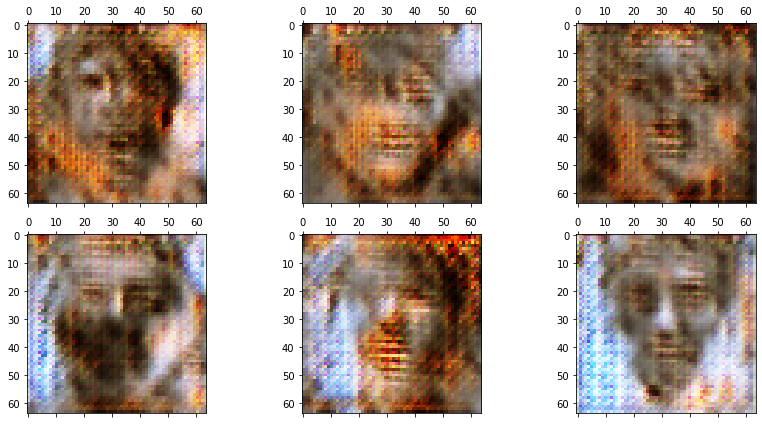

Epoch 2/1000
1/1 [==============================] - 0s 476ms/step
Epoch 3/1000
1/1 [==============================] - 0s 472ms/step
Epoch 4/1000
1/1 [==============================] - 0s 454ms/step
Epoch 5/1000
1/1 [==============================] - 0s 452ms/step
Epoch 6/1000
1/1 [==============================] - 0s 463ms/step
Epoch 7/1000
1/1 [==============================] - 0s 455ms/step
Epoch 8/1000
1/1 [==============================] - 0s 449ms/step
Epoch 9/1000
1/1 [==============================] - 0s 456ms/step
Epoch 10/1000
1/1 [==============================] - 0s 455ms/step
Epoch 11/1000
1/1 [==============================] - 0s 460ms/step
Epoch 12/1000
1/1 [==============================] - 0s 461ms/step
Epoch 13/1000
1/1 [==============================] - 0s 448ms/step
Epoch 14/1000
1/1 [==============================] - 0s 453ms/step
Epoch 15/1000
1/1 [==============================] - 0s 451ms/step
Epoch 16/1000
1/1 [==============================] - 0s 459ms/step
Epo

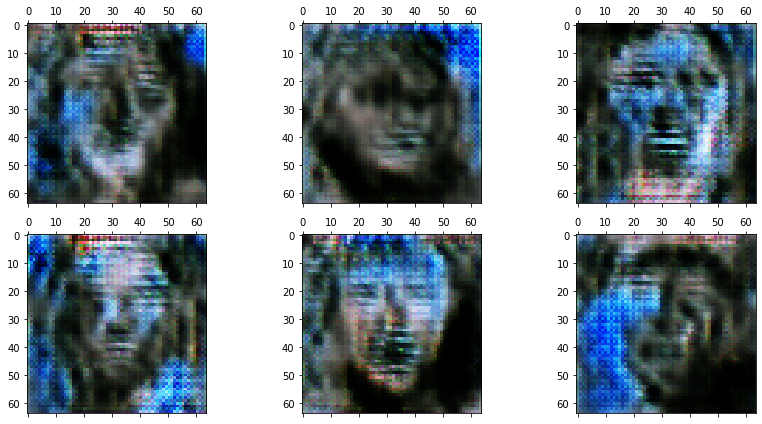

Epoch 22/1000
1/1 [==============================] - 0s 483ms/step
Epoch 23/1000
1/1 [==============================] - 0s 481ms/step
Epoch 24/1000
1/1 [==============================] - 0s 480ms/step
Epoch 25/1000
1/1 [==============================] - 0s 485ms/step
Epoch 26/1000
1/1 [==============================] - 0s 493ms/step
Epoch 27/1000
1/1 [==============================] - 0s 493ms/step
Epoch 28/1000
1/1 [==============================] - 0s 495ms/step
Epoch 29/1000
1/1 [==============================] - 0s 497ms/step
Epoch 30/1000
1/1 [==============================] - 1s 503ms/step
Epoch 31/1000
1/1 [==============================] - 1s 500ms/step
Epoch 32/1000
1/1 [==============================] - 0s 498ms/step
Epoch 33/1000
1/1 [==============================] - 0s 498ms/step
Epoch 34/1000
1/1 [==============================] - 0s 496ms/step
Epoch 35/1000
1/1 [==============================] - 1s 513ms/step
Epoch 36/1000
1/1 [==============================] - 1s 503ms/

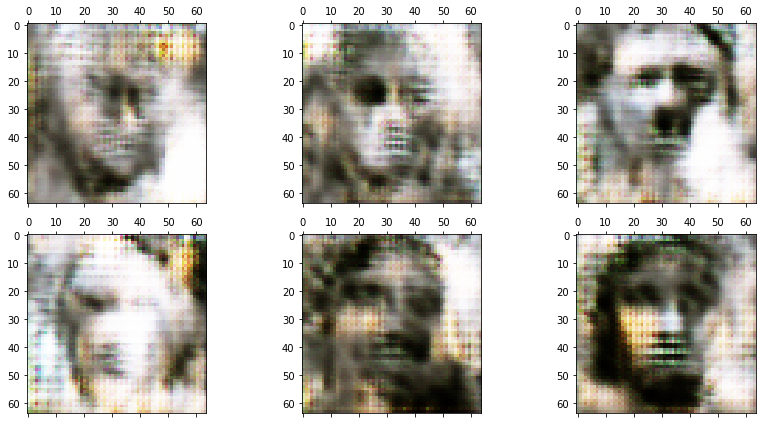

Epoch 42/1000
1/1 [==============================] - 1s 519ms/step
Epoch 43/1000
1/1 [==============================] - 1s 513ms/step
Epoch 44/1000
1/1 [==============================] - 1s 505ms/step
Epoch 45/1000
1/1 [==============================] - 1s 510ms/step
Epoch 46/1000
1/1 [==============================] - 1s 753ms/step
Epoch 47/1000
1/1 [==============================] - 1s 508ms/step
Epoch 48/1000
1/1 [==============================] - 1s 519ms/step
Epoch 49/1000
1/1 [==============================] - 1s 512ms/step
Epoch 50/1000
1/1 [==============================] - 1s 509ms/step
Epoch 51/1000
1/1 [==============================] - 1s 515ms/step
Epoch 52/1000
1/1 [==============================] - 1s 512ms/step
Epoch 53/1000
1/1 [==============================] - 1s 516ms/step
Epoch 54/1000
1/1 [==============================] - 1s 515ms/step
Epoch 55/1000
1/1 [==============================] - 1s 526ms/step
Epoch 56/1000
1/1 [==============================] - 1s 514ms/

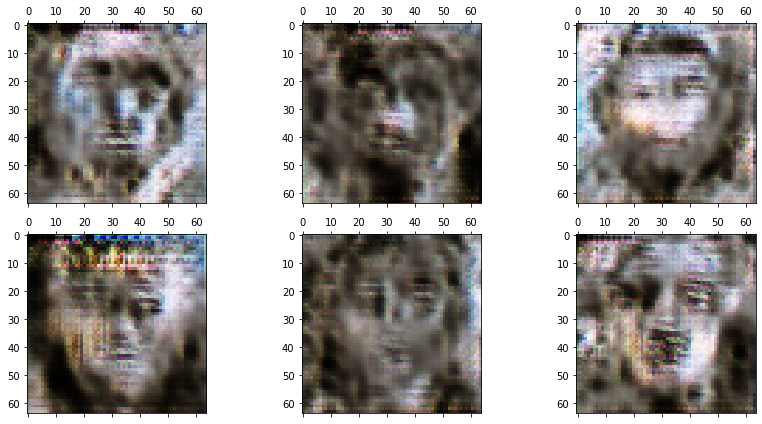

Epoch 62/1000
1/1 [==============================] - 1s 524ms/step
Epoch 63/1000
1/1 [==============================] - 1s 514ms/step
Epoch 64/1000
1/1 [==============================] - 1s 511ms/step
Epoch 65/1000
1/1 [==============================] - 1s 517ms/step
Epoch 66/1000
1/1 [==============================] - 1s 525ms/step
Epoch 67/1000
1/1 [==============================] - 1s 520ms/step
Epoch 68/1000
1/1 [==============================] - 1s 531ms/step
Epoch 69/1000
1/1 [==============================] - 1s 520ms/step
Epoch 70/1000
1/1 [==============================] - 1s 512ms/step
Epoch 71/1000
1/1 [==============================] - 1s 511ms/step
Epoch 72/1000
1/1 [==============================] - 1s 515ms/step
Epoch 73/1000
1/1 [==============================] - 1s 522ms/step
Epoch 74/1000
1/1 [==============================] - 1s 523ms/step
Epoch 75/1000
1/1 [==============================] - 1s 545ms/step
Epoch 76/1000
1/1 [==============================] - 1s 522ms/

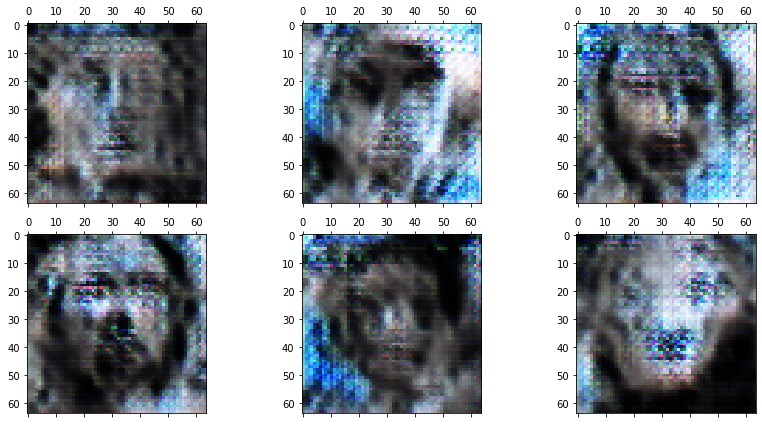

Epoch 82/1000
1/1 [==============================] - 1s 525ms/step
Epoch 83/1000
1/1 [==============================] - 1s 519ms/step
Epoch 84/1000
1/1 [==============================] - 1s 526ms/step
Epoch 85/1000
1/1 [==============================] - 1s 522ms/step
Epoch 86/1000
1/1 [==============================] - 1s 530ms/step
Epoch 87/1000
1/1 [==============================] - 1s 522ms/step
Epoch 88/1000
1/1 [==============================] - 1s 512ms/step
Epoch 89/1000
1/1 [==============================] - 1s 520ms/step
Epoch 90/1000
1/1 [==============================] - 1s 526ms/step
Epoch 91/1000
1/1 [==============================] - 1s 524ms/step
Epoch 92/1000
1/1 [==============================] - 1s 528ms/step
Epoch 93/1000
1/1 [==============================] - 1s 543ms/step
Epoch 94/1000
1/1 [==============================] - 1s 517ms/step
Epoch 95/1000
1/1 [==============================] - 1s 526ms/step
Epoch 96/1000
1/1 [==============================] - 1s 519ms/

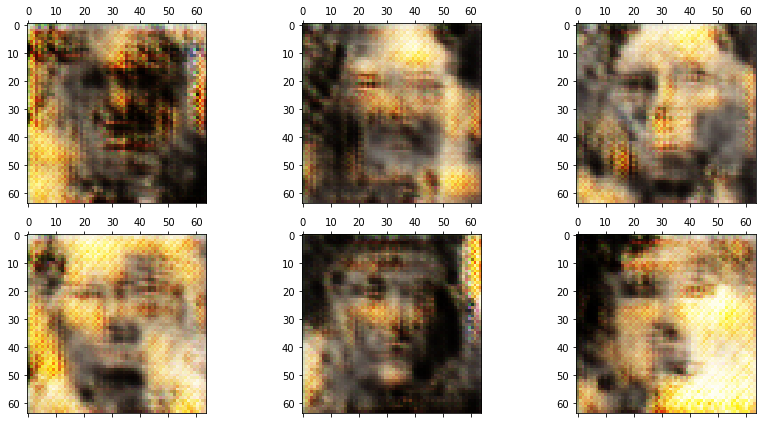

Epoch 102/1000
1/1 [==============================] - 1s 535ms/step
Epoch 103/1000
1/1 [==============================] - 1s 523ms/step
Epoch 104/1000
1/1 [==============================] - 1s 520ms/step
Epoch 105/1000
1/1 [==============================] - 1s 532ms/step
Epoch 106/1000
1/1 [==============================] - 1s 552ms/step
Epoch 107/1000
1/1 [==============================] - 1s 541ms/step
Epoch 108/1000
1/1 [==============================] - 1s 520ms/step
Epoch 109/1000
1/1 [==============================] - 1s 523ms/step
Epoch 110/1000
1/1 [==============================] - 1s 533ms/step
Epoch 111/1000
1/1 [==============================] - 1s 520ms/step
Epoch 112/1000
1/1 [==============================] - 1s 533ms/step
Epoch 113/1000
1/1 [==============================] - 1s 532ms/step
Epoch 114/1000
1/1 [==============================] - 1s 533ms/step
Epoch 115/1000
1/1 [==============================] - 1s 534ms/step
Epoch 116/1000
1/1 [============================

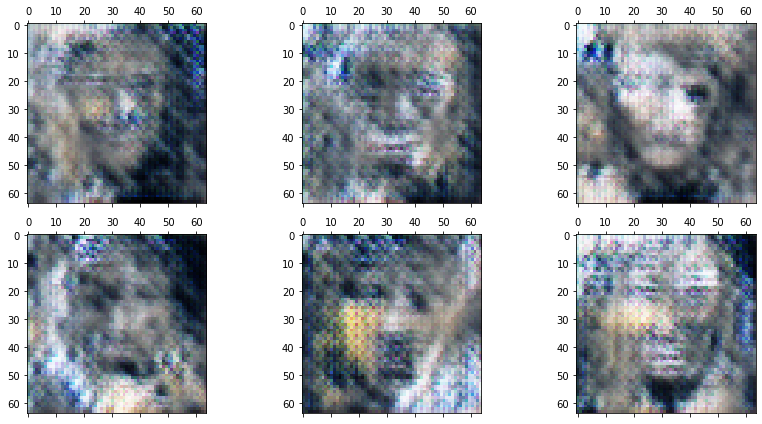

Epoch 122/1000
1/1 [==============================] - 1s 541ms/step
Epoch 123/1000
1/1 [==============================] - 1s 525ms/step
Epoch 124/1000
1/1 [==============================] - 1s 521ms/step
Epoch 125/1000
1/1 [==============================] - 1s 519ms/step
Epoch 126/1000
1/1 [==============================] - 1s 523ms/step
Epoch 127/1000
1/1 [==============================] - 1s 522ms/step
Epoch 128/1000
1/1 [==============================] - 1s 523ms/step
Epoch 129/1000
1/1 [==============================] - 1s 537ms/step
Epoch 130/1000
1/1 [==============================] - 1s 521ms/step
Epoch 131/1000
1/1 [==============================] - 1s 527ms/step
Epoch 132/1000
1/1 [==============================] - 1s 538ms/step
Epoch 133/1000
1/1 [==============================] - 1s 538ms/step
Epoch 134/1000
1/1 [==============================] - 1s 544ms/step
Epoch 135/1000
1/1 [==============================] - 1s 525ms/step
Epoch 136/1000
1/1 [============================

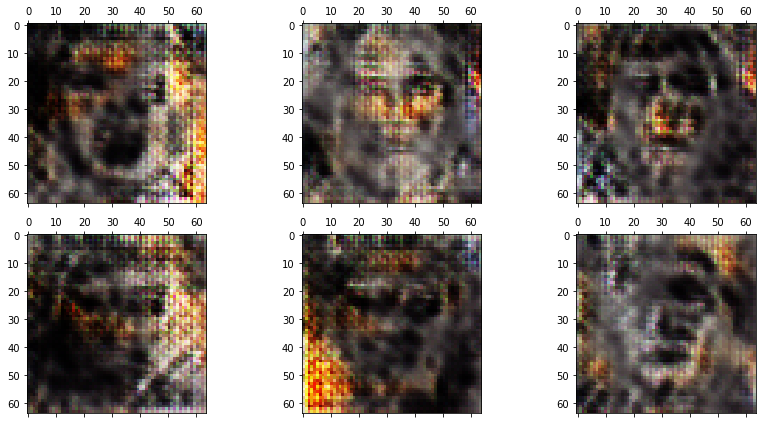

Epoch 142/1000
1/1 [==============================] - 1s 538ms/step
Epoch 143/1000
1/1 [==============================] - 1s 536ms/step
Epoch 144/1000
1/1 [==============================] - 1s 542ms/step
Epoch 145/1000
1/1 [==============================] - 1s 537ms/step
Epoch 146/1000
1/1 [==============================] - 1s 541ms/step
Epoch 147/1000
1/1 [==============================] - 1s 535ms/step
Epoch 148/1000
1/1 [==============================] - 1s 536ms/step
Epoch 149/1000
1/1 [==============================] - 1s 535ms/step
Epoch 150/1000
1/1 [==============================] - 1s 529ms/step
Epoch 151/1000
1/1 [==============================] - 1s 560ms/step
Epoch 152/1000
1/1 [==============================] - 1s 518ms/step
Epoch 153/1000
1/1 [==============================] - 1s 519ms/step
Epoch 154/1000
1/1 [==============================] - 1s 523ms/step
Epoch 155/1000
1/1 [==============================] - 1s 526ms/step
Epoch 156/1000
1/1 [============================

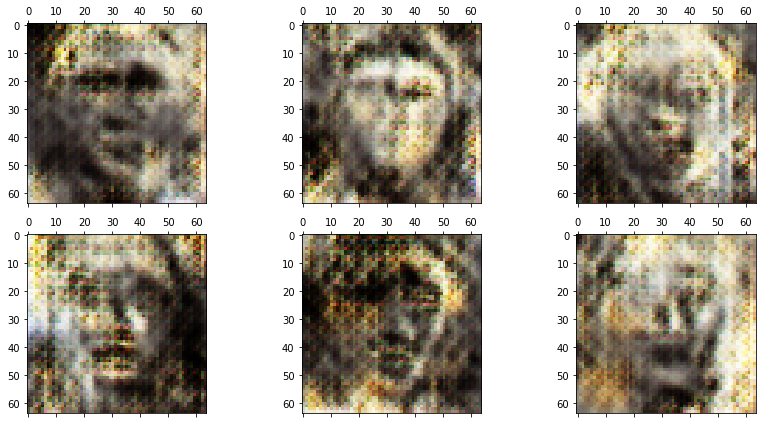

Epoch 162/1000
1/1 [==============================] - 0s 441ms/step
Epoch 163/1000
1/1 [==============================] - 0s 439ms/step
Epoch 164/1000
1/1 [==============================] - 0s 433ms/step
Epoch 165/1000
1/1 [==============================] - 0s 447ms/step
Epoch 166/1000
1/1 [==============================] - 0s 440ms/step
Epoch 167/1000
1/1 [==============================] - 0s 455ms/step
Epoch 168/1000
1/1 [==============================] - 0s 442ms/step
Epoch 169/1000
1/1 [==============================] - 0s 440ms/step
Epoch 170/1000
1/1 [==============================] - 0s 437ms/step
Epoch 171/1000
1/1 [==============================] - 0s 432ms/step
Epoch 172/1000
1/1 [==============================] - 0s 440ms/step
Epoch 173/1000
1/1 [==============================] - 0s 441ms/step
Epoch 174/1000
1/1 [==============================] - 0s 440ms/step
Epoch 175/1000
1/1 [==============================] - 0s 450ms/step
Epoch 176/1000
1/1 [============================

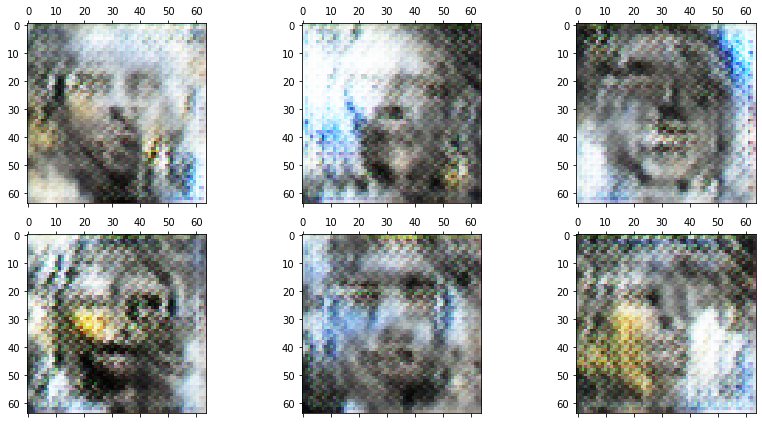

Epoch 182/1000
1/1 [==============================] - 0s 446ms/step
Epoch 183/1000
1/1 [==============================] - 0s 439ms/step
Epoch 184/1000
1/1 [==============================] - 0s 442ms/step
Epoch 185/1000
1/1 [==============================] - 0s 435ms/step
Epoch 186/1000
1/1 [==============================] - 0s 444ms/step
Epoch 187/1000
1/1 [==============================] - 0s 436ms/step
Epoch 188/1000
1/1 [==============================] - 0s 460ms/step
Epoch 189/1000
1/1 [==============================] - 0s 488ms/step
Epoch 190/1000
1/1 [==============================] - 0s 442ms/step
Epoch 191/1000
1/1 [==============================] - 0s 436ms/step
Epoch 192/1000
1/1 [==============================] - 0s 436ms/step
Epoch 193/1000
1/1 [==============================] - 0s 444ms/step
Epoch 194/1000
1/1 [==============================] - 0s 435ms/step
Epoch 195/1000
1/1 [==============================] - 0s 445ms/step
Epoch 196/1000
1/1 [============================

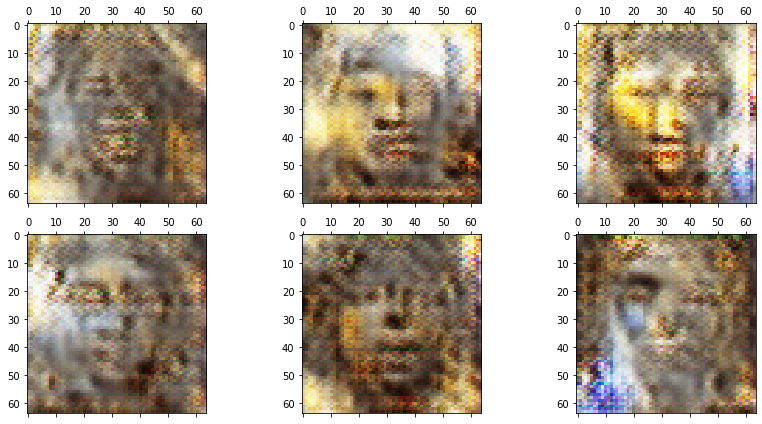

Epoch 202/1000
1/1 [==============================] - 0s 450ms/step
Epoch 203/1000
1/1 [==============================] - 0s 438ms/step
Epoch 204/1000
1/1 [==============================] - 0s 442ms/step
Epoch 205/1000
1/1 [==============================] - 0s 441ms/step
Epoch 206/1000
1/1 [==============================] - 0s 438ms/step
Epoch 207/1000
1/1 [==============================] - 0s 440ms/step
Epoch 208/1000
1/1 [==============================] - 0s 438ms/step
Epoch 209/1000
1/1 [==============================] - 0s 441ms/step
Epoch 210/1000
1/1 [==============================] - 0s 435ms/step
Epoch 211/1000
1/1 [==============================] - 0s 437ms/step
Epoch 212/1000
1/1 [==============================] - 0s 446ms/step
Epoch 213/1000
1/1 [==============================] - 0s 455ms/step
Epoch 214/1000
1/1 [==============================] - 0s 439ms/step
Epoch 215/1000
1/1 [==============================] - 0s 437ms/step
Epoch 216/1000
1/1 [============================

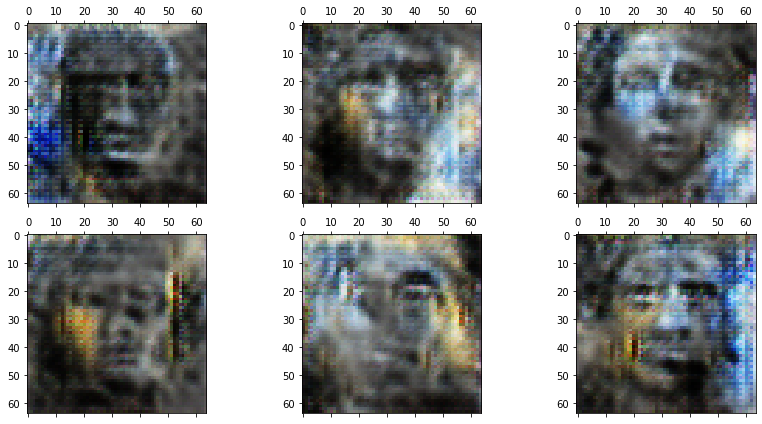

Epoch 222/1000
1/1 [==============================] - 0s 461ms/step
Epoch 223/1000
1/1 [==============================] - 0s 492ms/step
Epoch 224/1000
1/1 [==============================] - 0s 437ms/step
Epoch 225/1000
1/1 [==============================] - 0s 435ms/step
Epoch 226/1000
1/1 [==============================] - 68s 68s/step
Epoch 227/1000
1/1 [==============================] - 1s 513ms/step
Epoch 228/1000
1/1 [==============================] - 0s 472ms/step
Epoch 229/1000
1/1 [==============================] - 0s 477ms/step
Epoch 230/1000
1/1 [==============================] - 1s 515ms/step
Epoch 231/1000
1/1 [==============================] - 0s 479ms/step
Epoch 232/1000
1/1 [==============================] - 0s 480ms/step
Epoch 233/1000
1/1 [==============================] - 0s 457ms/step
Epoch 234/1000
1/1 [==============================] - 1s 509ms/step
Epoch 235/1000
1/1 [==============================] - 0s 487ms/step
Epoch 236/1000
1/1 [=============================

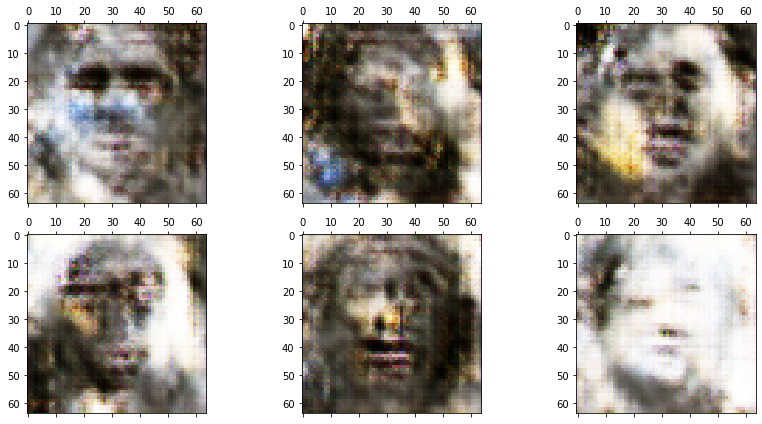

Epoch 242/1000
1/1 [==============================] - 1s 538ms/step
Epoch 243/1000
1/1 [==============================] - 1s 575ms/step
Epoch 244/1000
1/1 [==============================] - 1s 501ms/step
Epoch 245/1000
1/1 [==============================] - 1s 510ms/step
Epoch 246/1000
1/1 [==============================] - 1s 520ms/step
Epoch 247/1000
1/1 [==============================] - 1s 505ms/step
Epoch 248/1000
1/1 [==============================] - 0s 490ms/step
Epoch 249/1000
1/1 [==============================] - 1s 573ms/step
Epoch 250/1000
1/1 [==============================] - 1s 532ms/step
Epoch 251/1000
1/1 [==============================] - 1s 508ms/step
Epoch 252/1000
1/1 [==============================] - 1s 501ms/step
Epoch 253/1000
1/1 [==============================] - 1s 551ms/step
Epoch 254/1000
1/1 [==============================] - 1s 508ms/step
Epoch 255/1000
1/1 [==============================] - 1s 515ms/step
Epoch 256/1000
1/1 [============================

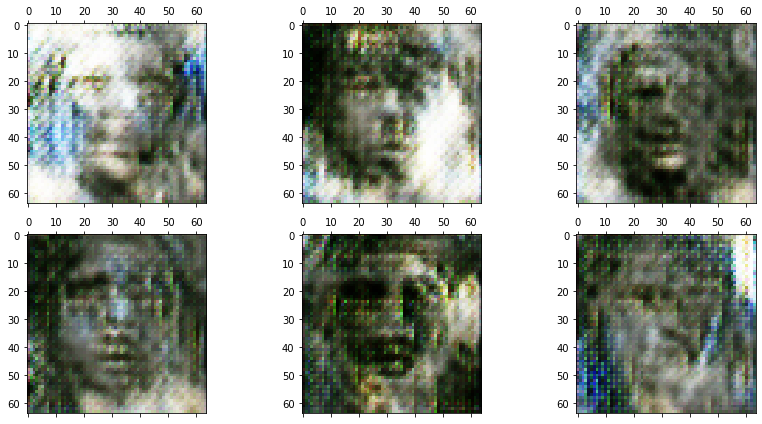

Epoch 262/1000
1/1 [==============================] - 1s 522ms/step
Epoch 263/1000
1/1 [==============================] - 1s 513ms/step
Epoch 264/1000
1/1 [==============================] - 1s 515ms/step
Epoch 265/1000
1/1 [==============================] - 1s 519ms/step
Epoch 266/1000
1/1 [==============================] - 1s 531ms/step
Epoch 267/1000
1/1 [==============================] - 1s 511ms/step
Epoch 268/1000
1/1 [==============================] - 1s 518ms/step
Epoch 269/1000
1/1 [==============================] - 1s 519ms/step
Epoch 270/1000
1/1 [==============================] - 1s 521ms/step
Epoch 271/1000
1/1 [==============================] - 1s 513ms/step
Epoch 272/1000
1/1 [==============================] - 1s 535ms/step
Epoch 273/1000
1/1 [==============================] - 1s 526ms/step
Epoch 274/1000
1/1 [==============================] - 1s 523ms/step
Epoch 275/1000
1/1 [==============================] - 1s 531ms/step
Epoch 276/1000
1/1 [============================

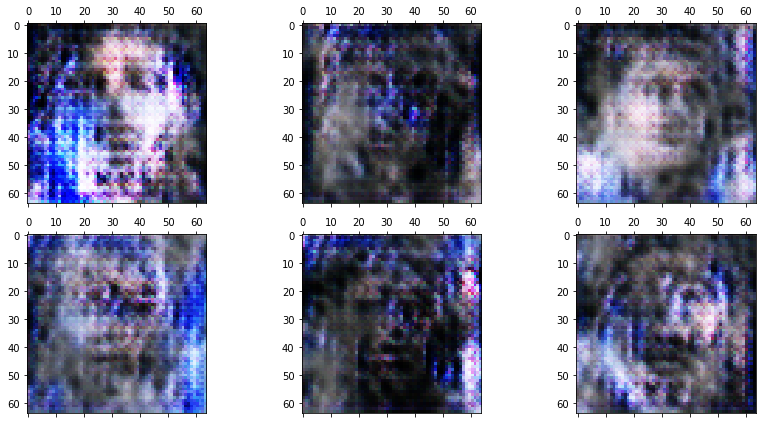

Epoch 282/1000
1/1 [==============================] - 1s 532ms/step
Epoch 283/1000
1/1 [==============================] - 1s 530ms/step
Epoch 284/1000
1/1 [==============================] - 1s 535ms/step
Epoch 285/1000
1/1 [==============================] - 1s 525ms/step
Epoch 286/1000
1/1 [==============================] - 1s 550ms/step
Epoch 287/1000
1/1 [==============================] - 1s 515ms/step
Epoch 288/1000
1/1 [==============================] - 1s 527ms/step
Epoch 289/1000
1/1 [==============================] - 1s 532ms/step
Epoch 290/1000
1/1 [==============================] - 1s 518ms/step
Epoch 291/1000
1/1 [==============================] - 1s 526ms/step
Epoch 292/1000
1/1 [==============================] - 1s 514ms/step
Epoch 293/1000
1/1 [==============================] - 1s 533ms/step
Epoch 294/1000
1/1 [==============================] - 1s 535ms/step
Epoch 295/1000
1/1 [==============================] - 1s 531ms/step
Epoch 296/1000
1/1 [============================

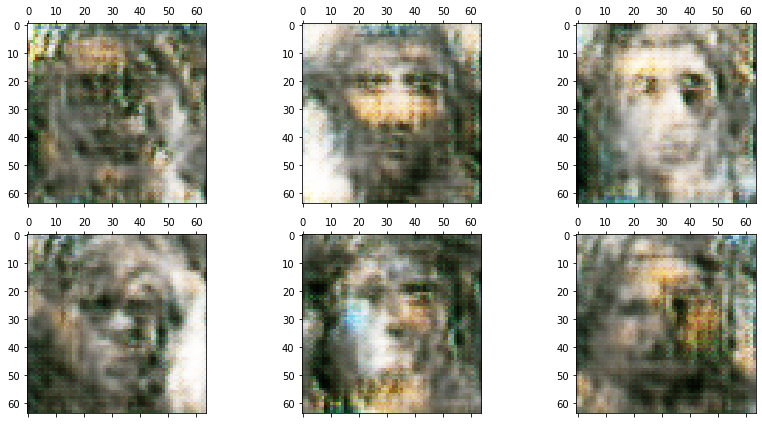

Epoch 302/1000
1/1 [==============================] - 1s 554ms/step
Epoch 303/1000
1/1 [==============================] - 1s 527ms/step
Epoch 304/1000
1/1 [==============================] - 1s 528ms/step
Epoch 305/1000
1/1 [==============================] - 1s 524ms/step
Epoch 306/1000
1/1 [==============================] - 1s 531ms/step
Epoch 307/1000
1/1 [==============================] - 1s 535ms/step
Epoch 308/1000
1/1 [==============================] - 1s 539ms/step
Epoch 309/1000
1/1 [==============================] - 1s 539ms/step
Epoch 310/1000
1/1 [==============================] - 1s 526ms/step
Epoch 311/1000
1/1 [==============================] - 1s 522ms/step
Epoch 312/1000
1/1 [==============================] - 1s 520ms/step
Epoch 313/1000
1/1 [==============================] - 1s 533ms/step
Epoch 314/1000
1/1 [==============================] - 1s 522ms/step
Epoch 315/1000
1/1 [==============================] - 1s 529ms/step
Epoch 316/1000
1/1 [============================

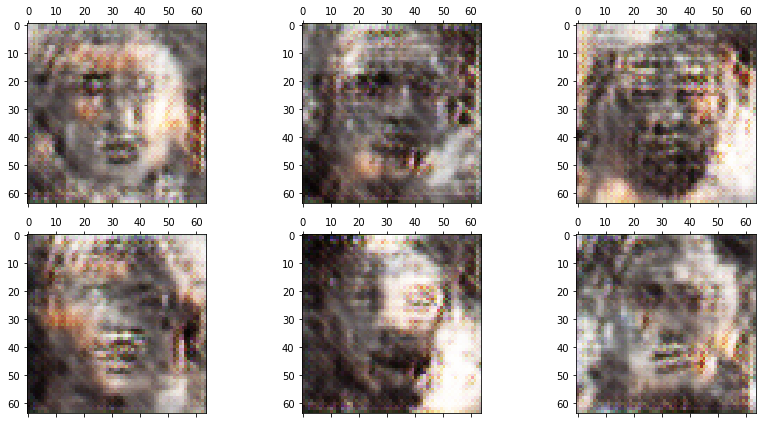

Epoch 322/1000
1/1 [==============================] - 1s 532ms/step
Epoch 323/1000
1/1 [==============================] - 1s 537ms/step
Epoch 324/1000
1/1 [==============================] - 1s 524ms/step
Epoch 325/1000
1/1 [==============================] - 1s 539ms/step
Epoch 326/1000
1/1 [==============================] - 1s 533ms/step
Epoch 327/1000
1/1 [==============================] - 1s 532ms/step
Epoch 328/1000
1/1 [==============================] - 1s 536ms/step
Epoch 329/1000
1/1 [==============================] - 1s 543ms/step
Epoch 330/1000
1/1 [==============================] - 1s 531ms/step
Epoch 331/1000
1/1 [==============================] - 1s 533ms/step
Epoch 332/1000
1/1 [==============================] - 1s 521ms/step
Epoch 333/1000
1/1 [==============================] - 1s 530ms/step
Epoch 334/1000
1/1 [==============================] - 1s 530ms/step
Epoch 335/1000
1/1 [==============================] - 1s 530ms/step
Epoch 336/1000
1/1 [============================

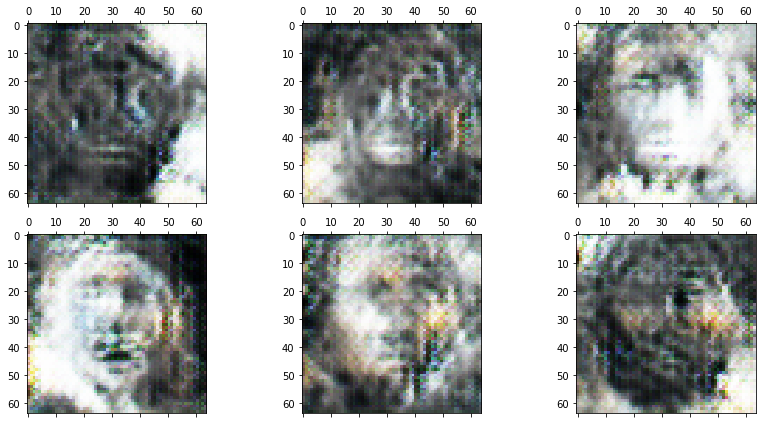

Epoch 342/1000
1/1 [==============================] - 1s 548ms/step
Epoch 343/1000
1/1 [==============================] - 1s 568ms/step
Epoch 344/1000
1/1 [==============================] - 1s 551ms/step
Epoch 345/1000
1/1 [==============================] - 1s 543ms/step
Epoch 346/1000
1/1 [==============================] - 1s 547ms/step
Epoch 347/1000
1/1 [==============================] - 1s 540ms/step
Epoch 348/1000
1/1 [==============================] - 1s 540ms/step
Epoch 349/1000
1/1 [==============================] - 1s 543ms/step
Epoch 350/1000
1/1 [==============================] - 1s 534ms/step
Epoch 351/1000
1/1 [==============================] - 1s 559ms/step
Epoch 352/1000
1/1 [==============================] - 1s 530ms/step
Epoch 353/1000
1/1 [==============================] - 1s 520ms/step
Epoch 354/1000
1/1 [==============================] - 1s 531ms/step
Epoch 355/1000
1/1 [==============================] - 1s 533ms/step
Epoch 356/1000
1/1 [============================

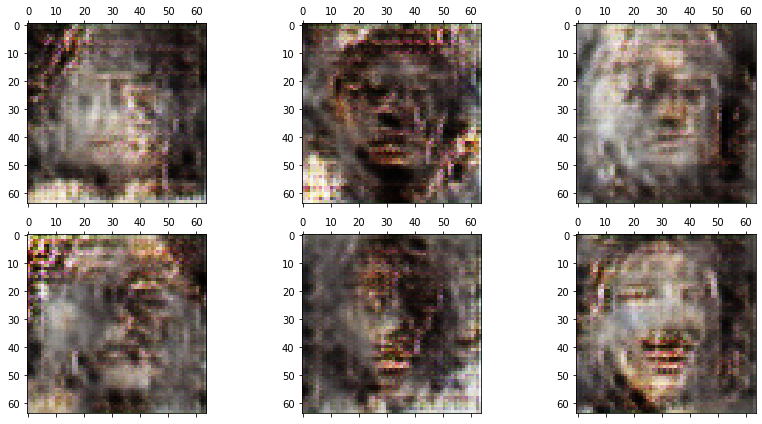

Epoch 362/1000
1/1 [==============================] - 1s 576ms/step
Epoch 363/1000
1/1 [==============================] - 1s 539ms/step
Epoch 364/1000
1/1 [==============================] - 1s 555ms/step
Epoch 365/1000
1/1 [==============================] - 1s 525ms/step
Epoch 366/1000
1/1 [==============================] - 1s 538ms/step
Epoch 367/1000
1/1 [==============================] - 1s 547ms/step
Epoch 368/1000
1/1 [==============================] - 1s 532ms/step
Epoch 369/1000
1/1 [==============================] - 1s 523ms/step
Epoch 370/1000
1/1 [==============================] - 1s 539ms/step
Epoch 371/1000
1/1 [==============================] - 1s 558ms/step
Epoch 372/1000
1/1 [==============================] - 1s 530ms/step
Epoch 373/1000
1/1 [==============================] - 1s 545ms/step
Epoch 374/1000
1/1 [==============================] - 1s 554ms/step
Epoch 375/1000
1/1 [==============================] - 1s 548ms/step
Epoch 376/1000
1/1 [============================

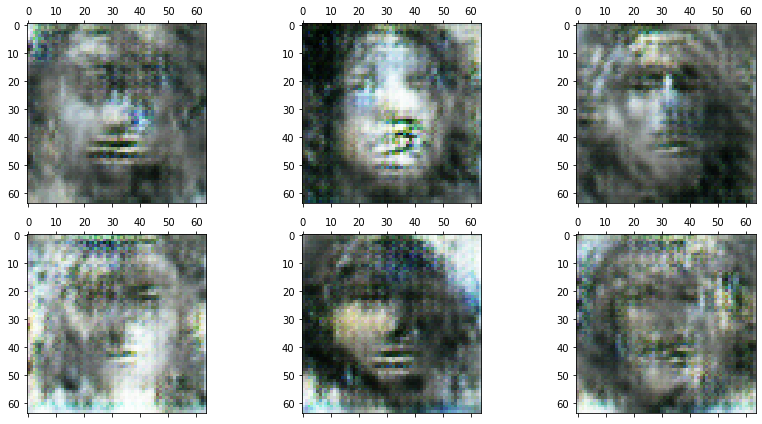

Epoch 382/1000
1/1 [==============================] - 1s 575ms/step
Epoch 383/1000
1/1 [==============================] - 1s 568ms/step
Epoch 384/1000
1/1 [==============================] - 1s 567ms/step
Epoch 385/1000
1/1 [==============================] - 1s 534ms/step
Epoch 386/1000
1/1 [==============================] - 1s 544ms/step
Epoch 387/1000
1/1 [==============================] - 1s 544ms/step
Epoch 388/1000
1/1 [==============================] - 1s 530ms/step
Epoch 389/1000
1/1 [==============================] - 1s 573ms/step
Epoch 390/1000
1/1 [==============================] - 1s 560ms/step
Epoch 391/1000
1/1 [==============================] - 1s 552ms/step
Epoch 392/1000
1/1 [==============================] - 1s 549ms/step
Epoch 393/1000
1/1 [==============================] - 1s 557ms/step
Epoch 394/1000
1/1 [==============================] - 1s 549ms/step
Epoch 395/1000
1/1 [==============================] - 1s 563ms/step
Epoch 396/1000
1/1 [============================

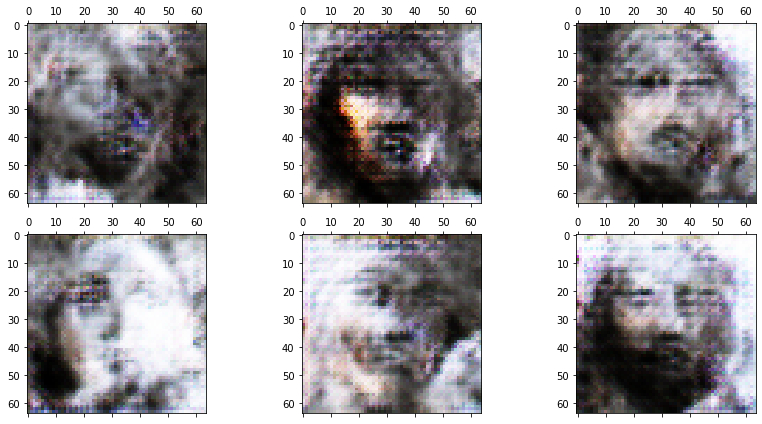

Epoch 402/1000
1/1 [==============================] - 1s 580ms/step
Epoch 403/1000
1/1 [==============================] - 1s 555ms/step
Epoch 404/1000
1/1 [==============================] - 664s 664s/step
Epoch 405/1000
1/1 [==============================] - 1s 594ms/step
Epoch 406/1000
1/1 [==============================] - 0s 469ms/step
Epoch 407/1000
1/1 [==============================] - 0s 453ms/step
Epoch 408/1000
1/1 [==============================] - 0s 457ms/step
Epoch 409/1000
1/1 [==============================] - 0s 457ms/step
Epoch 410/1000
1/1 [==============================] - 0s 461ms/step
Epoch 411/1000
1/1 [==============================] - 0s 462ms/step
Epoch 412/1000
1/1 [==============================] - 0s 456ms/step
Epoch 413/1000
1/1 [==============================] - 0s 459ms/step
Epoch 414/1000
1/1 [==============================] - 0s 460ms/step
Epoch 415/1000
1/1 [==============================] - 0s 465ms/step
Epoch 416/1000
1/1 [===========================

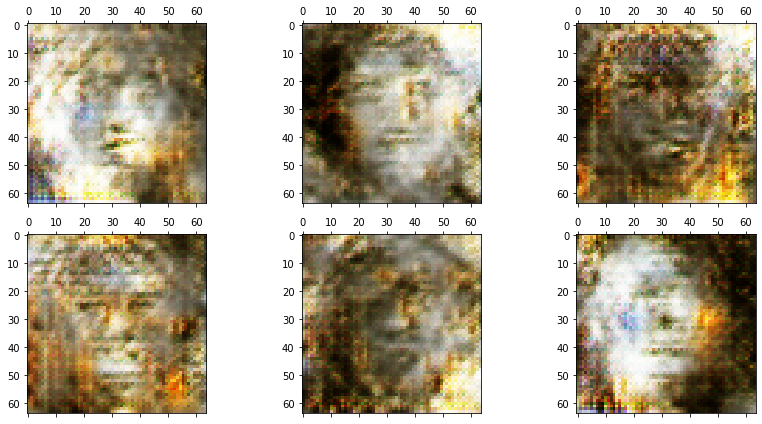

Epoch 422/1000
1/1 [==============================] - 1s 515ms/step
Epoch 423/1000
1/1 [==============================] - 0s 493ms/step
Epoch 424/1000
1/1 [==============================] - 0s 493ms/step
Epoch 425/1000
1/1 [==============================] - 0s 493ms/step
Epoch 426/1000
1/1 [==============================] - 0s 491ms/step
Epoch 427/1000
1/1 [==============================] - 0s 495ms/step
Epoch 428/1000
1/1 [==============================] - 1s 502ms/step
Epoch 429/1000
1/1 [==============================] - 1s 502ms/step
Epoch 430/1000
1/1 [==============================] - 1s 503ms/step
Epoch 431/1000
1/1 [==============================] - 1s 503ms/step
Epoch 432/1000
1/1 [==============================] - 1s 509ms/step
Epoch 433/1000
1/1 [==============================] - 1s 511ms/step
Epoch 434/1000
1/1 [==============================] - 1s 507ms/step
Epoch 435/1000
1/1 [==============================] - 1s 511ms/step
Epoch 436/1000
1/1 [============================

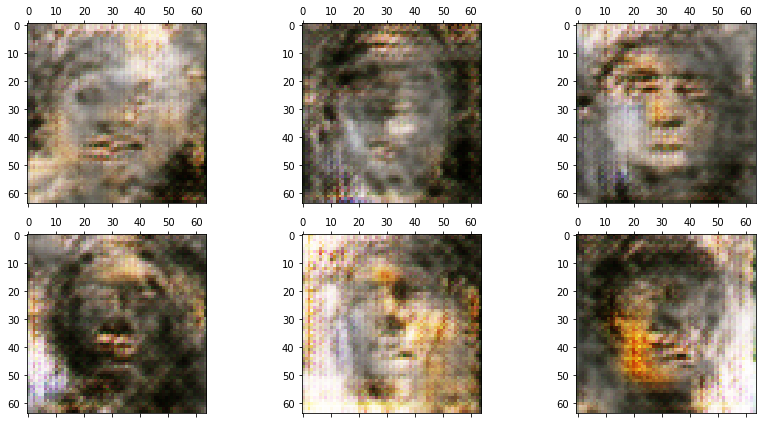

Epoch 442/1000
1/1 [==============================] - 1s 561ms/step
Epoch 443/1000
1/1 [==============================] - 1s 534ms/step
Epoch 444/1000
1/1 [==============================] - 1s 522ms/step
Epoch 445/1000
1/1 [==============================] - 1s 515ms/step
Epoch 446/1000
1/1 [==============================] - 1s 530ms/step
Epoch 447/1000
1/1 [==============================] - 1s 515ms/step
Epoch 448/1000
1/1 [==============================] - 1s 515ms/step
Epoch 449/1000
1/1 [==============================] - 1s 520ms/step
Epoch 450/1000
1/1 [==============================] - 1s 523ms/step
Epoch 451/1000
1/1 [==============================] - 1s 527ms/step
Epoch 452/1000
1/1 [==============================] - 1s 519ms/step
Epoch 453/1000
1/1 [==============================] - 1s 524ms/step
Epoch 454/1000
1/1 [==============================] - 1s 532ms/step
Epoch 455/1000
1/1 [==============================] - 1s 517ms/step
Epoch 456/1000
1/1 [============================

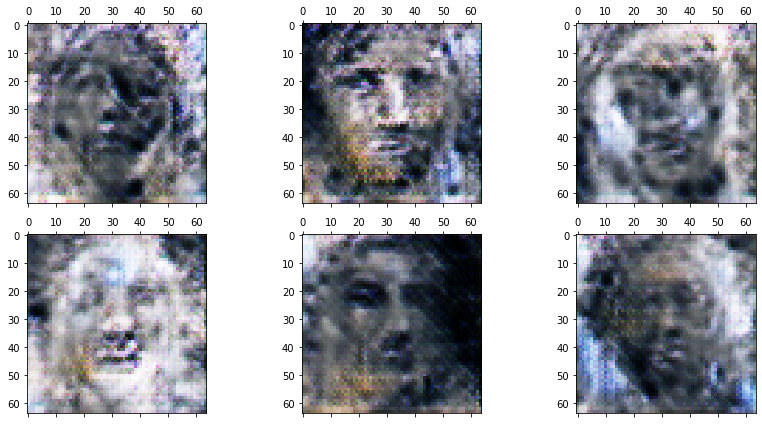

Epoch 462/1000
1/1 [==============================] - 1s 529ms/step
Epoch 463/1000
1/1 [==============================] - 1s 532ms/step
Epoch 464/1000
1/1 [==============================] - 1s 530ms/step
Epoch 465/1000
1/1 [==============================] - 1s 521ms/step
Epoch 466/1000
1/1 [==============================] - 1s 527ms/step
Epoch 467/1000
1/1 [==============================] - 1s 519ms/step
Epoch 468/1000
1/1 [==============================] - 1s 525ms/step
Epoch 469/1000
1/1 [==============================] - 1s 535ms/step
Epoch 470/1000
1/1 [==============================] - 1s 534ms/step
Epoch 471/1000
1/1 [==============================] - 1s 533ms/step
Epoch 472/1000
1/1 [==============================] - 1s 525ms/step
Epoch 473/1000
1/1 [==============================] - 1s 540ms/step
Epoch 474/1000
1/1 [==============================] - 1s 532ms/step
Epoch 475/1000
1/1 [==============================] - 1s 521ms/step
Epoch 476/1000
1/1 [============================

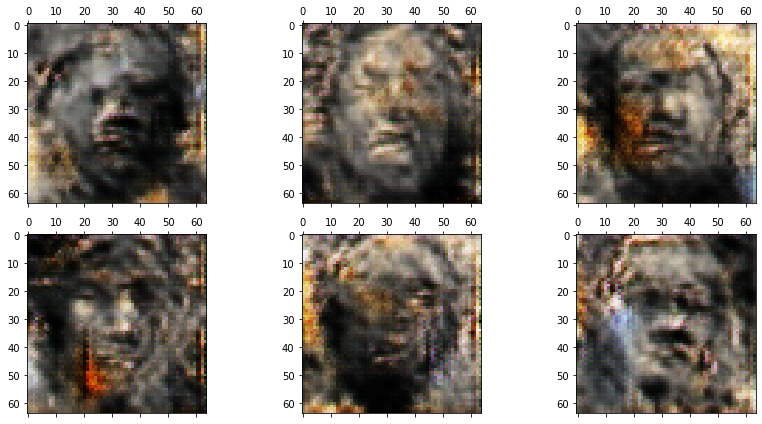

Epoch 482/1000
1/1 [==============================] - 1s 565ms/step
Epoch 483/1000
1/1 [==============================] - 1s 544ms/step
Epoch 484/1000
1/1 [==============================] - 1s 540ms/step
Epoch 485/1000
1/1 [==============================] - 1s 533ms/step
Epoch 486/1000
1/1 [==============================] - 1s 541ms/step
Epoch 487/1000
1/1 [==============================] - 1s 546ms/step
Epoch 488/1000
1/1 [==============================] - 1s 576ms/step
Epoch 489/1000
1/1 [==============================] - 1s 555ms/step
Epoch 490/1000
1/1 [==============================] - 1s 575ms/step
Epoch 491/1000
1/1 [==============================] - 1s 572ms/step
Epoch 492/1000
1/1 [==============================] - 1s 548ms/step
Epoch 493/1000
1/1 [==============================] - 1s 535ms/step
Epoch 494/1000
1/1 [==============================] - 1s 546ms/step
Epoch 495/1000
1/1 [==============================] - 1s 545ms/step
Epoch 496/1000
1/1 [============================

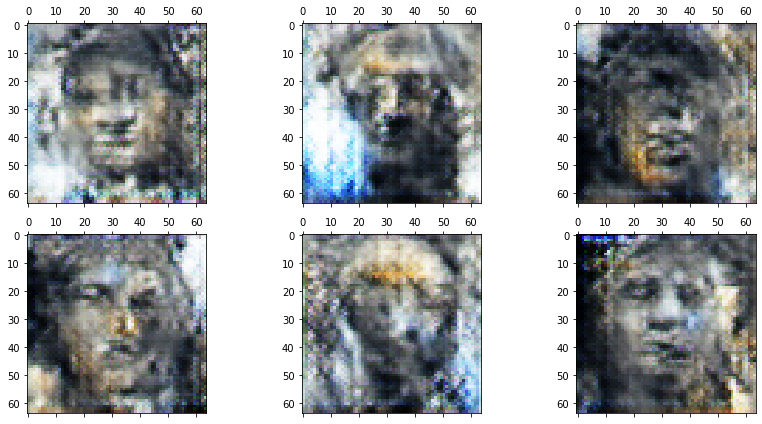

Epoch 502/1000
1/1 [==============================] - 1s 591ms/step
Epoch 503/1000
1/1 [==============================] - 1s 544ms/step
Epoch 504/1000
1/1 [==============================] - 1s 546ms/step
Epoch 505/1000
1/1 [==============================] - 1s 545ms/step
Epoch 506/1000
1/1 [==============================] - 1s 542ms/step
Epoch 507/1000
1/1 [==============================] - 1s 546ms/step
Epoch 508/1000
1/1 [==============================] - 1s 550ms/step
Epoch 509/1000
1/1 [==============================] - 1s 541ms/step
Epoch 510/1000
1/1 [==============================] - 1s 564ms/step
Epoch 511/1000
1/1 [==============================] - 1s 550ms/step
Epoch 512/1000
1/1 [==============================] - 1s 543ms/step
Epoch 513/1000
1/1 [==============================] - 1s 563ms/step
Epoch 514/1000
1/1 [==============================] - 1s 555ms/step
Epoch 515/1000
1/1 [==============================] - 1s 552ms/step
Epoch 516/1000
1/1 [============================

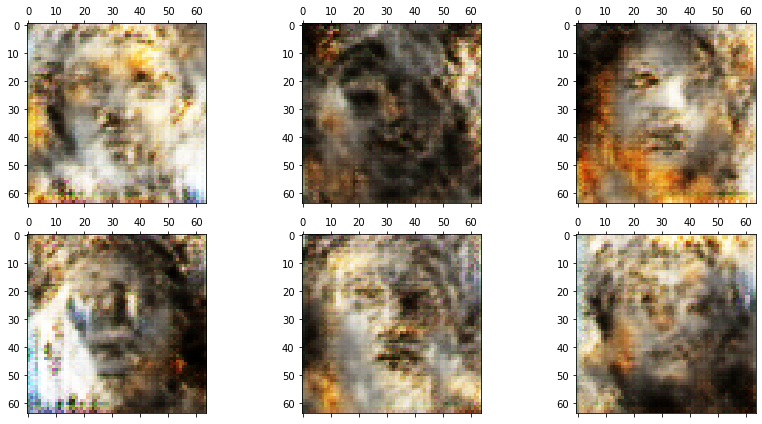

Epoch 522/1000
1/1 [==============================] - 1s 568ms/step
Epoch 523/1000
1/1 [==============================] - 1s 534ms/step
Epoch 524/1000
1/1 [==============================] - 1s 550ms/step
Epoch 525/1000
1/1 [==============================] - 1s 544ms/step
Epoch 526/1000
1/1 [==============================] - 1s 542ms/step
Epoch 527/1000
1/1 [==============================] - 1s 543ms/step
Epoch 528/1000
1/1 [==============================] - 1s 547ms/step
Epoch 529/1000
1/1 [==============================] - 1s 547ms/step
Epoch 530/1000
1/1 [==============================] - 1s 549ms/step
Epoch 531/1000
1/1 [==============================] - 1s 561ms/step
Epoch 532/1000
1/1 [==============================] - 1s 546ms/step
Epoch 533/1000
1/1 [==============================] - 1s 550ms/step
Epoch 534/1000
1/1 [==============================] - 1s 538ms/step
Epoch 535/1000
1/1 [==============================] - 1s 571ms/step
Epoch 536/1000
1/1 [============================

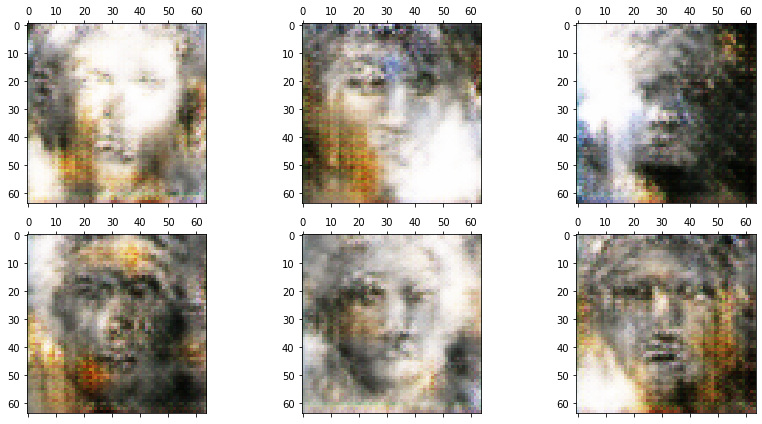

Epoch 542/1000
1/1 [==============================] - 1s 596ms/step
Epoch 543/1000
1/1 [==============================] - 1s 580ms/step
Epoch 544/1000
1/1 [==============================] - 1s 568ms/step
Epoch 545/1000
1/1 [==============================] - 1s 539ms/step
Epoch 546/1000
1/1 [==============================] - 1s 548ms/step
Epoch 547/1000
1/1 [==============================] - 1s 565ms/step
Epoch 548/1000
1/1 [==============================] - 1s 548ms/step
Epoch 549/1000
1/1 [==============================] - 1s 552ms/step
Epoch 550/1000
1/1 [==============================] - 1s 572ms/step
Epoch 551/1000
1/1 [==============================] - 1s 572ms/step
Epoch 552/1000
1/1 [==============================] - 1s 551ms/step
Epoch 553/1000
1/1 [==============================] - 1s 554ms/step
Epoch 554/1000
1/1 [==============================] - 1s 586ms/step
Epoch 555/1000
1/1 [==============================] - 1s 562ms/step
Epoch 556/1000
1/1 [============================

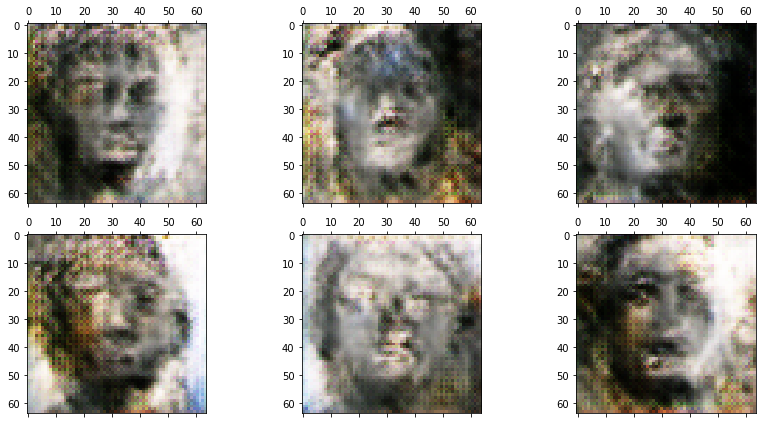

Epoch 562/1000
1/1 [==============================] - 0s 496ms/step
Epoch 563/1000
1/1 [==============================] - 0s 446ms/step
Epoch 564/1000
1/1 [==============================] - 0s 455ms/step
Epoch 565/1000
1/1 [==============================] - 0s 435ms/step
Epoch 566/1000
1/1 [==============================] - 0s 439ms/step
Epoch 567/1000
1/1 [==============================] - 0s 438ms/step
Epoch 568/1000
1/1 [==============================] - 0s 437ms/step
Epoch 569/1000
1/1 [==============================] - 0s 446ms/step
Epoch 570/1000
1/1 [==============================] - 0s 444ms/step
Epoch 571/1000
1/1 [==============================] - 0s 449ms/step
Epoch 572/1000
1/1 [==============================] - 1s 601ms/step
Epoch 573/1000
1/1 [==============================] - 0s 462ms/step
Epoch 574/1000
1/1 [==============================] - 0s 459ms/step
Epoch 575/1000
1/1 [==============================] - 0s 479ms/step
Epoch 576/1000
1/1 [============================

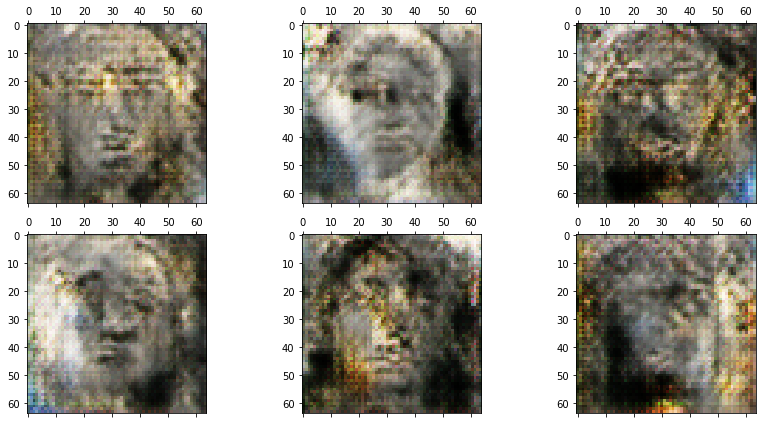

Epoch 582/1000
1/1 [==============================] - 0s 466ms/step
Epoch 583/1000
1/1 [==============================] - 0s 464ms/step
Epoch 584/1000
1/1 [==============================] - 0s 466ms/step
Epoch 585/1000
1/1 [==============================] - 0s 467ms/step
Epoch 586/1000
1/1 [==============================] - 0s 473ms/step
Epoch 587/1000
1/1 [==============================] - 0s 471ms/step
Epoch 588/1000
1/1 [==============================] - 0s 482ms/step
Epoch 589/1000
1/1 [==============================] - 0s 487ms/step
Epoch 590/1000
1/1 [==============================] - 0s 490ms/step
Epoch 591/1000
1/1 [==============================] - 0s 486ms/step
Epoch 592/1000
1/1 [==============================] - 0s 487ms/step
Epoch 593/1000
1/1 [==============================] - 0s 497ms/step
Epoch 594/1000
1/1 [==============================] - 0s 495ms/step
Epoch 595/1000
1/1 [==============================] - 1s 501ms/step
Epoch 596/1000
1/1 [============================

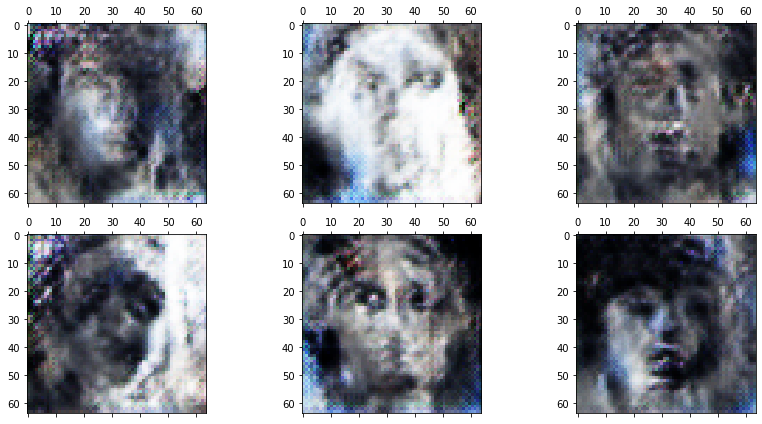

Epoch 602/1000
1/1 [==============================] - 1s 543ms/step
Epoch 603/1000
1/1 [==============================] - 1s 516ms/step
Epoch 604/1000
1/1 [==============================] - 1s 512ms/step
Epoch 605/1000
1/1 [==============================] - 1s 509ms/step
Epoch 606/1000
1/1 [==============================] - 1s 559ms/step
Epoch 607/1000
1/1 [==============================] - 1s 510ms/step
Epoch 608/1000
1/1 [==============================] - 1s 520ms/step
Epoch 609/1000
1/1 [==============================] - 1s 516ms/step
Epoch 610/1000
1/1 [==============================] - 1s 513ms/step
Epoch 611/1000
1/1 [==============================] - 1s 511ms/step
Epoch 612/1000
1/1 [==============================] - 1s 514ms/step
Epoch 613/1000
1/1 [==============================] - 1s 512ms/step
Epoch 614/1000
1/1 [==============================] - 1s 513ms/step
Epoch 615/1000
1/1 [==============================] - 1s 517ms/step
Epoch 616/1000
1/1 [============================

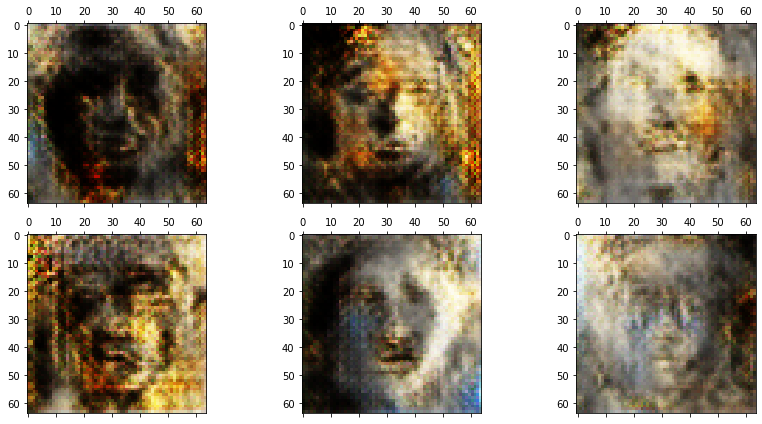

Epoch 622/1000
1/1 [==============================] - 1s 550ms/step
Epoch 623/1000
1/1 [==============================] - 1s 524ms/step
Epoch 624/1000
1/1 [==============================] - 1s 529ms/step
Epoch 625/1000
1/1 [==============================] - 1s 515ms/step
Epoch 626/1000
1/1 [==============================] - 1s 520ms/step
Epoch 627/1000
1/1 [==============================] - 1s 519ms/step
Epoch 628/1000
1/1 [==============================] - 1s 520ms/step
Epoch 629/1000
1/1 [==============================] - 1s 529ms/step
Epoch 630/1000
1/1 [==============================] - 1s 529ms/step
Epoch 631/1000
1/1 [==============================] - 1s 534ms/step
Epoch 632/1000
1/1 [==============================] - 1s 523ms/step
Epoch 633/1000
1/1 [==============================] - 1s 511ms/step
Epoch 634/1000
1/1 [==============================] - 1s 536ms/step
Epoch 635/1000
1/1 [==============================] - 1s 534ms/step
Epoch 636/1000
1/1 [============================

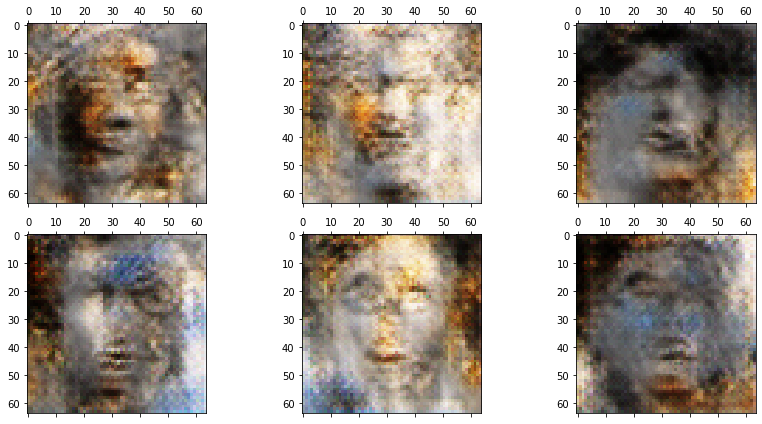

Epoch 642/1000
1/1 [==============================] - 0s 487ms/step
Epoch 643/1000
1/1 [==============================] - 0s 457ms/step
Epoch 644/1000
1/1 [==============================] - 0s 455ms/step
Epoch 645/1000
1/1 [==============================] - 0s 442ms/step
Epoch 646/1000
1/1 [==============================] - 0s 446ms/step
Epoch 647/1000
1/1 [==============================] - 0s 438ms/step
Epoch 648/1000
1/1 [==============================] - 0s 439ms/step
Epoch 649/1000
1/1 [==============================] - 0s 436ms/step
Epoch 650/1000
1/1 [==============================] - 0s 439ms/step
Epoch 651/1000
1/1 [==============================] - 0s 441ms/step
Epoch 652/1000
1/1 [==============================] - 0s 437ms/step
Epoch 653/1000
1/1 [==============================] - 0s 446ms/step
Epoch 654/1000
1/1 [==============================] - 0s 441ms/step
Epoch 655/1000
1/1 [==============================] - 0s 437ms/step
Epoch 656/1000
1/1 [============================

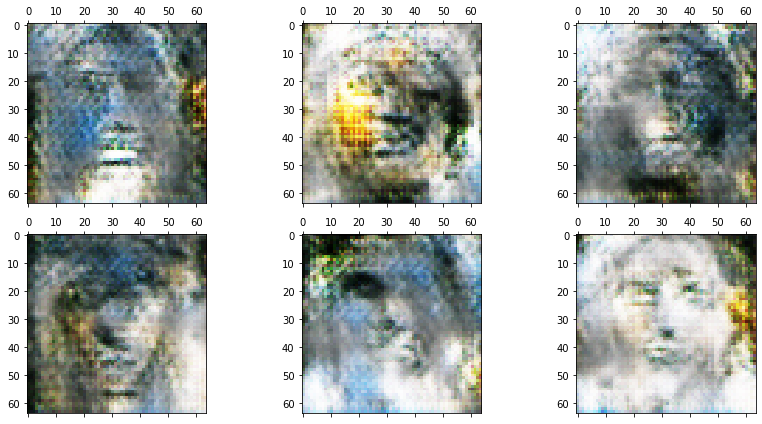

Epoch 662/1000
1/1 [==============================] - 0s 491ms/step
Epoch 663/1000
1/1 [==============================] - 0s 466ms/step
Epoch 664/1000
1/1 [==============================] - 0s 471ms/step
Epoch 665/1000
1/1 [==============================] - 0s 463ms/step
Epoch 666/1000
1/1 [==============================] - 0s 468ms/step
Epoch 667/1000
1/1 [==============================] - 0s 461ms/step
Epoch 668/1000
1/1 [==============================] - 0s 469ms/step
Epoch 669/1000
1/1 [==============================] - 0s 475ms/step
Epoch 670/1000
1/1 [==============================] - 0s 471ms/step
Epoch 671/1000
1/1 [==============================] - 0s 470ms/step
Epoch 672/1000
1/1 [==============================] - 0s 475ms/step
Epoch 673/1000
1/1 [==============================] - 0s 477ms/step
Epoch 674/1000
1/1 [==============================] - 0s 479ms/step
Epoch 675/1000
1/1 [==============================] - 0s 482ms/step
Epoch 676/1000
1/1 [============================

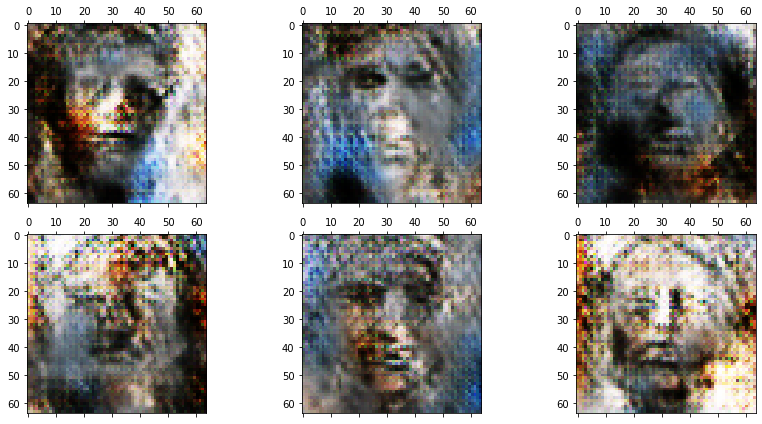

Epoch 682/1000
1/1 [==============================] - 1s 536ms/step
Epoch 683/1000
1/1 [==============================] - 0s 453ms/step
Epoch 684/1000
1/1 [==============================] - 0s 443ms/step
Epoch 685/1000
1/1 [==============================] - 0s 439ms/step
Epoch 686/1000
1/1 [==============================] - 0s 439ms/step
Epoch 687/1000
1/1 [==============================] - 0s 454ms/step
Epoch 688/1000
1/1 [==============================] - 0s 442ms/step
Epoch 689/1000
1/1 [==============================] - 0s 456ms/step
Epoch 690/1000
1/1 [==============================] - 0s 450ms/step
Epoch 691/1000
1/1 [==============================] - 0s 456ms/step
Epoch 692/1000
1/1 [==============================] - 0s 457ms/step
Epoch 693/1000
1/1 [==============================] - 0s 465ms/step
Epoch 694/1000
1/1 [==============================] - 0s 465ms/step
Epoch 695/1000
1/1 [==============================] - 0s 477ms/step
Epoch 696/1000
1/1 [============================

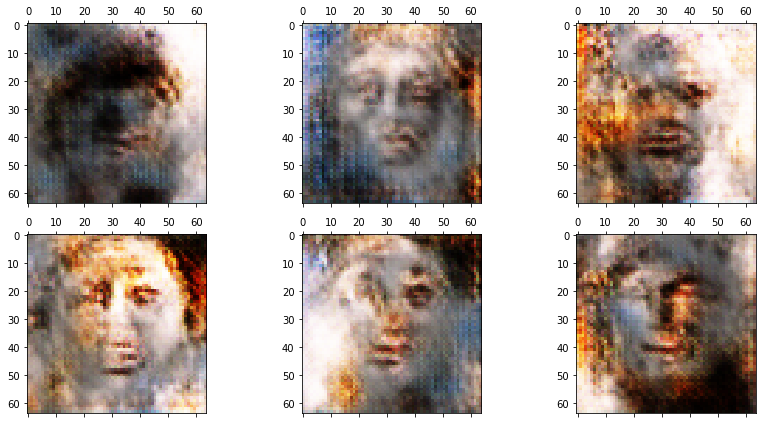

Epoch 702/1000
1/1 [==============================] - 1s 518ms/step
Epoch 703/1000
1/1 [==============================] - 0s 487ms/step
Epoch 704/1000
1/1 [==============================] - 0s 486ms/step
Epoch 705/1000
1/1 [==============================] - 0s 486ms/step
Epoch 706/1000
1/1 [==============================] - 0s 486ms/step
Epoch 707/1000
1/1 [==============================] - 0s 482ms/step
Epoch 708/1000
1/1 [==============================] - 0s 489ms/step
Epoch 709/1000
1/1 [==============================] - 377s 377s/step
Epoch 710/1000
1/1 [==============================] - 1s 515ms/step
Epoch 711/1000
1/1 [==============================] - 0s 458ms/step
Epoch 712/1000
1/1 [==============================] - 0s 464ms/step
Epoch 713/1000
1/1 [==============================] - 0s 452ms/step
Epoch 714/1000
1/1 [==============================] - 0s 461ms/step
Epoch 715/1000
1/1 [==============================] - 0s 465ms/step
Epoch 716/1000
1/1 [===========================

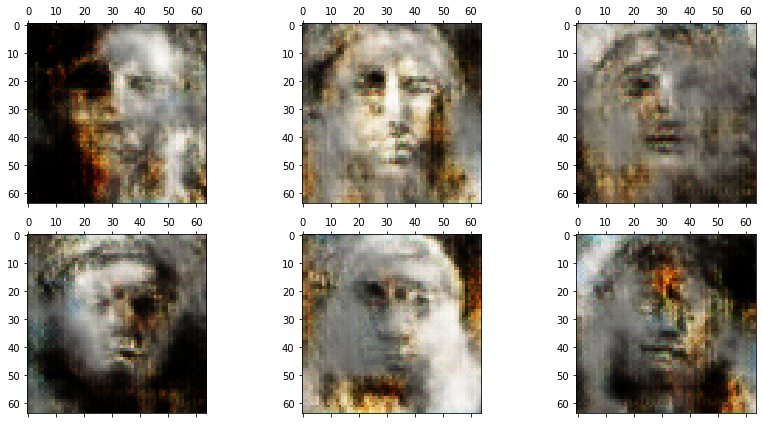

Epoch 722/1000
1/1 [==============================] - 1s 537ms/step
Epoch 723/1000
1/1 [==============================] - 0s 480ms/step
Epoch 724/1000
1/1 [==============================] - 0s 483ms/step
Epoch 725/1000
1/1 [==============================] - 1s 531ms/step
Epoch 726/1000
1/1 [==============================] - 1s 554ms/step
Epoch 727/1000
1/1 [==============================] - 1s 537ms/step
Epoch 728/1000
1/1 [==============================] - 1s 626ms/step
Epoch 729/1000
1/1 [==============================] - 1s 540ms/step
Epoch 730/1000
1/1 [==============================] - 1s 522ms/step
Epoch 731/1000
1/1 [==============================] - 1s 527ms/step
Epoch 732/1000
1/1 [==============================] - 1s 503ms/step
Epoch 733/1000
1/1 [==============================] - 1s 543ms/step
Epoch 734/1000
1/1 [==============================] - 1s 524ms/step
Epoch 735/1000
1/1 [==============================] - 1s 551ms/step
Epoch 736/1000
1/1 [============================

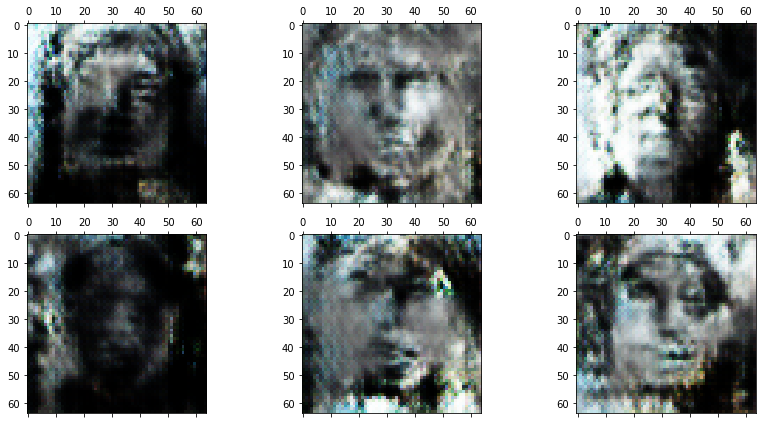

Epoch 742/1000
1/1 [==============================] - 1s 539ms/step
Epoch 743/1000
1/1 [==============================] - 1s 508ms/step
Epoch 744/1000
1/1 [==============================] - 1s 584ms/step
Epoch 745/1000
1/1 [==============================] - 1s 524ms/step
Epoch 746/1000
1/1 [==============================] - 1s 536ms/step
Epoch 747/1000
1/1 [==============================] - 1s 558ms/step
Epoch 748/1000
1/1 [==============================] - 1s 532ms/step
Epoch 749/1000
1/1 [==============================] - 1s 530ms/step
Epoch 750/1000
1/1 [==============================] - 1s 526ms/step
Epoch 751/1000
1/1 [==============================] - 1s 529ms/step
Epoch 752/1000
1/1 [==============================] - 1s 522ms/step
Epoch 753/1000
1/1 [==============================] - 1s 535ms/step
Epoch 754/1000
1/1 [==============================] - 1s 527ms/step
Epoch 755/1000
1/1 [==============================] - 1s 516ms/step
Epoch 756/1000
1/1 [============================

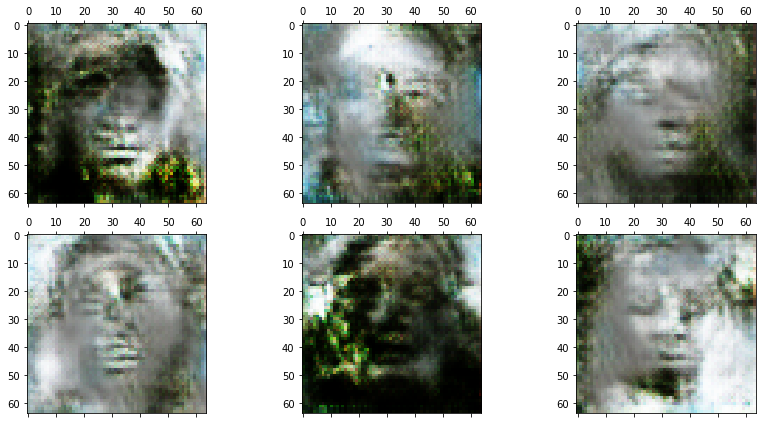

Epoch 762/1000
1/1 [==============================] - 1s 532ms/step
Epoch 763/1000
1/1 [==============================] - 1s 534ms/step
Epoch 764/1000
1/1 [==============================] - 1s 531ms/step
Epoch 765/1000
1/1 [==============================] - 1s 527ms/step
Epoch 766/1000
1/1 [==============================] - 1s 536ms/step
Epoch 767/1000
1/1 [==============================] - 1s 537ms/step
Epoch 768/1000
1/1 [==============================] - 1s 539ms/step
Epoch 769/1000
1/1 [==============================] - 1s 537ms/step
Epoch 770/1000
1/1 [==============================] - 1s 544ms/step
Epoch 771/1000
1/1 [==============================] - 1s 534ms/step
Epoch 772/1000
1/1 [==============================] - 1s 539ms/step
Epoch 773/1000
1/1 [==============================] - 1s 518ms/step
Epoch 774/1000
1/1 [==============================] - 1s 538ms/step
Epoch 775/1000
1/1 [==============================] - 1s 536ms/step
Epoch 776/1000
1/1 [============================

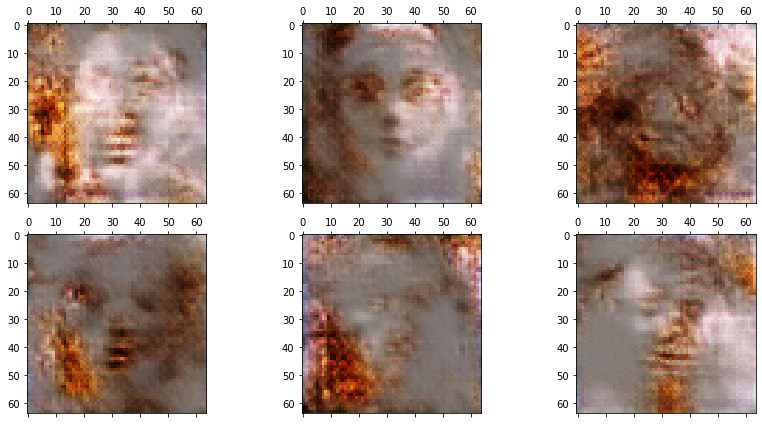

Epoch 782/1000
1/1 [==============================] - 1s 589ms/step
Epoch 783/1000
1/1 [==============================] - 1s 532ms/step
Epoch 784/1000
1/1 [==============================] - 0s 468ms/step
Epoch 785/1000
1/1 [==============================] - 0s 452ms/step
Epoch 786/1000
1/1 [==============================] - 0s 474ms/step
Epoch 787/1000
1/1 [==============================] - 331s 331s/step
Epoch 788/1000
1/1 [==============================] - 1s 508ms/step
Epoch 789/1000
1/1 [==============================] - 0s 496ms/step
Epoch 790/1000
1/1 [==============================] - 0s 448ms/step
Epoch 791/1000
1/1 [==============================] - 1s 512ms/step
Epoch 792/1000
1/1 [==============================] - 0s 494ms/step
Epoch 793/1000
1/1 [==============================] - 0s 458ms/step
Epoch 794/1000
1/1 [==============================] - 0s 475ms/step
Epoch 795/1000
1/1 [==============================] - 0s 484ms/step
Epoch 796/1000
1/1 [===========================

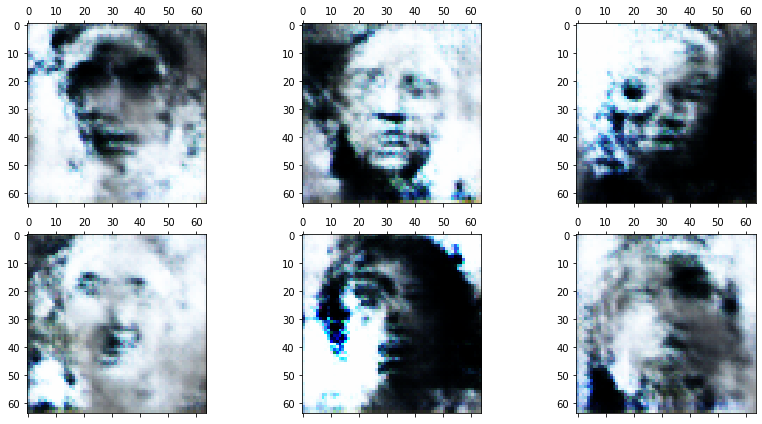

Epoch 802/1000
1/1 [==============================] - 1s 566ms/step
Epoch 803/1000
1/1 [==============================] - 0s 480ms/step
Epoch 804/1000
1/1 [==============================] - 0s 478ms/step
Epoch 805/1000
1/1 [==============================] - 0s 486ms/step
Epoch 806/1000
1/1 [==============================] - 0s 474ms/step
Epoch 807/1000
1/1 [==============================] - 0s 488ms/step
Epoch 808/1000
1/1 [==============================] - 0s 490ms/step
Epoch 809/1000
1/1 [==============================] - 0s 489ms/step
Epoch 810/1000
1/1 [==============================] - 1s 502ms/step
Epoch 811/1000
1/1 [==============================] - 1s 504ms/step
Epoch 812/1000
1/1 [==============================] - 1s 502ms/step
Epoch 813/1000
1/1 [==============================] - 0s 500ms/step
Epoch 814/1000
1/1 [==============================] - 1s 504ms/step
Epoch 815/1000
1/1 [==============================] - 1s 508ms/step
Epoch 816/1000
1/1 [============================

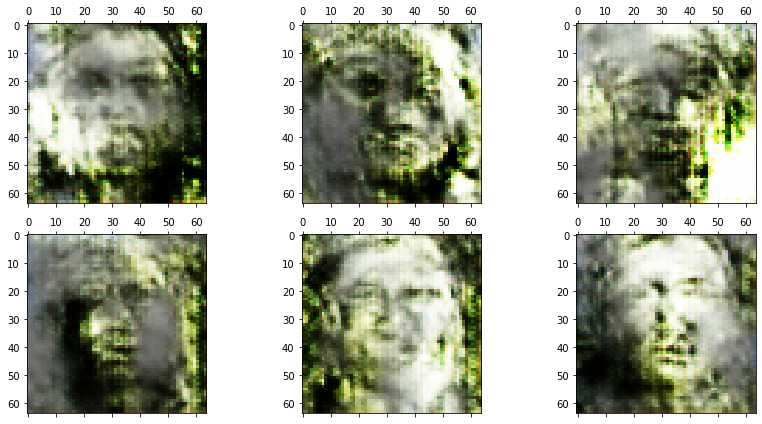

Epoch 822/1000
1/1 [==============================] - 1s 565ms/step
Epoch 823/1000
1/1 [==============================] - 1s 516ms/step
Epoch 824/1000
1/1 [==============================] - 1s 512ms/step
Epoch 825/1000
1/1 [==============================] - 1s 515ms/step
Epoch 826/1000
1/1 [==============================] - 1s 522ms/step
Epoch 827/1000
1/1 [==============================] - 1s 517ms/step
Epoch 828/1000
1/1 [==============================] - 1s 526ms/step
Epoch 829/1000
1/1 [==============================] - 1s 511ms/step
Epoch 830/1000
1/1 [==============================] - 1s 525ms/step
Epoch 831/1000
1/1 [==============================] - 1s 521ms/step
Epoch 832/1000
1/1 [==============================] - 1s 522ms/step
Epoch 833/1000
1/1 [==============================] - 1s 517ms/step
Epoch 834/1000
1/1 [==============================] - 1s 523ms/step
Epoch 835/1000
1/1 [==============================] - 1s 516ms/step
Epoch 836/1000
1/1 [============================

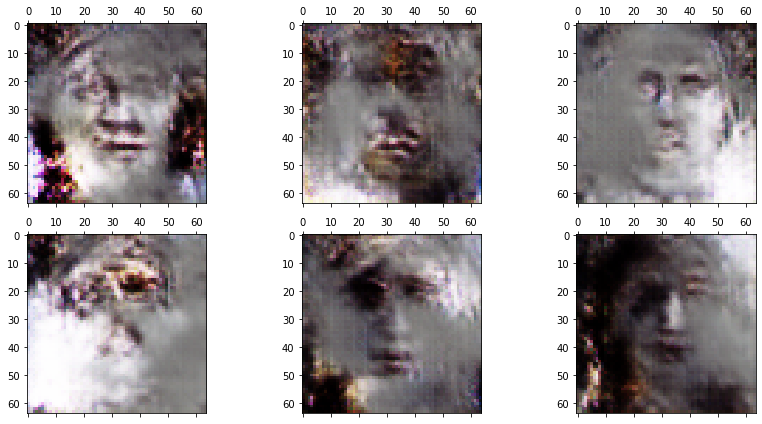

Epoch 842/1000
1/1 [==============================] - 0s 483ms/step
Epoch 843/1000
1/1 [==============================] - 0s 439ms/step
Epoch 844/1000
1/1 [==============================] - 0s 437ms/step
Epoch 845/1000
1/1 [==============================] - 0s 470ms/step
Epoch 846/1000
1/1 [==============================] - 0s 472ms/step
Epoch 847/1000
1/1 [==============================] - 0s 441ms/step
Epoch 848/1000
1/1 [==============================] - 0s 447ms/step
Epoch 849/1000
1/1 [==============================] - 0s 455ms/step
Epoch 850/1000
1/1 [==============================] - 0s 441ms/step
Epoch 851/1000
1/1 [==============================] - 0s 440ms/step
Epoch 852/1000
1/1 [==============================] - 0s 444ms/step
Epoch 853/1000
1/1 [==============================] - 0s 453ms/step
Epoch 854/1000
1/1 [==============================] - 0s 440ms/step
Epoch 855/1000
1/1 [==============================] - 0s 440ms/step
Epoch 856/1000
1/1 [============================

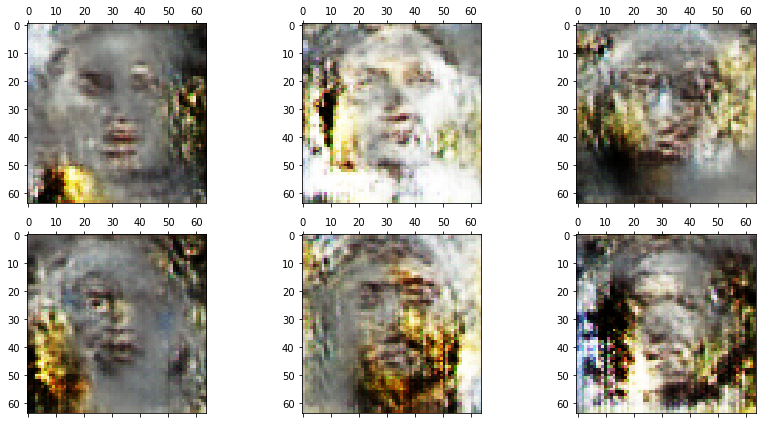

Epoch 862/1000
1/1 [==============================] - 1s 522ms/step
Epoch 863/1000
1/1 [==============================] - 0s 457ms/step
Epoch 864/1000
1/1 [==============================] - 0s 468ms/step
Epoch 865/1000
1/1 [==============================] - 0s 462ms/step
Epoch 866/1000
1/1 [==============================] - 0s 457ms/step
Epoch 867/1000
1/1 [==============================] - 0s 470ms/step
Epoch 868/1000
1/1 [==============================] - 0s 455ms/step
Epoch 869/1000
1/1 [==============================] - 0s 463ms/step
Epoch 870/1000
1/1 [==============================] - 0s 462ms/step
Epoch 871/1000
1/1 [==============================] - 1s 510ms/step
Epoch 872/1000
1/1 [==============================] - 0s 477ms/step
Epoch 873/1000
1/1 [==============================] - 0s 475ms/step
Epoch 874/1000
1/1 [==============================] - 0s 481ms/step
Epoch 875/1000
1/1 [==============================] - 0s 480ms/step
Epoch 876/1000
1/1 [============================

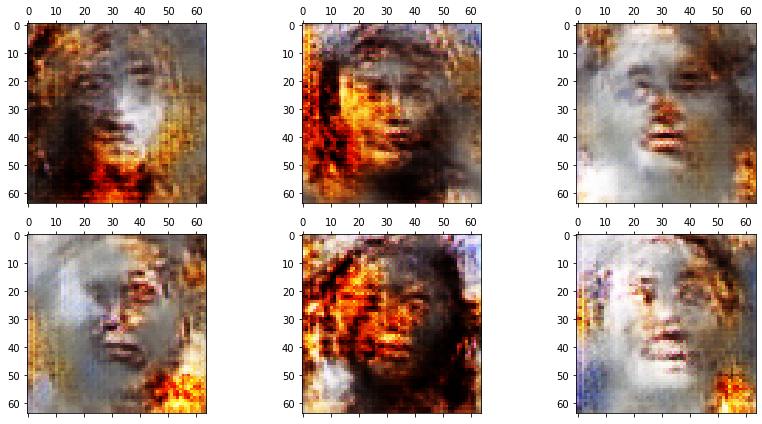

Epoch 882/1000
1/1 [==============================] - 1s 575ms/step
Epoch 883/1000
1/1 [==============================] - 1s 505ms/step
Epoch 884/1000
1/1 [==============================] - 1s 503ms/step
Epoch 885/1000
1/1 [==============================] - 1s 515ms/step
Epoch 886/1000
1/1 [==============================] - 1s 503ms/step
Epoch 887/1000
1/1 [==============================] - 1s 503ms/step
Epoch 888/1000
1/1 [==============================] - 0s 500ms/step
Epoch 889/1000
1/1 [==============================] - 1s 508ms/step
Epoch 890/1000
1/1 [==============================] - 1s 509ms/step
Epoch 891/1000
1/1 [==============================] - 1s 512ms/step
Epoch 892/1000
1/1 [==============================] - 1s 521ms/step
Epoch 893/1000
1/1 [==============================] - 1s 516ms/step
Epoch 894/1000
1/1 [==============================] - 1s 504ms/step
Epoch 895/1000
1/1 [==============================] - 1s 525ms/step
Epoch 896/1000
1/1 [============================

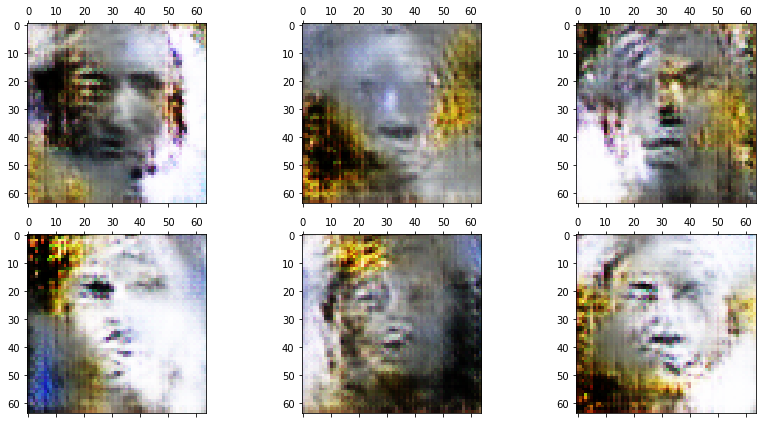

Epoch 902/1000
1/1 [==============================] - 1s 599ms/step
Epoch 903/1000
1/1 [==============================] - 1s 532ms/step
Epoch 904/1000
1/1 [==============================] - 1s 510ms/step
Epoch 905/1000
1/1 [==============================] - 1s 516ms/step
Epoch 906/1000
1/1 [==============================] - 1s 522ms/step
Epoch 907/1000
1/1 [==============================] - 1s 522ms/step
Epoch 908/1000
1/1 [==============================] - 1s 515ms/step
Epoch 909/1000
1/1 [==============================] - 1s 522ms/step
Epoch 910/1000
1/1 [==============================] - 1s 515ms/step
Epoch 911/1000
1/1 [==============================] - 1s 528ms/step
Epoch 912/1000
1/1 [==============================] - 1s 522ms/step
Epoch 913/1000
1/1 [==============================] - 1s 518ms/step
Epoch 914/1000
1/1 [==============================] - 1s 523ms/step
Epoch 915/1000
1/1 [==============================] - 1s 532ms/step
Epoch 916/1000
1/1 [============================

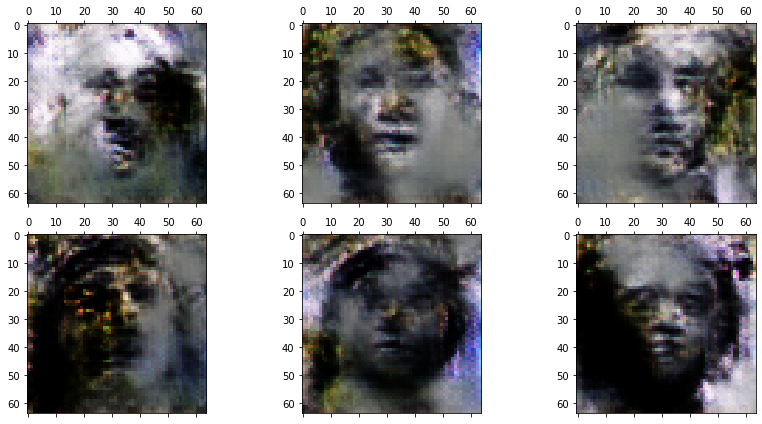

Epoch 922/1000
1/1 [==============================] - 1s 551ms/step
Epoch 923/1000
1/1 [==============================] - 0s 462ms/step
Epoch 924/1000
1/1 [==============================] - 0s 492ms/step
Epoch 925/1000
1/1 [==============================] - 0s 450ms/step
Epoch 926/1000
1/1 [==============================] - 0s 497ms/step
Epoch 927/1000
1/1 [==============================] - 0s 476ms/step
Epoch 928/1000
1/1 [==============================] - 0s 489ms/step
Epoch 929/1000
1/1 [==============================] - 0s 470ms/step
Epoch 930/1000
1/1 [==============================] - 1s 547ms/step
Epoch 931/1000
1/1 [==============================] - 0s 497ms/step
Epoch 932/1000
1/1 [==============================] - 1s 520ms/step
Epoch 933/1000
1/1 [==============================] - 0s 484ms/step
Epoch 934/1000
1/1 [==============================] - 1s 503ms/step
Epoch 935/1000
1/1 [==============================] - 0s 480ms/step
Epoch 936/1000
1/1 [============================

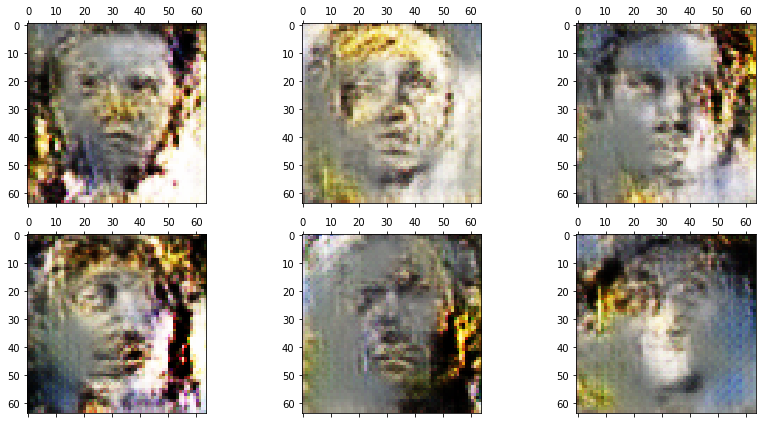

Epoch 942/1000
1/1 [==============================] - 1s 510ms/step
Epoch 943/1000
1/1 [==============================] - 1s 512ms/step
Epoch 944/1000
1/1 [==============================] - 0s 494ms/step
Epoch 945/1000
1/1 [==============================] - 1s 525ms/step
Epoch 946/1000
1/1 [==============================] - 1s 509ms/step
Epoch 947/1000
1/1 [==============================] - 1s 515ms/step
Epoch 948/1000
1/1 [==============================] - 1s 530ms/step
Epoch 949/1000
1/1 [==============================] - 1s 537ms/step
Epoch 950/1000
1/1 [==============================] - 1s 604ms/step
Epoch 951/1000
1/1 [==============================] - 1s 522ms/step
Epoch 952/1000
1/1 [==============================] - 1s 603ms/step
Epoch 953/1000
1/1 [==============================] - 1s 606ms/step
Epoch 954/1000
1/1 [==============================] - 1s 605ms/step
Epoch 955/1000
1/1 [==============================] - 1s 576ms/step
Epoch 956/1000
1/1 [============================

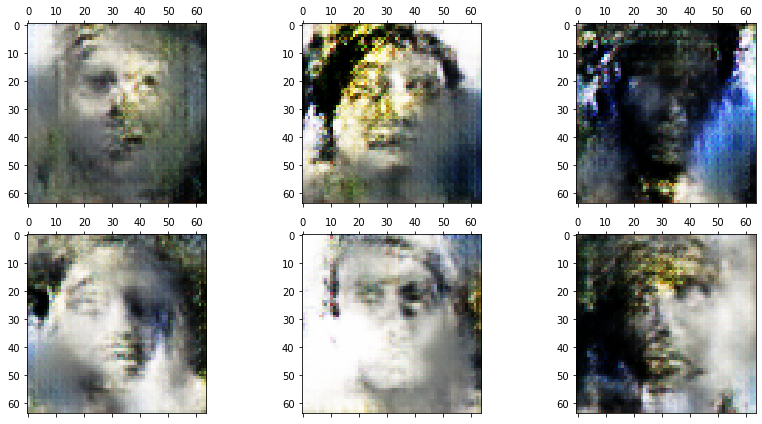

Epoch 962/1000
1/1 [==============================] - 1s 570ms/step
Epoch 963/1000
1/1 [==============================] - 0s 498ms/step
Epoch 964/1000
1/1 [==============================] - 1s 709ms/step
Epoch 965/1000
1/1 [==============================] - 1s 623ms/step
Epoch 966/1000
1/1 [==============================] - 1s 774ms/step
Epoch 967/1000
1/1 [==============================] - 1s 623ms/step
Epoch 968/1000
1/1 [==============================] - 1s 627ms/step
Epoch 969/1000
1/1 [==============================] - 1s 586ms/step
Epoch 970/1000
1/1 [==============================] - 1s 559ms/step
Epoch 971/1000
1/1 [==============================] - 1s 552ms/step
Epoch 972/1000
1/1 [==============================] - 1s 576ms/step
Epoch 973/1000
1/1 [==============================] - 1s 568ms/step
Epoch 974/1000
1/1 [==============================] - 1s 538ms/step
Epoch 975/1000
1/1 [==============================] - 1s 574ms/step
Epoch 976/1000
1/1 [============================

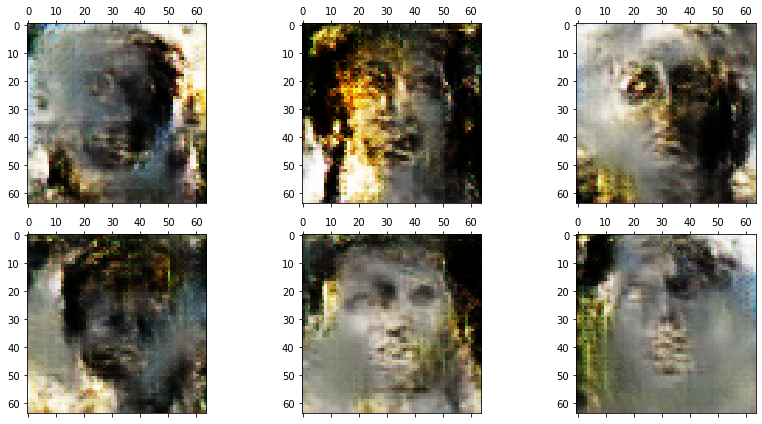

Epoch 982/1000
1/1 [==============================] - 1s 687ms/step
Epoch 983/1000
1/1 [==============================] - 1s 596ms/step
Epoch 984/1000
1/1 [==============================] - 1s 602ms/step
Epoch 985/1000
1/1 [==============================] - 1s 613ms/step
Epoch 986/1000
1/1 [==============================] - 1s 594ms/step
Epoch 987/1000
1/1 [==============================] - 1s 575ms/step
Epoch 988/1000
1/1 [==============================] - 1s 604ms/step
Epoch 989/1000
1/1 [==============================] - 1s 583ms/step
Epoch 990/1000
1/1 [==============================] - 1s 591ms/step
Epoch 991/1000
1/1 [==============================] - 1s 588ms/step
Epoch 992/1000
1/1 [==============================] - 1s 582ms/step
Epoch 993/1000
1/1 [==============================] - 1s 584ms/step
Epoch 994/1000
1/1 [==============================] - 1s 647ms/step
Epoch 995/1000
1/1 [==============================] - 1s 575ms/step
Epoch 996/1000
1/1 [============================

In [65]:

train(gen_model, dis_model, gan_model, data, latent_dim, n_eval=20, n_epochs=1000)